In [1]:
import sys
#import scvi
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import os
import anndata as ad
import ktplotspy as kpy
import matplotlib.pyplot as plt

sc.set_figure_params(figsize=(4, 4))
#if branch is stable, will install via pypi, else will install from source
branch = "stable"
IN_COLAB = "google.colab" in sys.modules

if IN_COLAB and branch == "stable":
    !pip install --quiet scvi-tools[tutorials]
elif IN_COLAB and branch != "stable":
    !pip install --quiet --upgrade jsonschema
    !pip install --quiet git+https://github.com/yoseflab/scvi-tools@$branch#egg=scvi-tools[tutorials]

/home/chenx6/anaconda3/lib/python3.10/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


# Human Tumors/Pan Cancer

In [3]:
adata = sc.read_h5ad('/common/sheny2/scRNAseq_datasets/scRNAseq_pancan_counts_8+1_normalized_after_scanvi_clinic_corr.h5ad')
adata

AnnData object with n_obs × n_vars = 1030968 × 14090
    obs: 'SampleID', 'DataID', 'Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type', 'DataSampleID', 'celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', '_scvi_batch', '_scvi_labels', 'Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA', 'RL_Prediction_Only9genes', 'LOY'
    var: 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Cancertype_TCGA_colors', 'Cancertype_colors', 'Celltype1_colors', 'Celltype2_colors', 'Celltype3_colors', 'DataID_colors', 'Organ_colors', 'Sex_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltype_colors', 'hvg', 'neighbors', 'rank_genes_groups', 'umap'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'
    obsp: 'connectivities', 'distances'

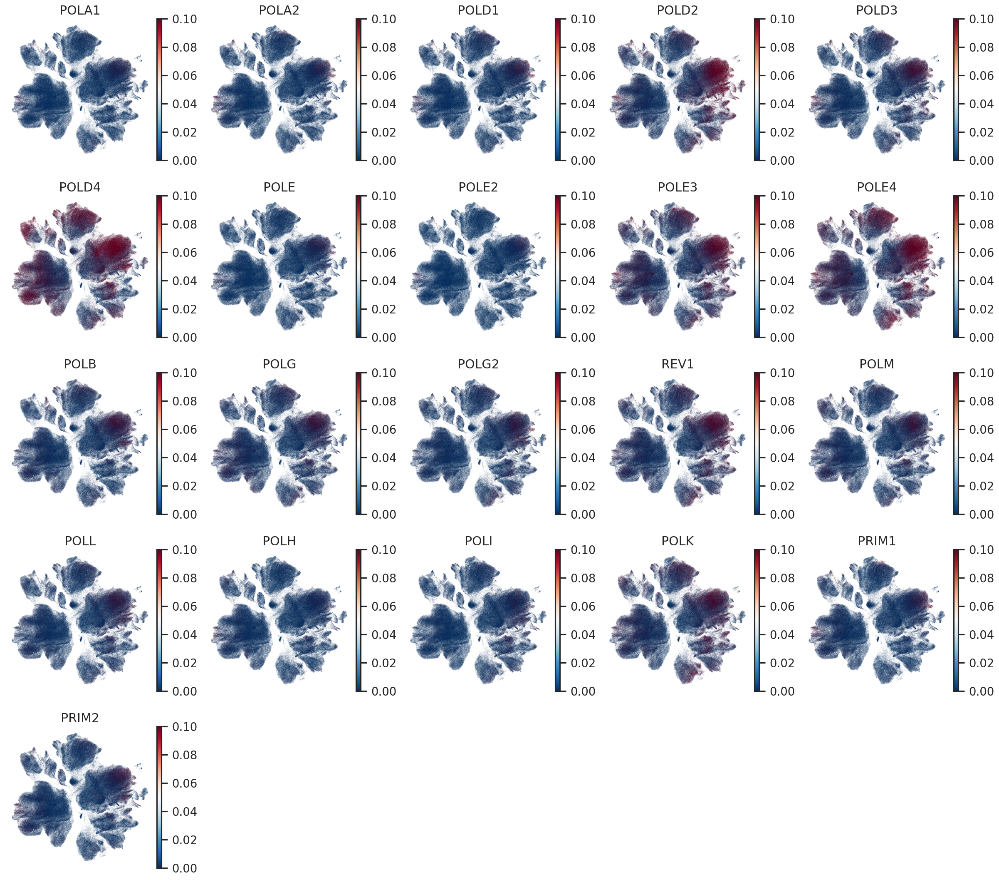

In [91]:
sc.pl.umap(adata, color=human_dna_polymerase_genes,#['Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type','Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA'],
           frameon=False,
           cmap='RdBu_r',vmin=0,vmax=0.1, ncols=5)#, ncols=1,wspace=0.5

In [4]:
human_dna_polymerase_genes = [
    "POLA1",  # DNA polymerase alpha catalytic subunit
    "POLA2",  # DNA polymerase alpha accessory subunit
    "POLD1",  # DNA polymerase delta catalytic subunit
    "POLD2",  # DNA polymerase delta accessory subunit
    "POLD3",  # DNA polymerase delta subunit 3
    "POLD4",  # DNA polymerase delta subunit 4
    "POLE",   # DNA polymerase epsilon catalytic subunit
    "POLE2",  # DNA polymerase epsilon subunit 2
    "POLE3",  # DNA polymerase epsilon subunit 3
    "POLE4",  # DNA polymerase epsilon subunit 4
    "POLB",   # DNA polymerase beta (base excision repair)
    "POLG",   # DNA polymerase gamma catalytic subunit (mitochondrial)
    "POLG2",  # DNA polymerase gamma accessory subunit (mitochondrial)
    "POLZ",   # DNA polymerase zeta catalytic subunit (REV3L)
    "REV1",   # DNA polymerase involved in translesion synthesis
    "POLM",   # DNA polymerase mu (non-homologous end joining)
    "POLL",   # DNA polymerase lambda (base excision repair and non-homologous end joining)
    "POLH",   # DNA polymerase eta (translesion synthesis)
    "POLI",   # DNA polymerase iota (translesion synthesis)
    "POLK",   # DNA polymerase kappa (translesion synthesis)
    "PRIM1",  # DNA primase subunit
    "PRIM2",  # DNA primase subunit
    "TERT"    # Telomerase reverse transcriptase
]
human_dna_polymerase_genes= [gene for gene in human_dna_polymerase_genes if gene in adata.var.index]
human_dna_polymerase_genes

['POLA1',
 'POLA2',
 'POLD1',
 'POLD2',
 'POLD3',
 'POLD4',
 'POLE',
 'POLE2',
 'POLE3',
 'POLE4',
 'POLB',
 'POLG',
 'POLG2',
 'REV1',
 'POLM',
 'POLL',
 'POLH',
 'POLI',
 'POLK',
 'PRIM1',
 'PRIM2']

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


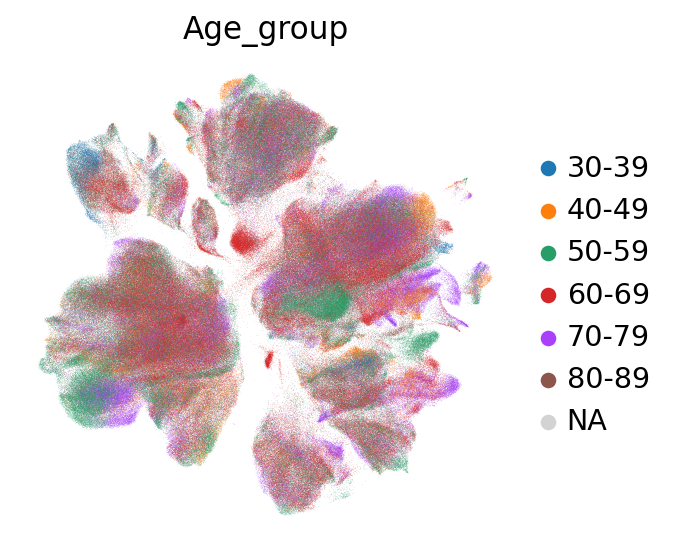

In [16]:
sc.pl.umap(adata, color=['Age_group'],frameon=False,
           cmap='RdPu',vmin=0,vmax=1.3, ncols=1)#, ncols=1,wspace=0.5

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via

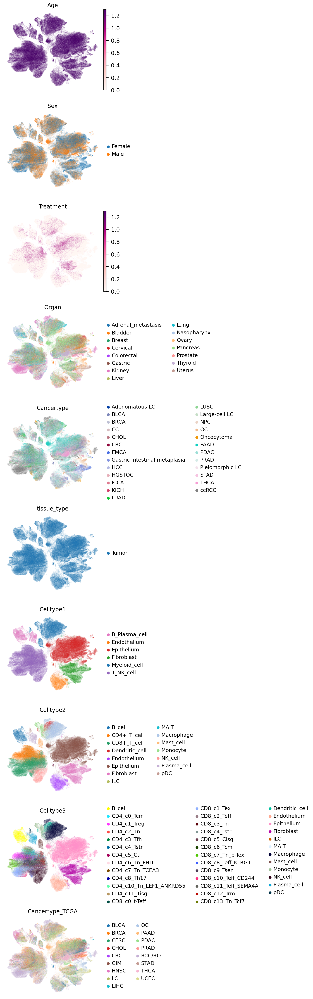

In [5]:
sc.pl.umap(adata, color=['Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type','Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA'],frameon=False,
           cmap='RdPu',vmin=0,vmax=1.3, ncols=1)#, ncols=1,wspace=0.5

In [12]:
import pandas as pd

# Convert 'Age' to an ordered categorical type (if it's categorical)
adata.obs['Age'] = adata.obs['Age'].astype('float')  # Convert to numeric first if needed

# Define bins from 30 onwards in 10-year intervals
bins = range(30, int(adata.obs['Age'].max()) + 10, 10)

# Generate labels for each bin
labels = [f"{age_group}-{age_group+9}" for age_group in bins[:-1]]

# Apply pd.cut to create the new 'Age_group' column
adata.obs['Age_group'] = pd.cut(adata.obs['Age'], bins=bins, labels=labels, right=False)

# Check the new column
adata.obs[['Age', 'Age_group']].head()


,Age,Age_group
GSE150430_P01_CGGACTGGTCCTCCAT-1-0,37.0,30-39
GSE150430_P01_CTTCTCTGTGCACTTA-1-0,37.0,30-39
GSE150430_P01_AACTCCCAGTAGGTGC-2-0,37.0,30-39
GSE150430_P01_CGGACTGGTCCTCCAT-2-0,37.0,30-39
GSE150430_P03_CATGGCGAGCTCCTCT-1-0,31.0,30-39


/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


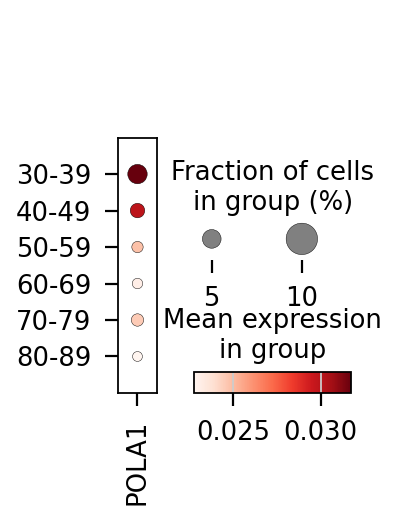

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


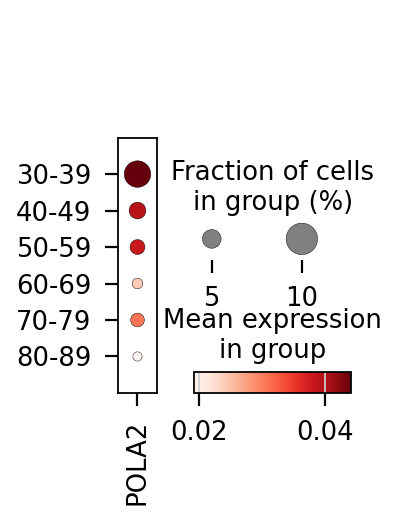

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


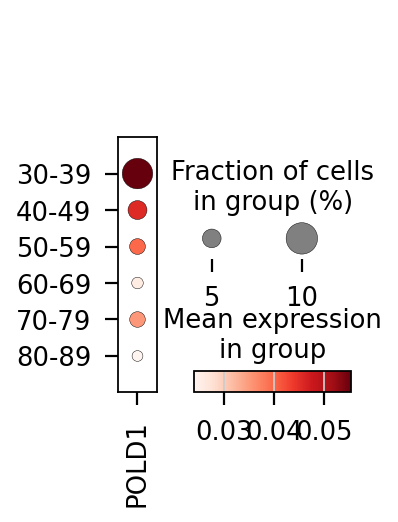

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


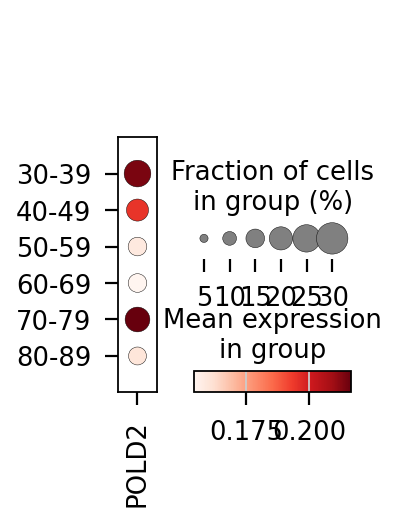

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


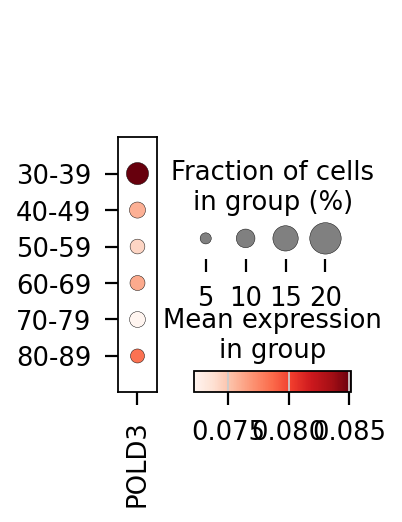

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


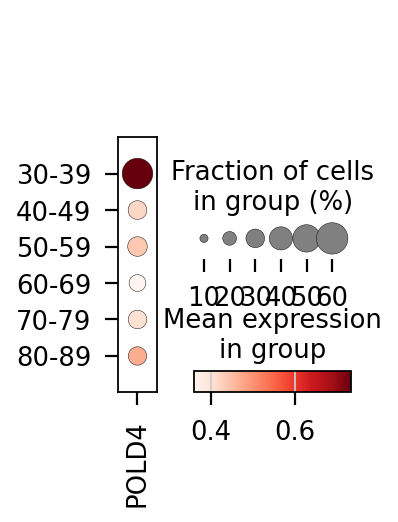

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


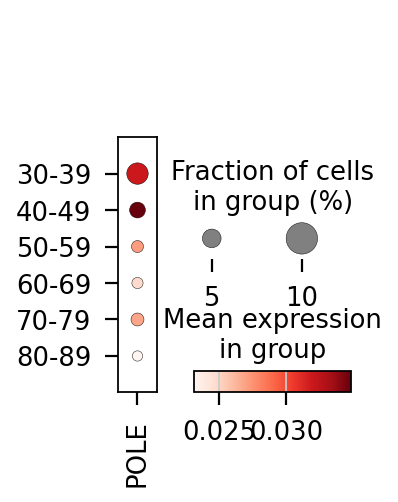

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


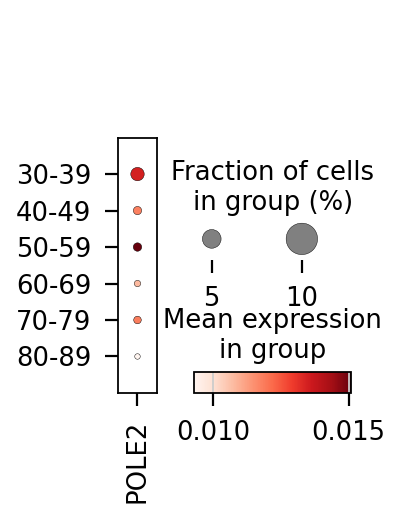

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


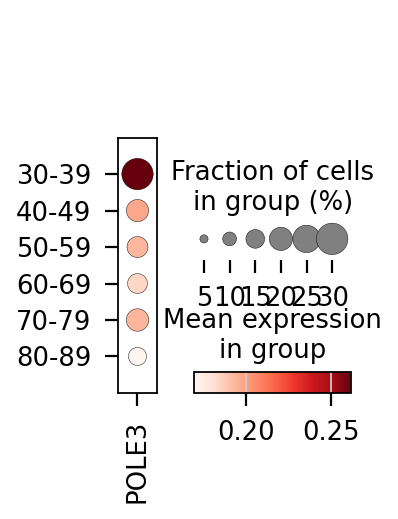

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


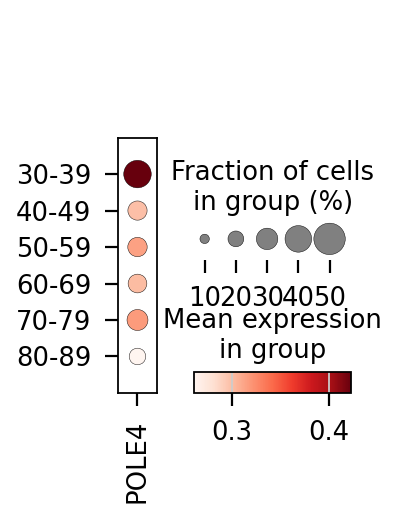

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


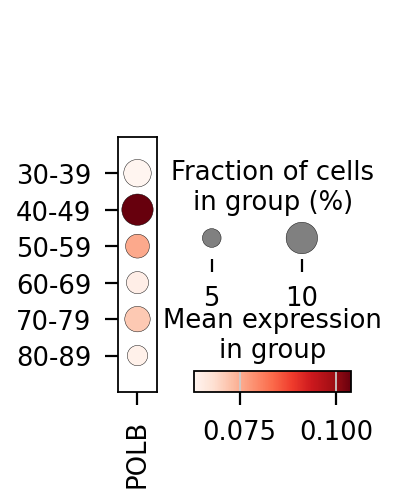

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


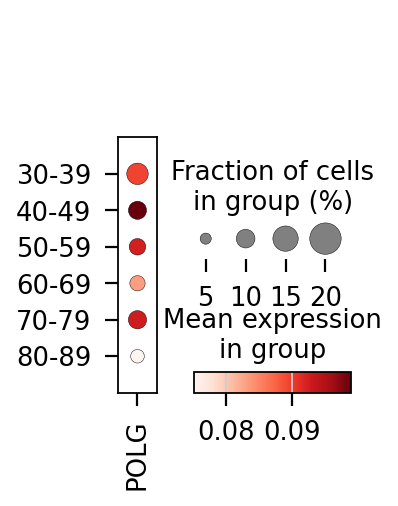

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


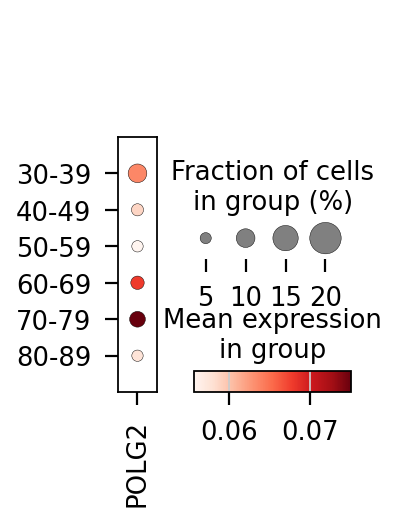

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


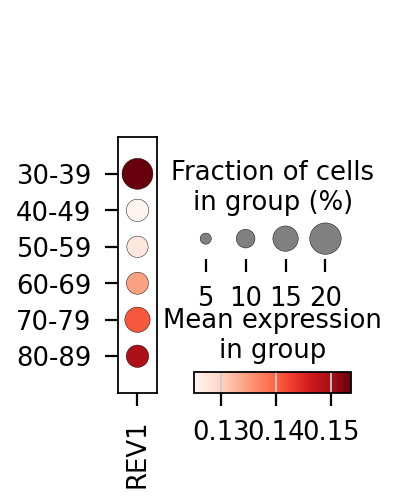

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


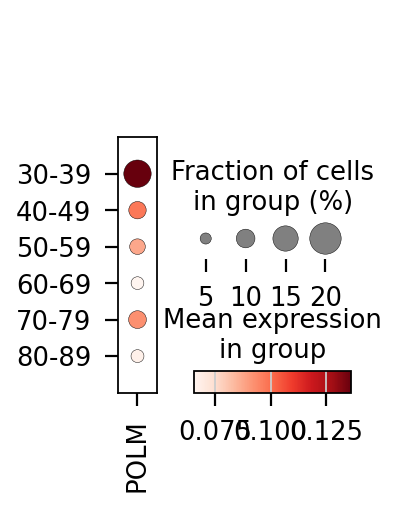

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


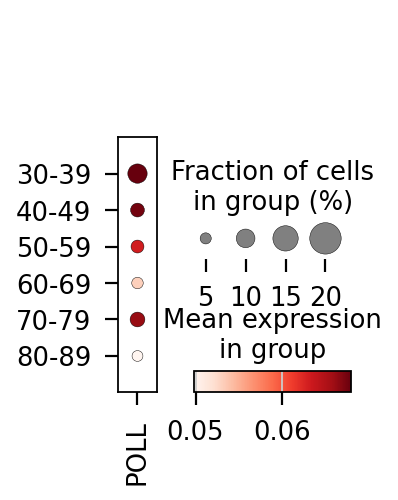

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


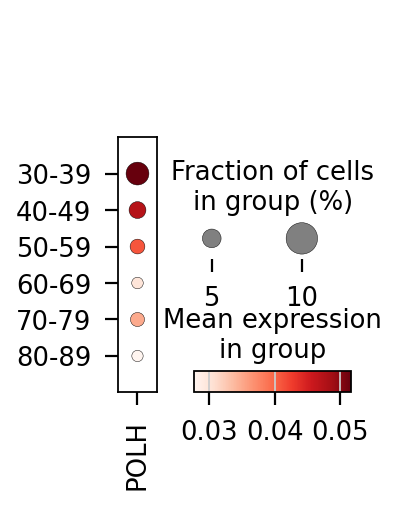

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


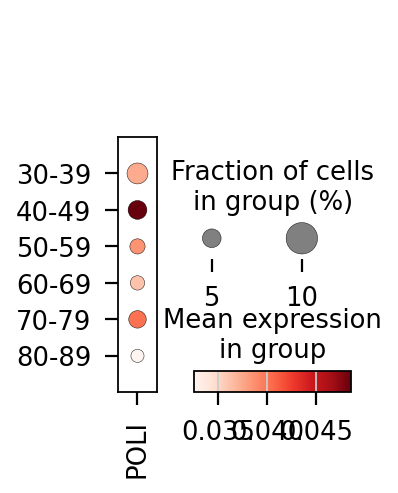

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


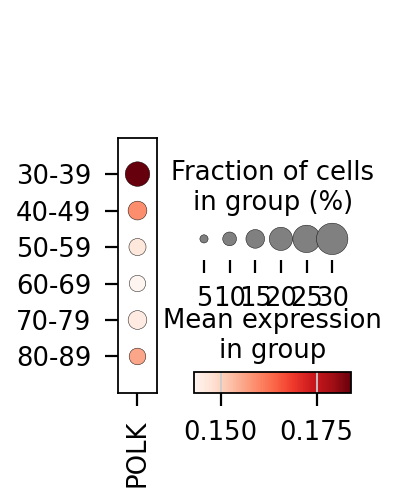

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


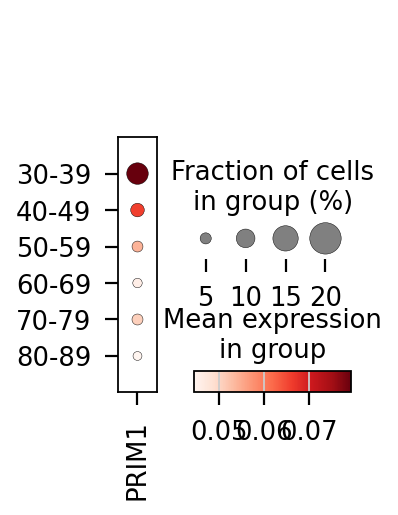

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


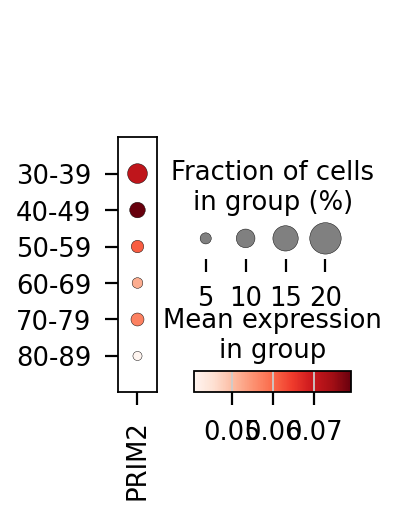

In [13]:
adata.obs['Age_group'] = adata.obs['Age_group'].astype('category')
for gene in human_dna_polymerase_genes:
    
    sc.pl.dotplot(adata, gene, 'Age_group', dendrogram=False)


/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


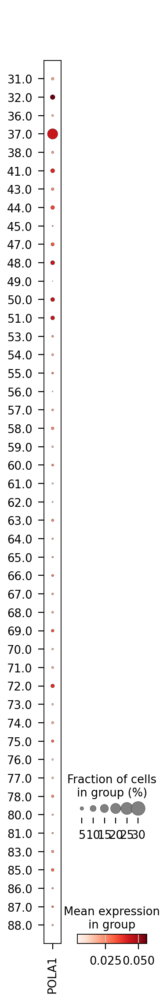

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


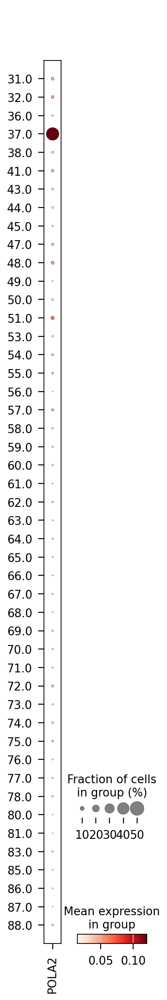

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


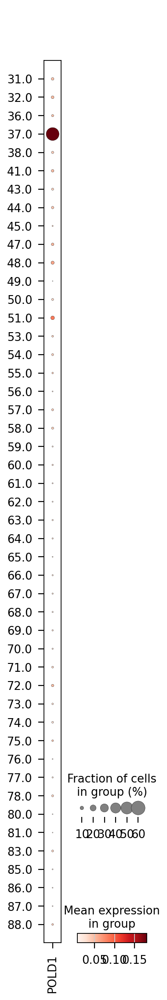

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


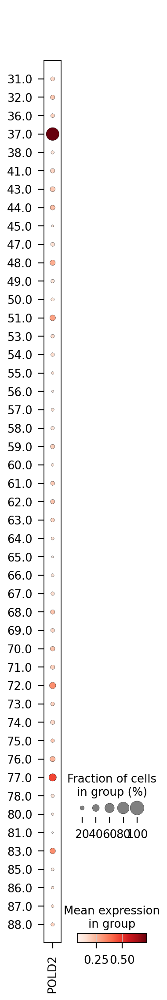

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


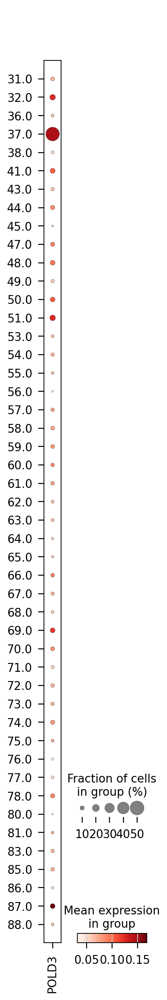

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


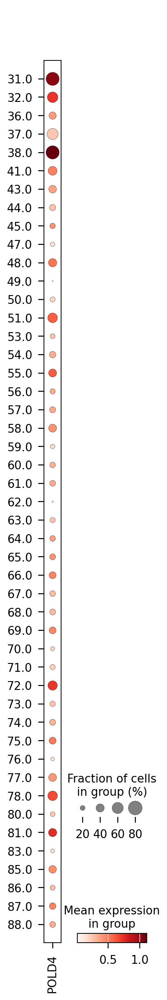

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


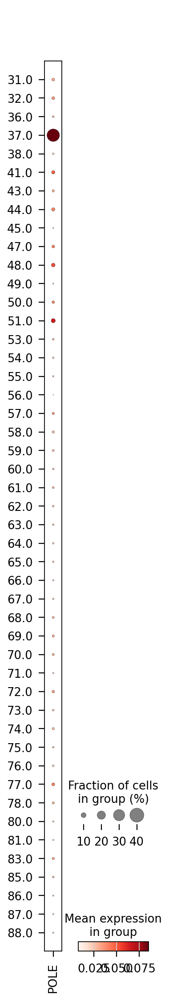

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


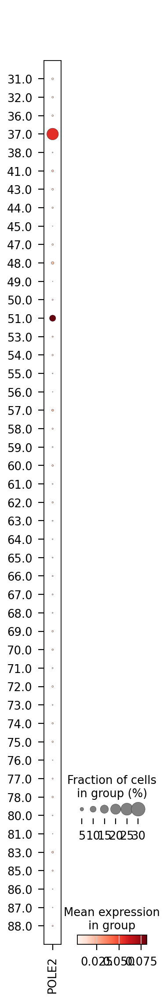

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


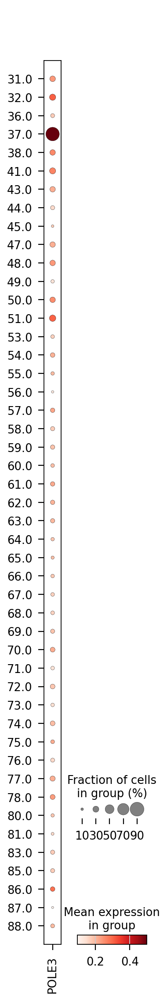

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


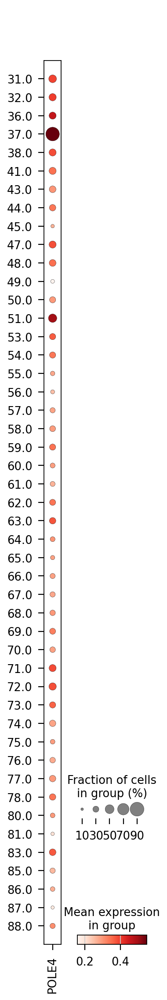

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


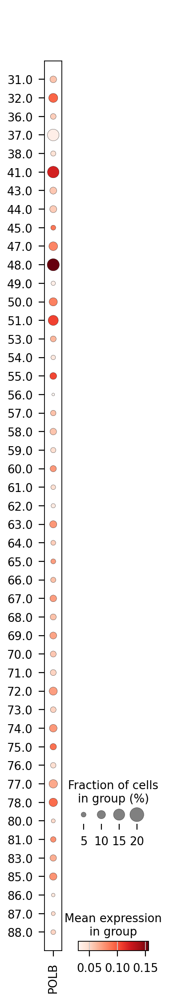

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


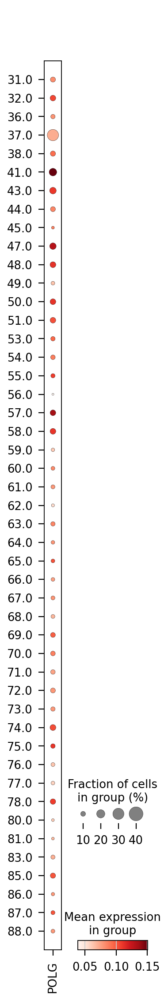

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


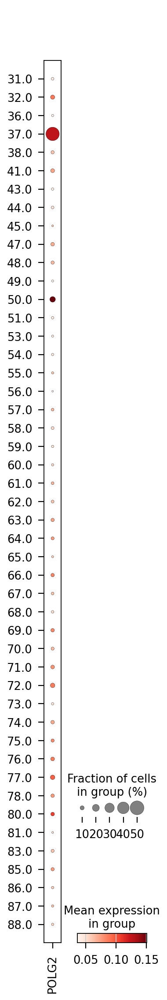

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


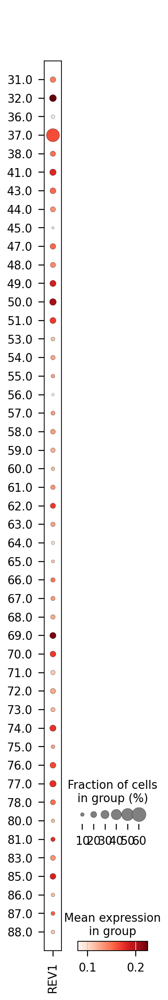

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


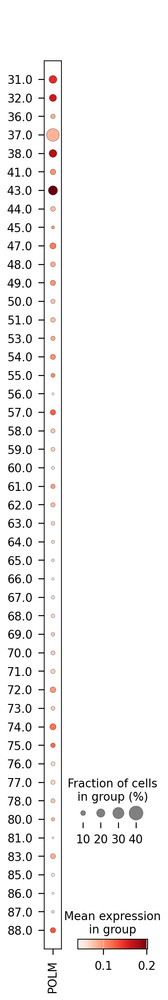

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


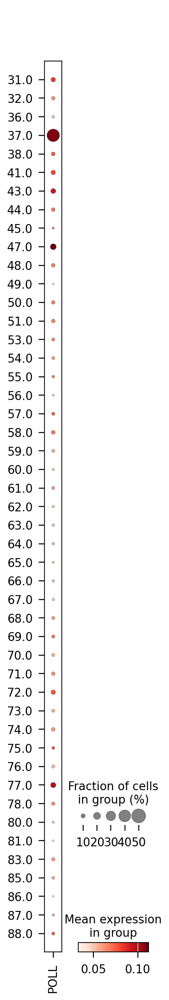

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


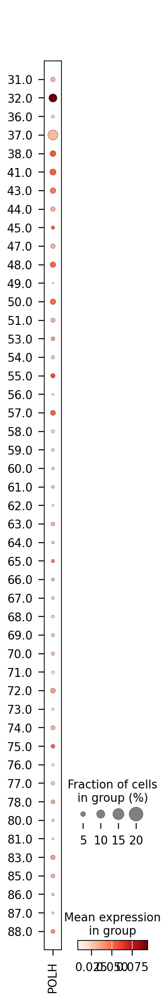

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


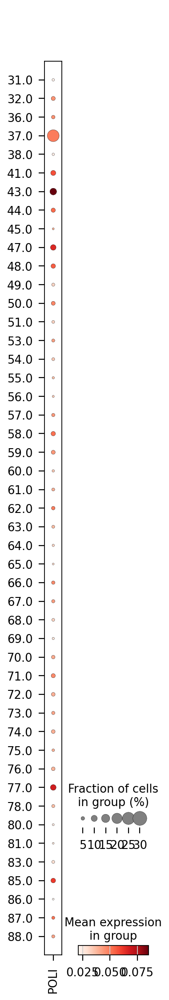

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


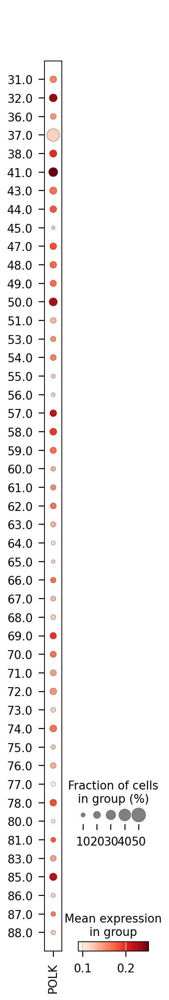

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


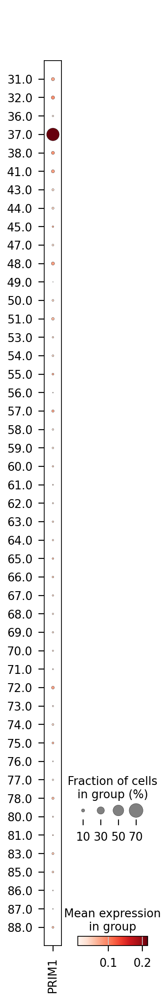

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


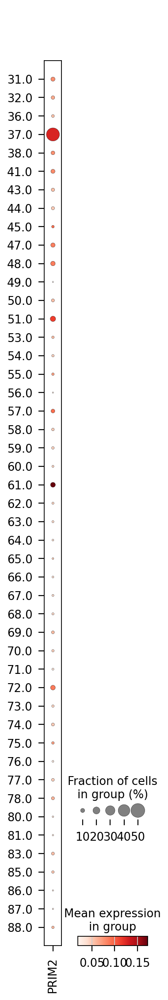

In [10]:
adata.obs['Age'] = adata.obs['Age'].astype('category')
for gene in human_dna_polymerase_genes:
    
    sc.pl.dotplot(adata, gene, 'Age', dendrogram=False)


/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


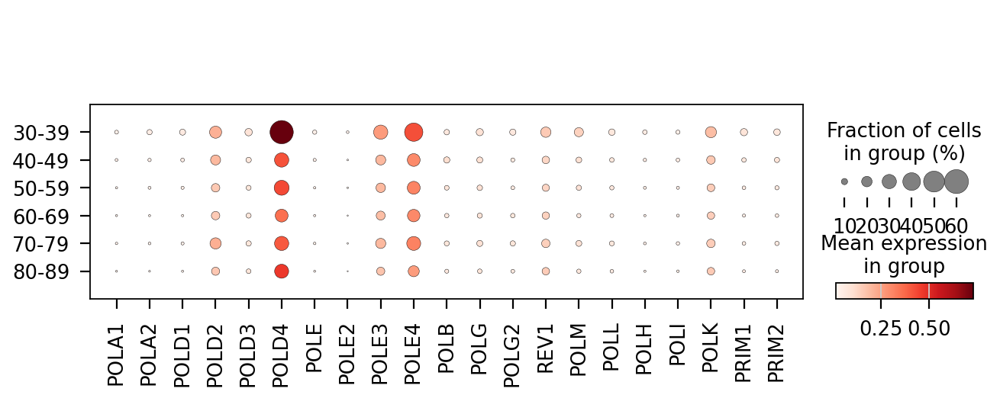

In [14]:
sc.pl.dotplot(adata, human_dna_polymerase_genes, 'Age_group', dendrogram=False)


/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


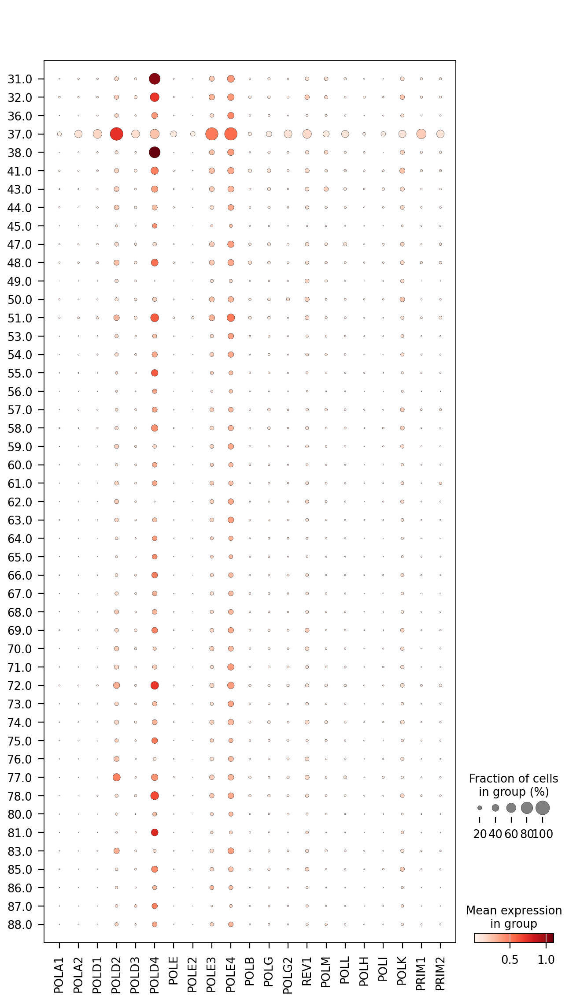

In [9]:
adata.obs['Age'] = adata.obs['Age'].astype('category')
sc.pl.dotplot(adata, human_dna_polymerase_genes, 'Age', dendrogram=False)


In [ ]:
 
sc.pl.dotplot(adata, human_dna_polymerase_genes, 'Cancertype_TCGA', dendrogram=False)


In [ ]:
adata.obs['Age'] = adata.obs['Age'].astype('category')
for gene in human_dna_polymerase_genes:
    
    sc.pl.dotplot(adata, gene, 'Age', dendrogram=False)

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


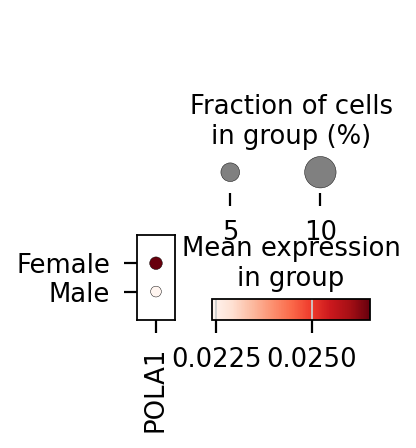

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


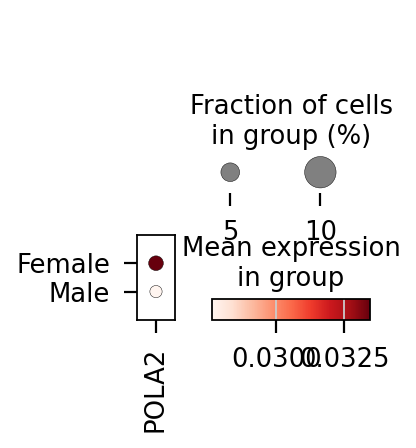

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


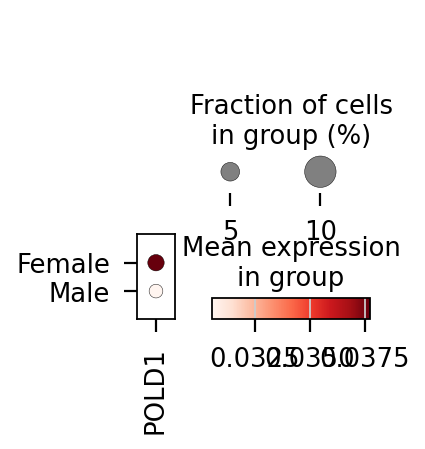

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


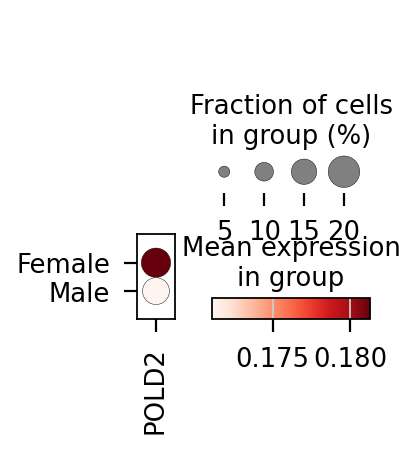

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


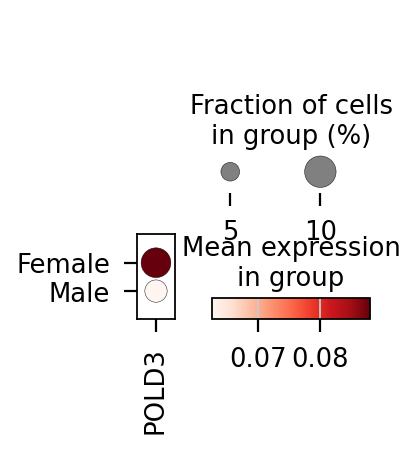

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


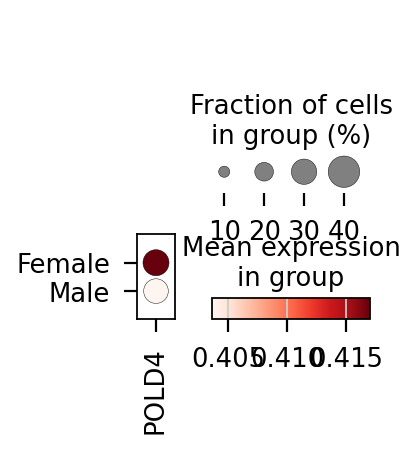

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


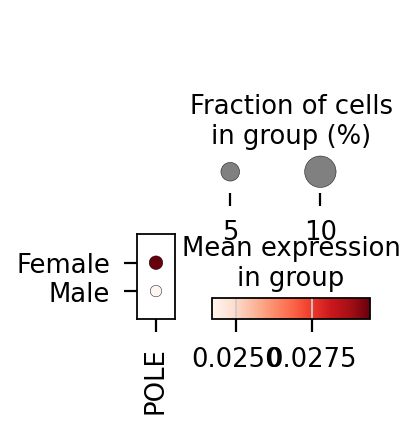

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


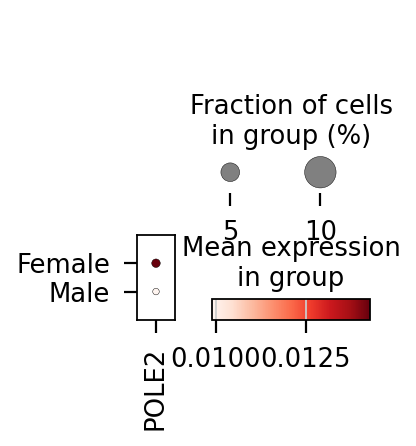

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


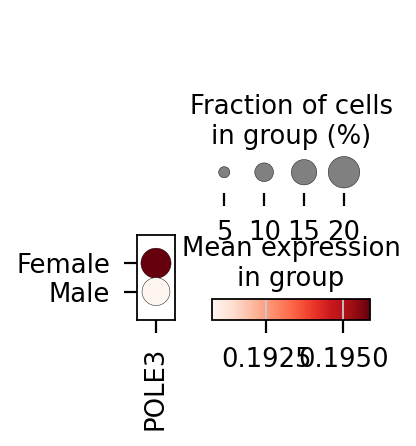

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


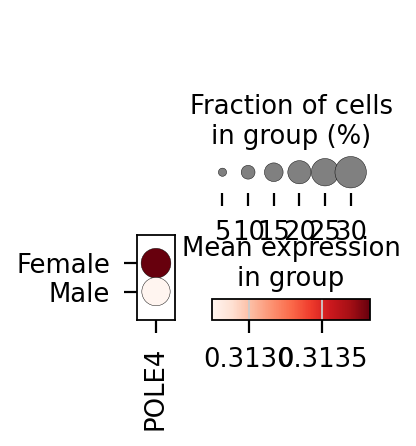

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


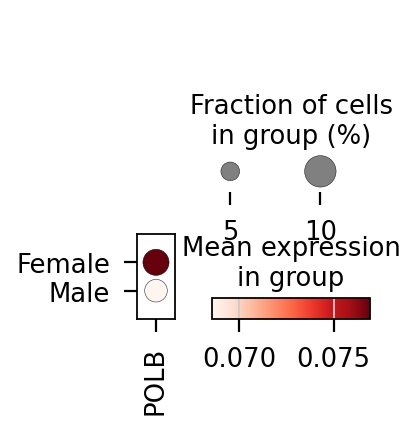

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


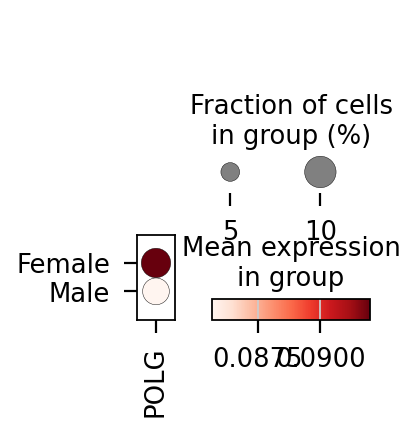

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


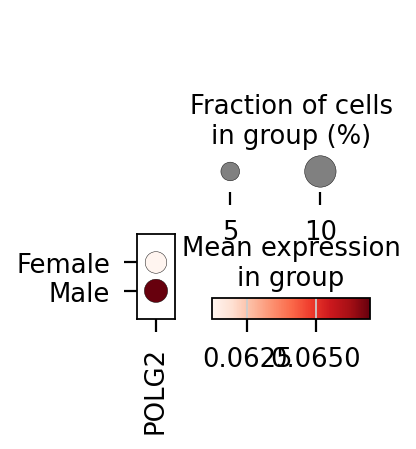

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


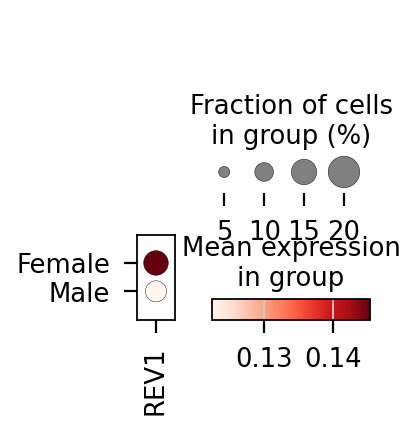

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


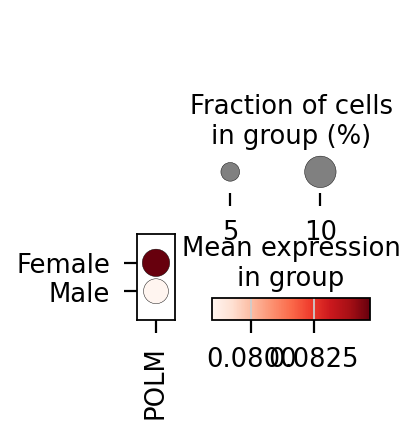

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


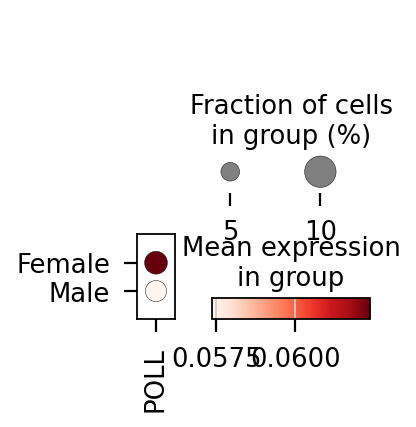

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


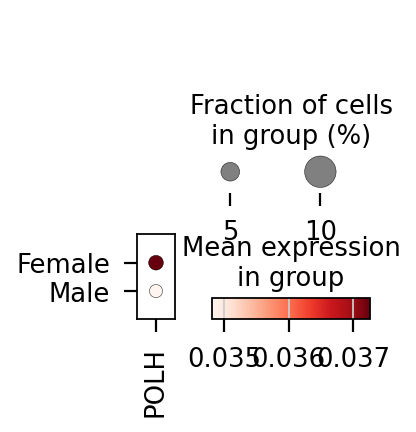

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


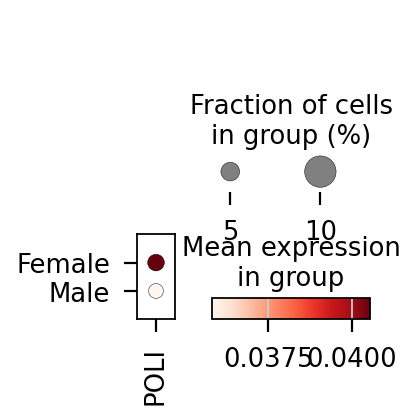

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


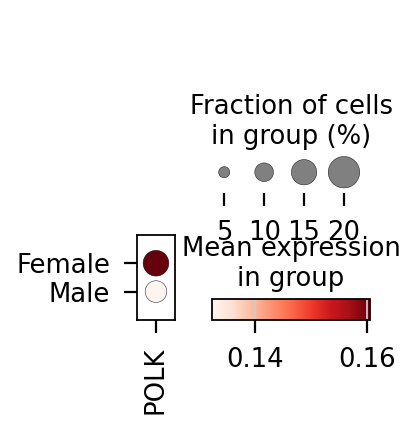

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


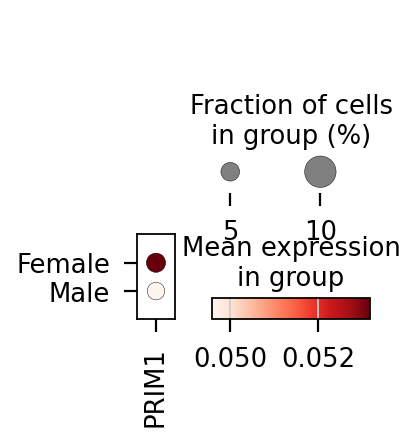

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


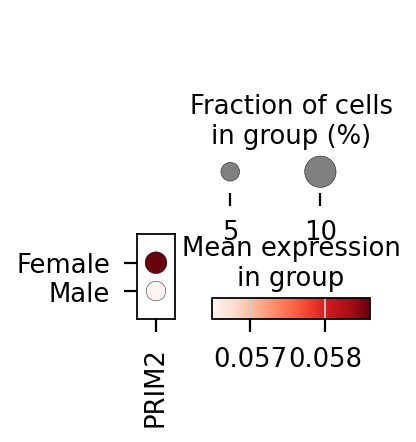

In [17]:
for gene in human_dna_polymerase_genes:
    
    sc.pl.dotplot(adata, gene, 'Sex', dendrogram=False)

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


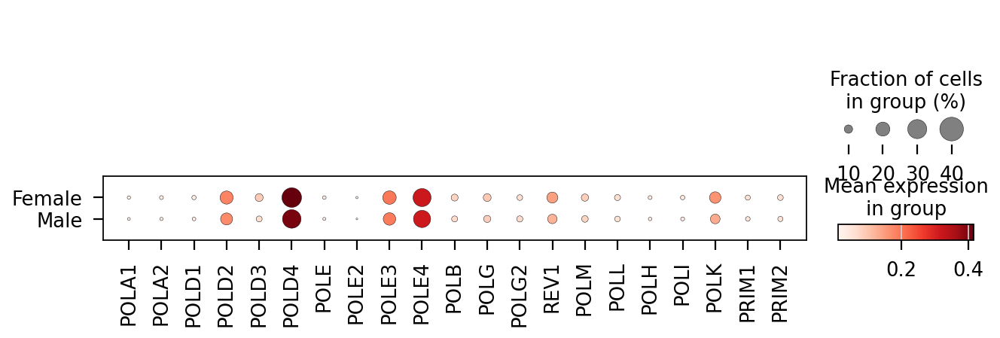

In [15]:
sc.pl.dotplot(adata, human_dna_polymerase_genes, 'Sex', dendrogram=False)


/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


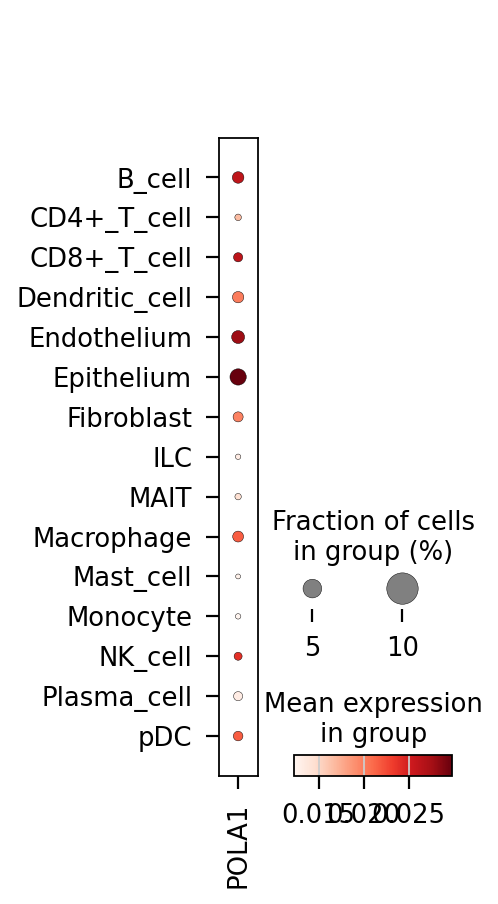

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


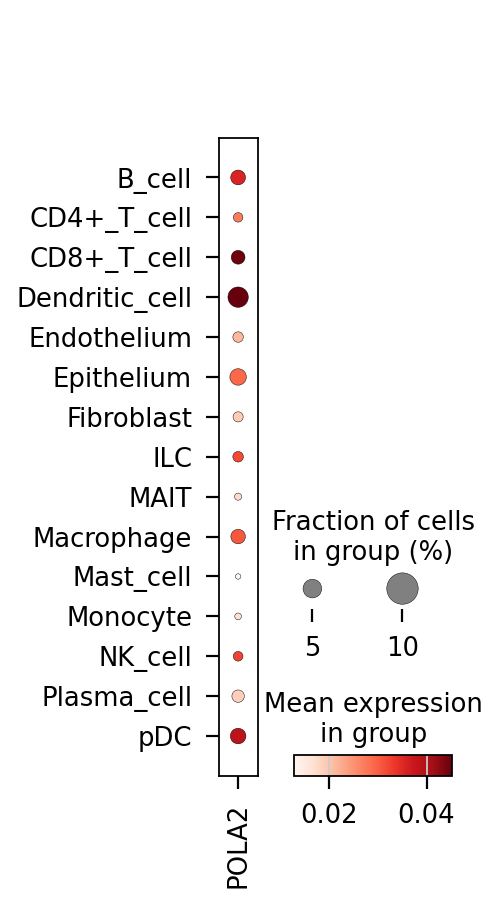

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


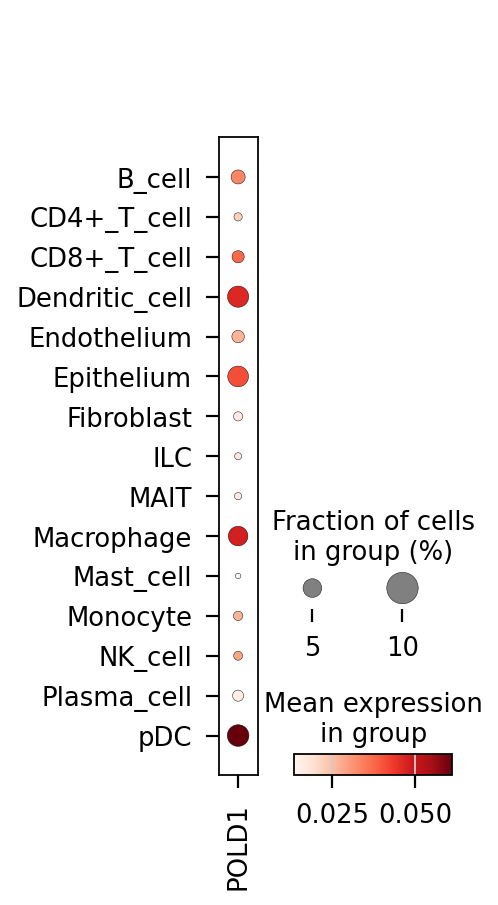

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


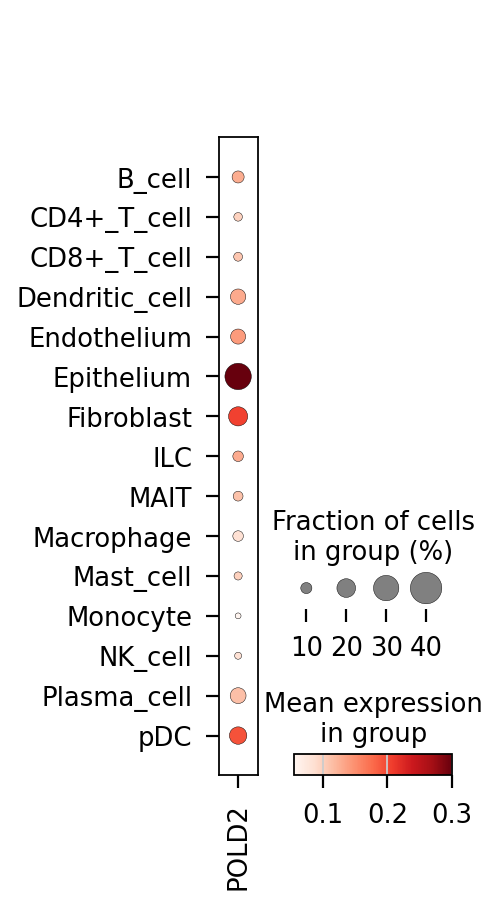

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


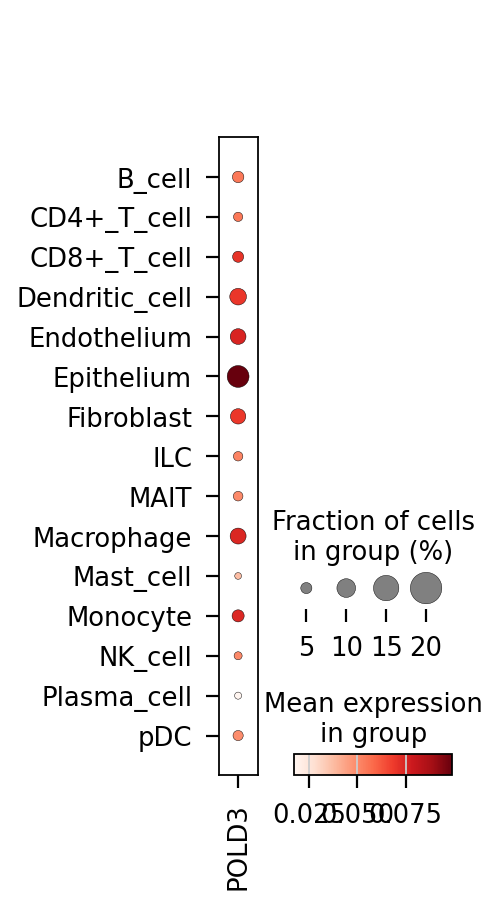

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


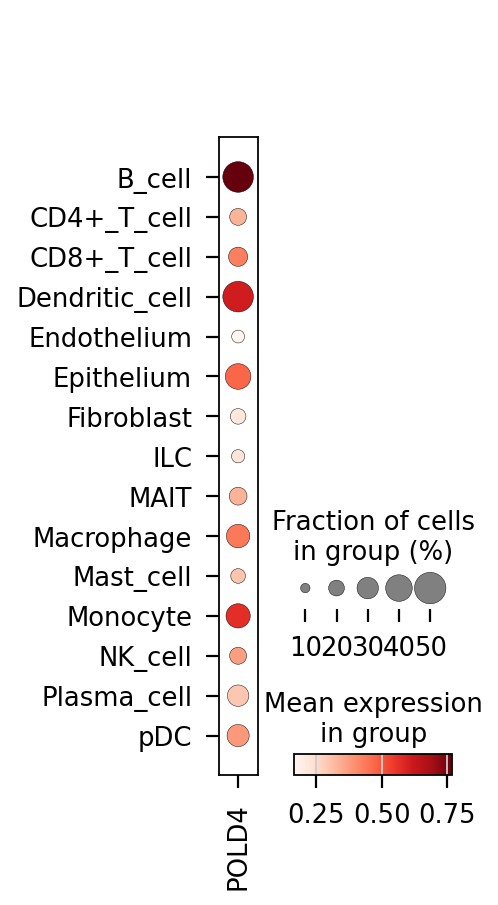

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


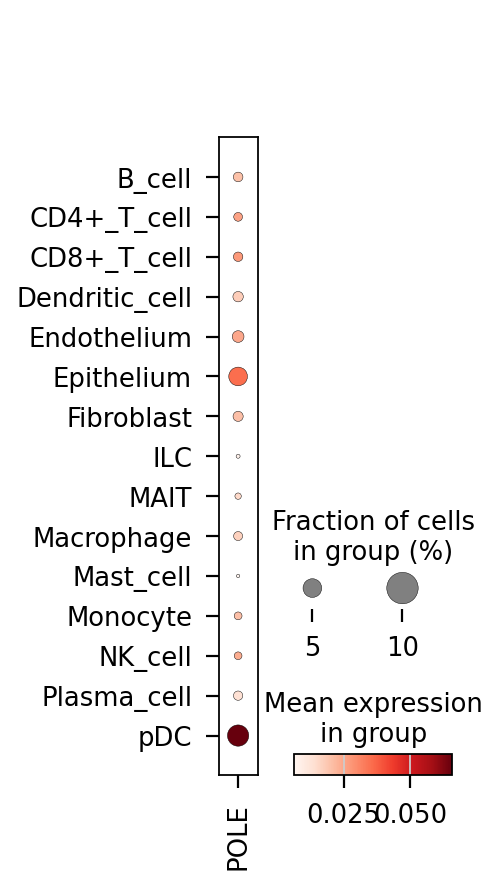

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


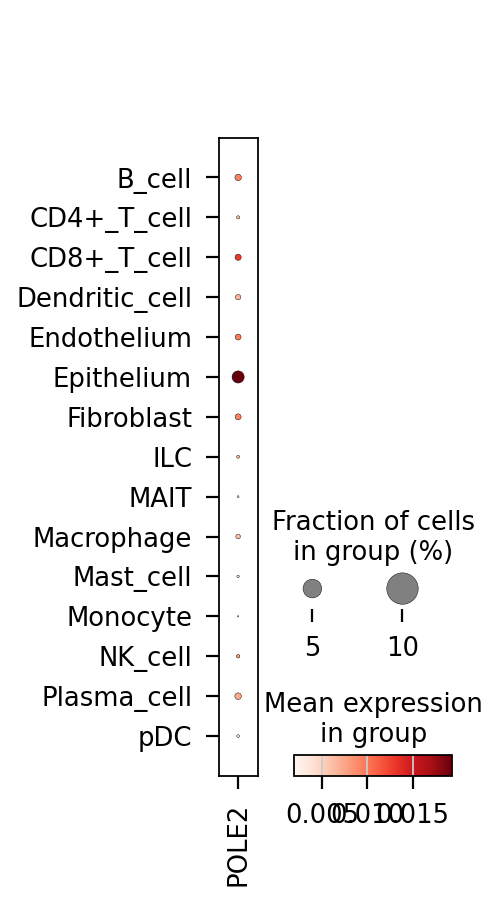

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


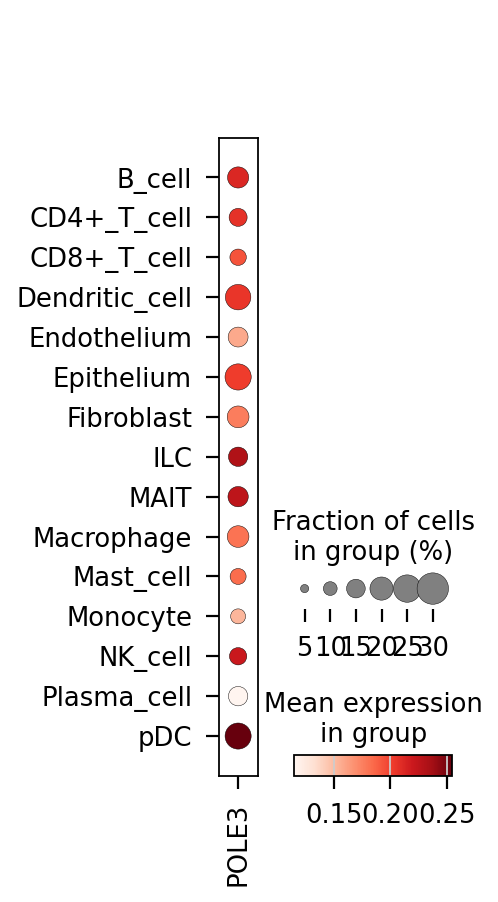

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


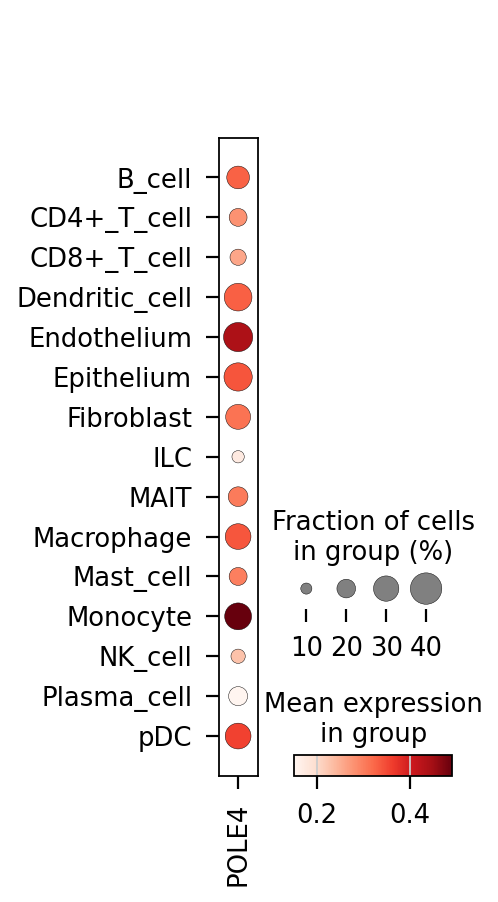

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


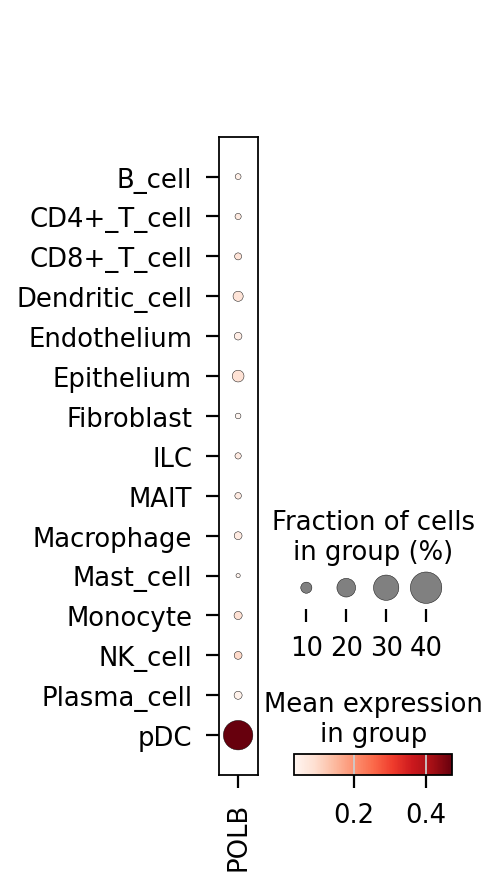

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


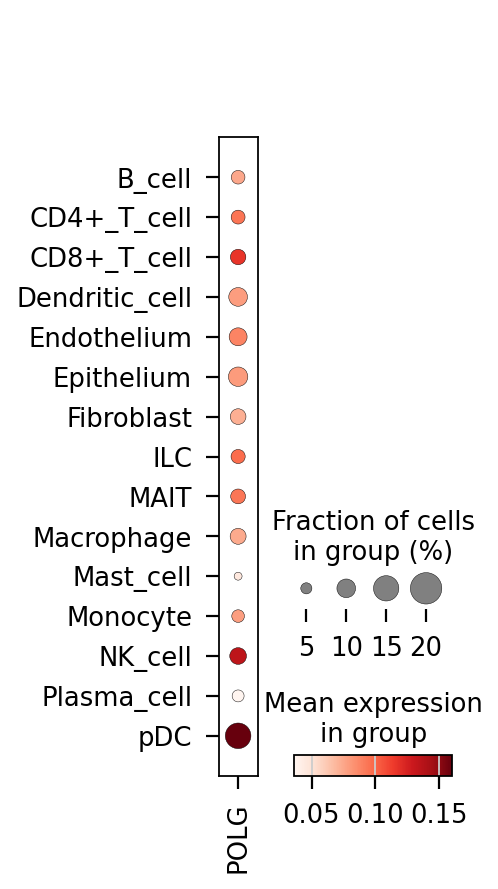

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


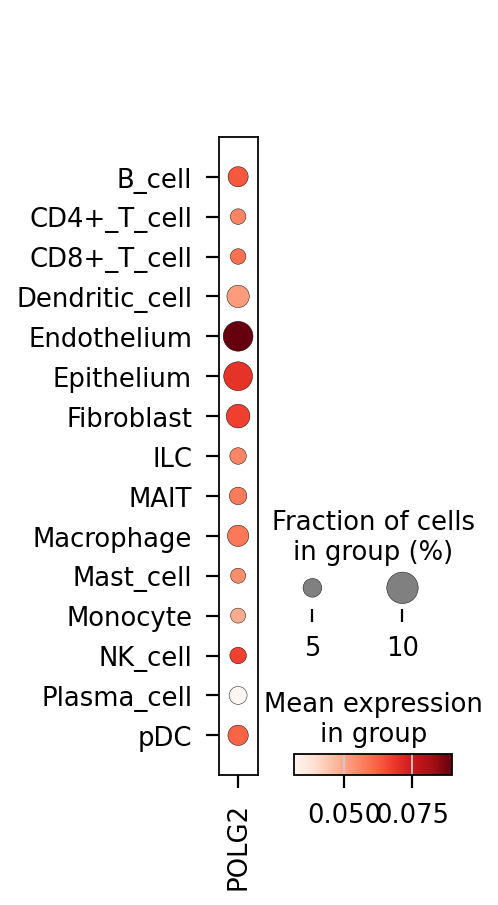

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


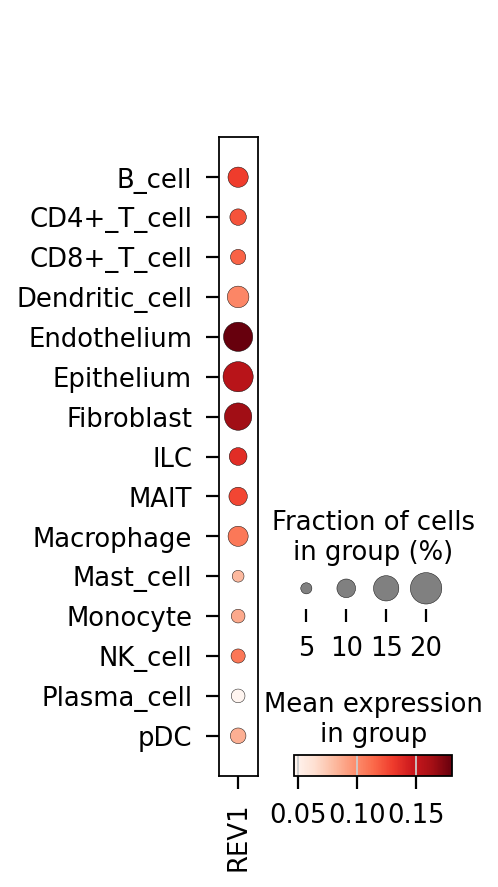

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


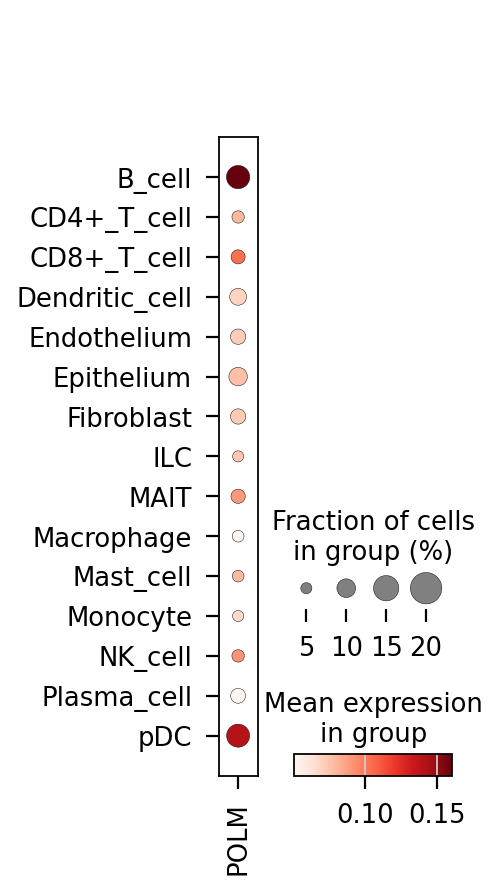

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


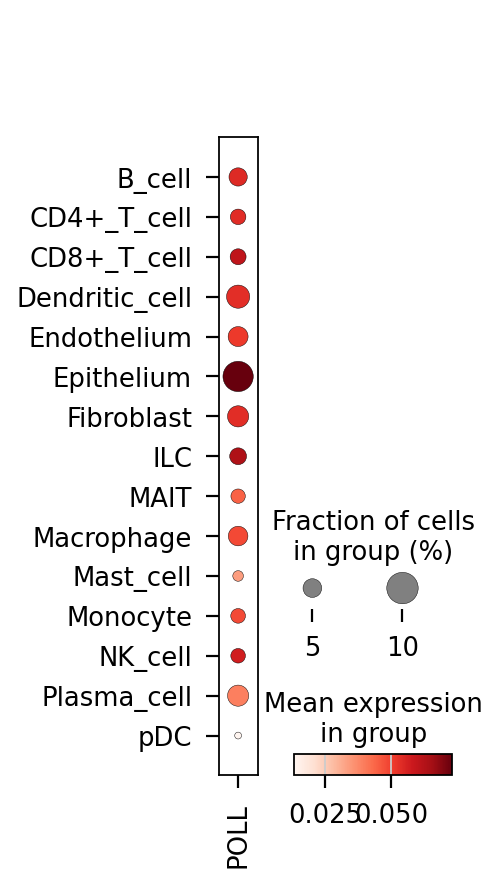

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


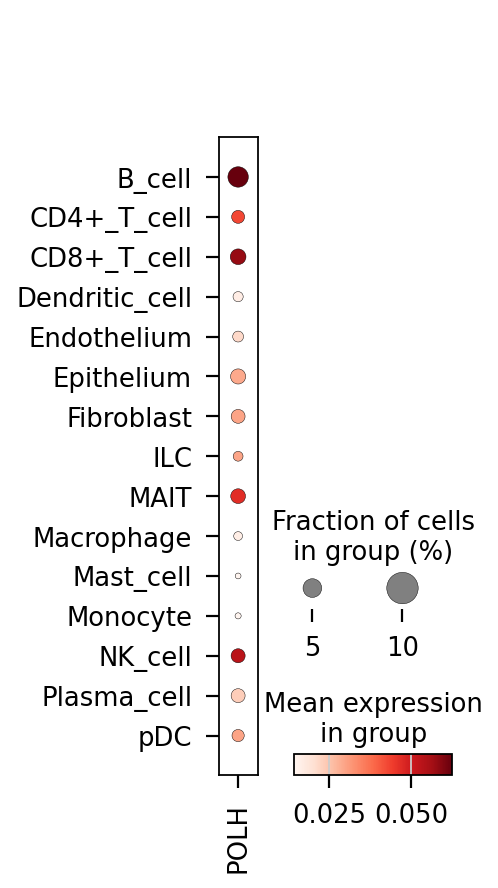

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


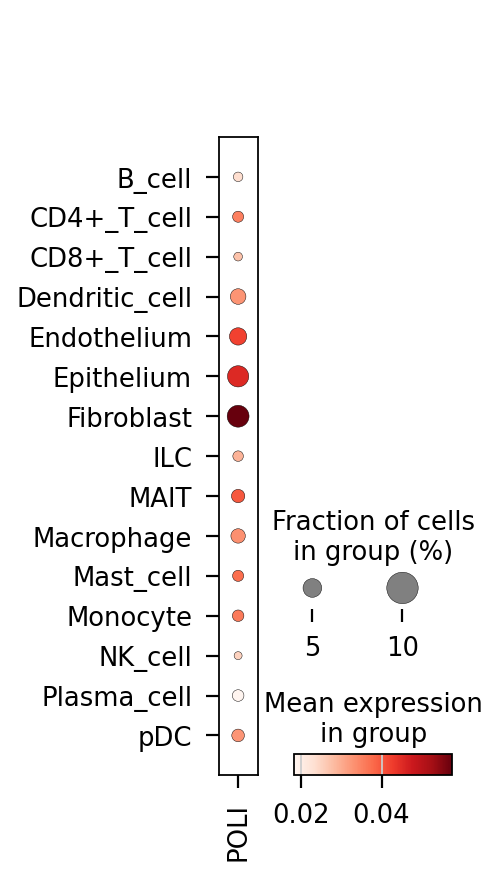

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


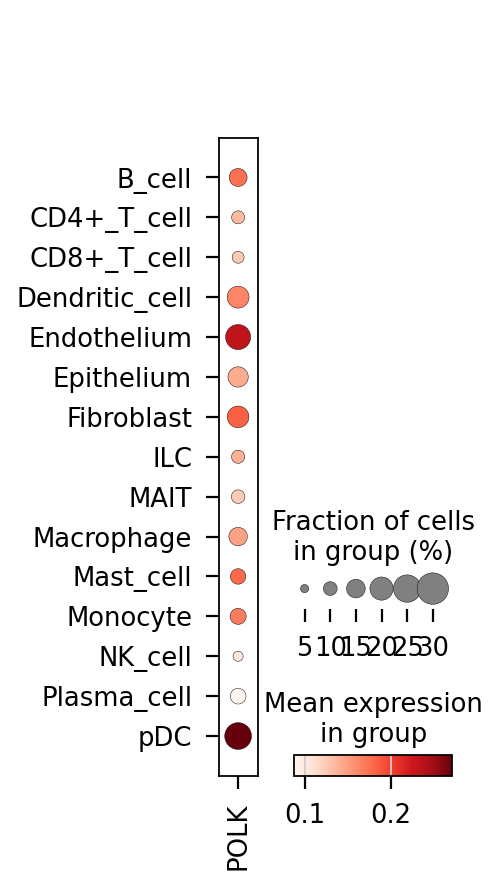

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


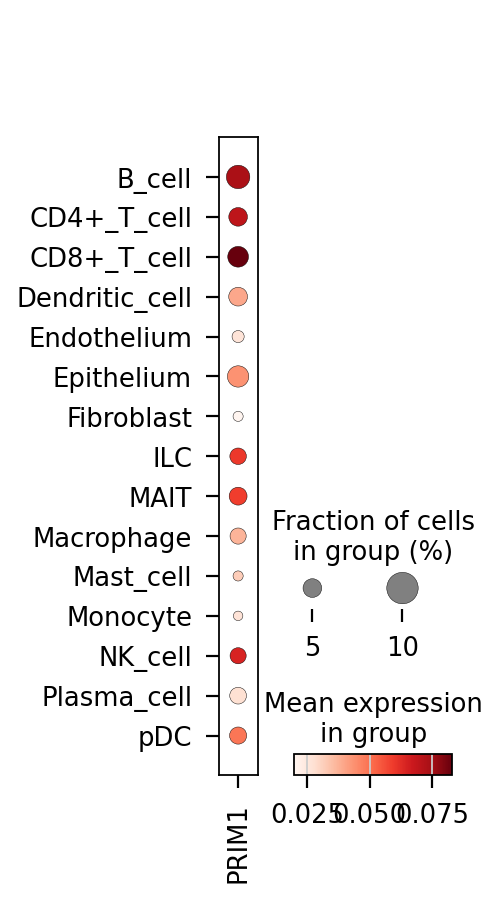

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


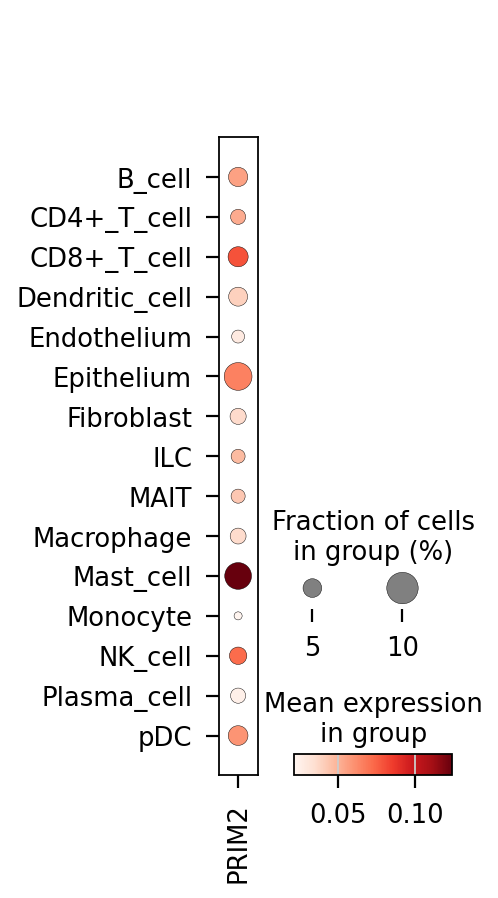

In [18]:
for gene in human_dna_polymerase_genes:
    
    sc.pl.dotplot(adata, gene, 'Celltype2', dendrogram=False)

/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:169: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:179: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored


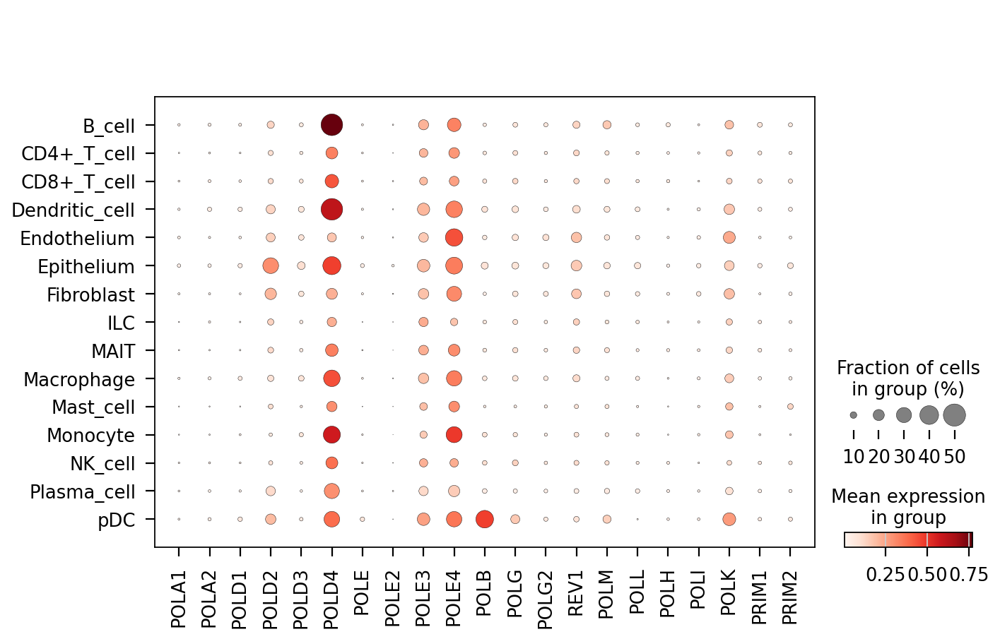

In [6]:
 
sc.pl.dotplot(adata, human_dna_polymerase_genes, 'Celltype2', dendrogram=False)


findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

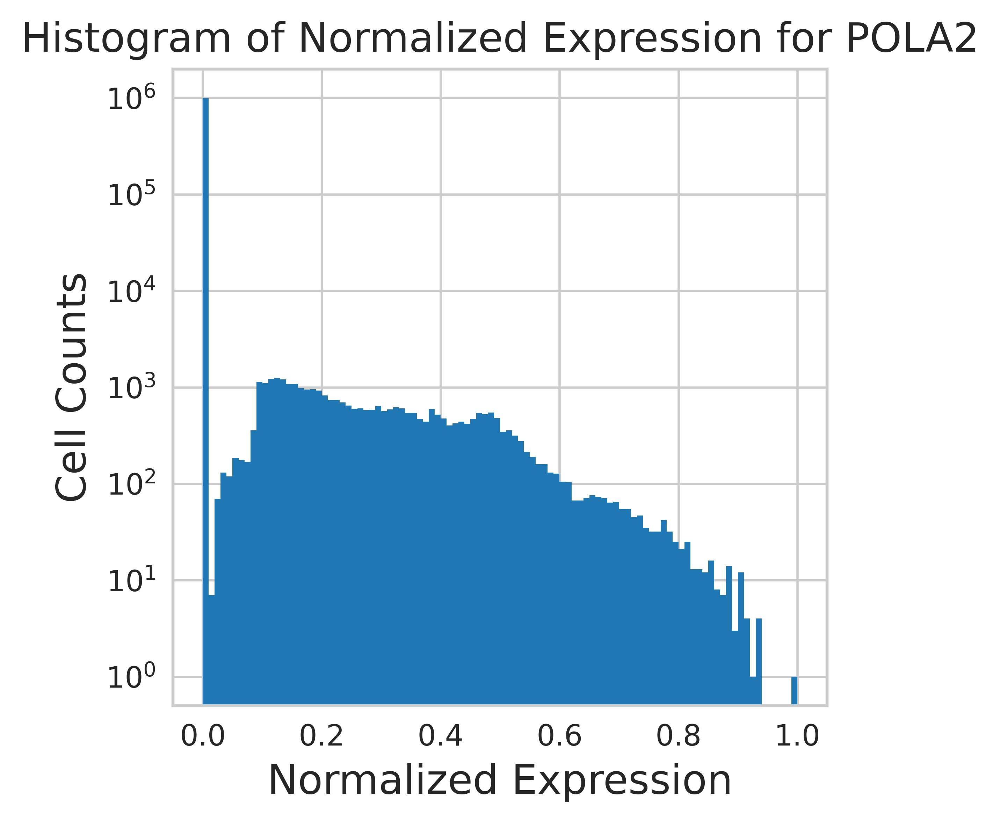

In [60]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from matplotlib import rcParams

# Set the resolution of the plot
rcParams['figure.dpi'] = 300

# Parameters for the data and plot
gene_label = 'POLA2'

# Retrieve the expression values for the gene and log transform them
expression_values = adata[:, gene_label].X.toarray()

# Normalize the data using MinMaxScaler
normalized_values = MinMaxScaler().fit_transform(expression_values).flatten()

# Create a histogram of the normalized data
plt.hist(normalized_values, bins=100, log=True)
plt.title(f'Histogram of Normalized Expression for {gene_label}')
plt.xlabel('Normalized Expression')
plt.ylabel('Cell Counts')
plt.show()

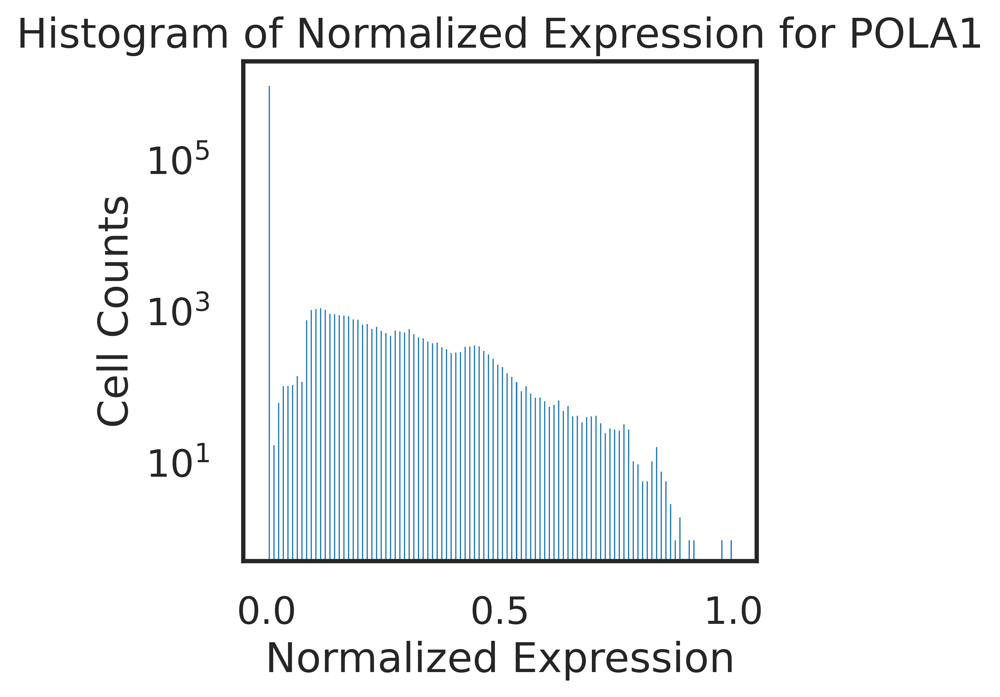

In [107]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from matplotlib import rcParams

# Set the resolution of the plot
rcParams['figure.dpi'] = 300

# Parameters for the data and plot
gene_label = 'POLA1'

# Retrieve the expression values for the gene and log transform them
expression_values = adata[:, gene_label].X.toarray()

# Normalize the data using MinMaxScaler
normalized_values = MinMaxScaler().fit_transform(expression_values).flatten()

# Create a histogram of the normalized data
plt.hist(normalized_values, bins=100, log=True)
plt.title(f'Histogram of Normalized Expression for {gene_label}')
plt.xlabel('Normalized Expression')
plt.ylabel('Cell Counts')
plt.show()

In [30]:
adata

AnnData object with n_obs × n_vars = 1030968 × 14090
    obs: 'SampleID', 'DataID', 'Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type', 'DataSampleID', 'celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', '_scvi_batch', '_scvi_labels', 'Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA', 'RL_Prediction_Only9genes', 'LOY', 'Age_group'
    var: 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Cancertype_TCGA_colors', 'Cancertype_colors', 'Celltype1_colors', 'Celltype2_colors', 'Celltype3_colors', 'DataID_colors', 'Organ_colors', 'Sex_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltype_colors', 'hvg', 'neighbors', 'rank_genes_groups', 'umap', 'tissue_type_colors', 'Age_group_colors'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'
    obsp: 'connectivities', 'distances'

In [108]:
dapi_filter = v1 > 0
print(dapi_filter.sum())

27720


In [109]:
dapi_pass = np.zeros(adata.shape[0], dtype=object)
dapi_pass[:] = 'Pass'
dapi_pass[~dapi_filter] = 'Fail'
adata.obs['POLA1_Exp_pass_fail'] = pd.Categorical(dapi_pass)

/tmp/ipykernel_131427/2099288746.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

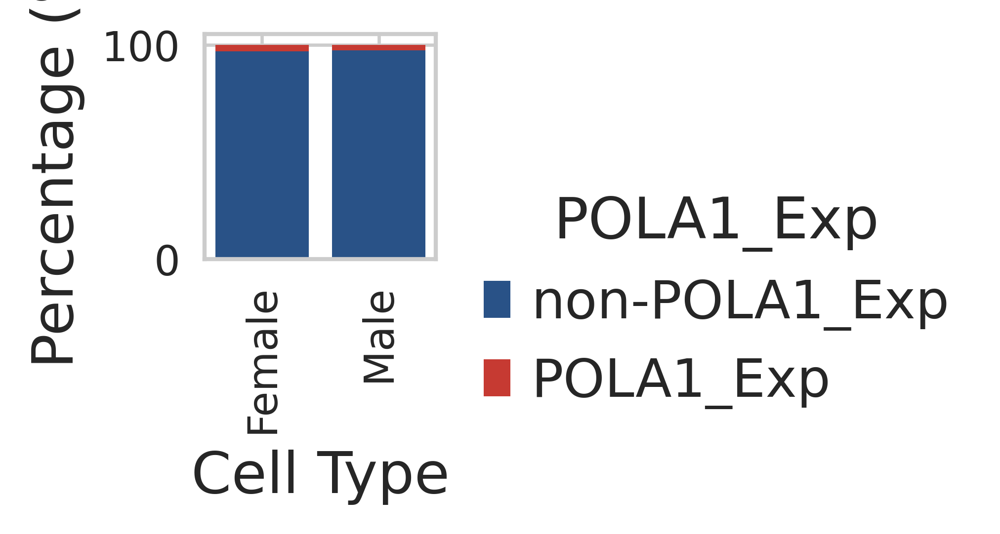

In [48]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set the style
plt.style.use('seaborn-whitegrid')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Figure setup
fig = plt.figure(figsize=(1
                          ,1
                         ), facecolor='white')  

counts = pd.crosstab(adata.obs['Sex'], adata.obs['POLA1_Exp'])

total = counts.sum(axis=1)
bottom_data_percentage = (counts.get('Fail', np.zeros_like(counts.index)) / total) * 100
top_data_percentage = (counts.get('Pass', np.zeros_like(counts.index)) / total) * 100

# Sort data for better visual comparison
sorted_indices = top_data_percentage.sort_values(ascending=False).index

# Barplot with improved color scheme
plt.bar(sorted_indices, bottom_data_percentage[sorted_indices], color='#295287', label='non-POLA1_Exp')
plt.bar(sorted_indices, top_data_percentage[sorted_indices], bottom=bottom_data_percentage[sorted_indices], color='#c63a32', label='POLA1_Exp')

# Labeling and titling
plt.xlabel('Cell Type')
plt.ylabel('Percentage (%)')
#plt.title('Distribution of LOY Across Gender Groups in Tumor Predictions')

# Legend and ticks
plt.xticks(rotation=90)
plt.legend(title='POLA1_Exp', loc='upper left', bbox_to_anchor=(1, 0.5))  # Adjusted for better visibility

# Layout adjustment
plt.tight_layout()

# Uncomment to save the figure
# plt.savefig('sorted_stacked_bar_chart_percentage.pdf', dpi=300, bbox_inches='tight')
plt.show()


In [49]:
adata

AnnData object with n_obs × n_vars = 1030968 × 14090
    obs: 'SampleID', 'DataID', 'Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type', 'DataSampleID', 'celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', '_scvi_batch', '_scvi_labels', 'Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA', 'RL_Prediction_Only9genes', 'LOY', 'Age_group', 'POLA1_Exp'
    var: 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Cancertype_TCGA_colors', 'Cancertype_colors', 'Celltype1_colors', 'Celltype2_colors', 'Celltype3_colors', 'DataID_colors', 'Organ_colors', 'Sex_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltype_colors', 'hvg', 'neighbors', 'rank_genes_groups', 'umap', 'tissue_type_colors', 'Age_group_colors'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'
    obsp: 'connectivities', 'distances'

/tmp/ipykernel_131427/1270790860.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

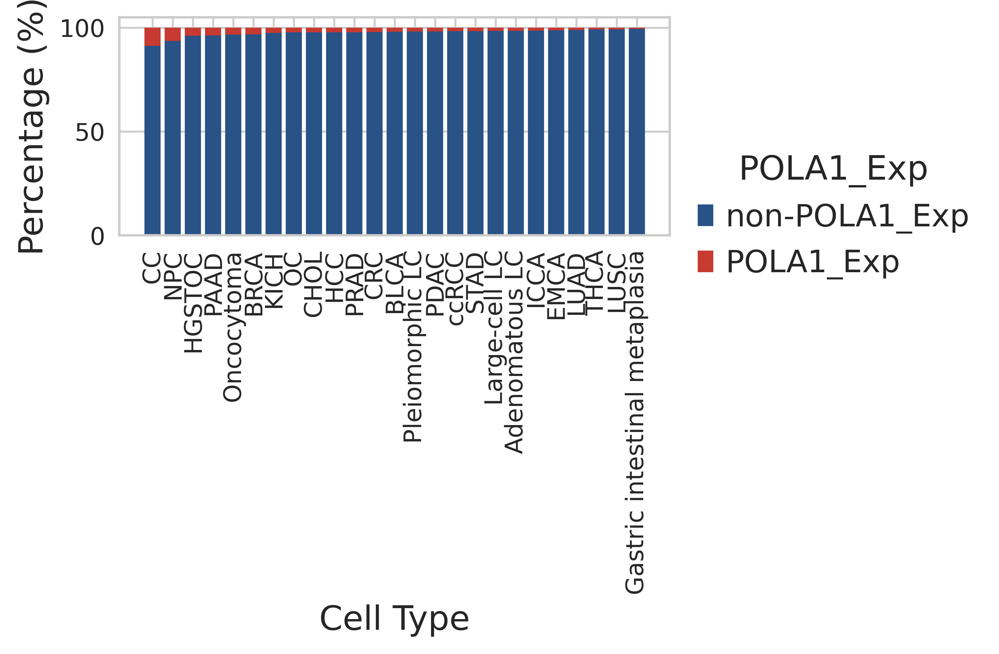

In [52]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set the style
plt.style.use('seaborn-whitegrid')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Figure setup
fig = plt.figure(figsize=(6,4
                         ), facecolor='white')  # Adjusted for better proportionality

counts = pd.crosstab(adata.obs['Cancertype'], adata.obs['POLA1_Exp'])

total = counts.sum(axis=1)
bottom_data_percentage = (counts.get('Fail', np.zeros_like(counts.index)) / total) * 100
top_data_percentage = (counts.get('Pass', np.zeros_like(counts.index)) / total) * 100

# Sort data for better visual comparison
sorted_indices = top_data_percentage.sort_values(ascending=False).index

# Barplot with improved color scheme
plt.bar(sorted_indices, bottom_data_percentage[sorted_indices], color='#295287', label='non-POLA1_Exp')
plt.bar(sorted_indices, top_data_percentage[sorted_indices], bottom=bottom_data_percentage[sorted_indices], color='#c63a32', label='POLA1_Exp')

# Labeling and titling
plt.xlabel('Cell Type')
plt.ylabel('Percentage (%)')
#plt.title('Distribution of LOY Across Gender Groups in Tumor Predictions')

# Legend and ticks
plt.xticks(rotation=90)
plt.legend(title='POLA1_Exp', loc='upper left', bbox_to_anchor=(1, 0.5))  # Adjusted for better visibility

# Layout adjustment
plt.tight_layout()

# Uncomment to save the figure
# plt.savefig('sorted_stacked_bar_chart_percentage.pdf', dpi=300, bbox_inches='tight')
plt.show()


/tmp/ipykernel_131427/2350251740.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

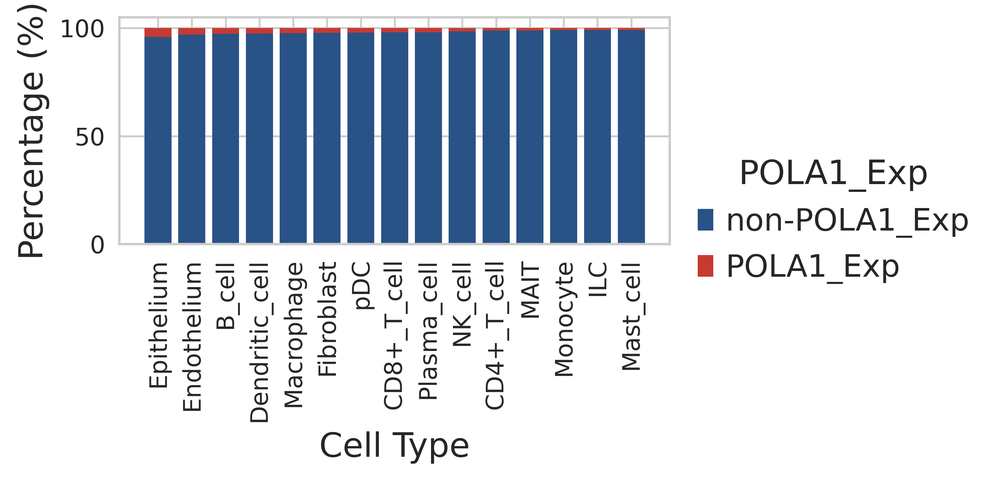

In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set the style
plt.style.use('seaborn-whitegrid')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Figure setup
fig = plt.figure(figsize=(6,3
                         ), facecolor='white')  # Adjusted for better proportionality

counts = pd.crosstab(adata.obs['Celltype2'], adata.obs['POLA1_Exp'])

total = counts.sum(axis=1)
bottom_data_percentage = (counts.get('Fail', np.zeros_like(counts.index)) / total) * 100
top_data_percentage = (counts.get('Pass', np.zeros_like(counts.index)) / total) * 100

# Sort data for better visual comparison
sorted_indices = top_data_percentage.sort_values(ascending=False).index

# Barplot with improved color scheme
plt.bar(sorted_indices, bottom_data_percentage[sorted_indices], color='#295287', label='non-POLA1_Exp')
plt.bar(sorted_indices, top_data_percentage[sorted_indices], bottom=bottom_data_percentage[sorted_indices], color='#c63a32', label='POLA1_Exp')

# Labeling and titling
plt.xlabel('Cell Type')
plt.ylabel('Percentage (%)')
#plt.title('Distribution of LOY Across Gender Groups in Tumor Predictions')

# Legend and ticks
plt.xticks(rotation=90)
plt.legend(title='POLA1_Exp', loc='upper left', bbox_to_anchor=(1, 0.5))  # Adjusted for better visibility

# Layout adjustment
plt.tight_layout()

# Uncomment to save the figure
# plt.savefig('sorted_stacked_bar_chart_percentage.pdf', dpi=300, bbox_inches='tight')
plt.show()


/tmp/ipykernel_131427/1230351187.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

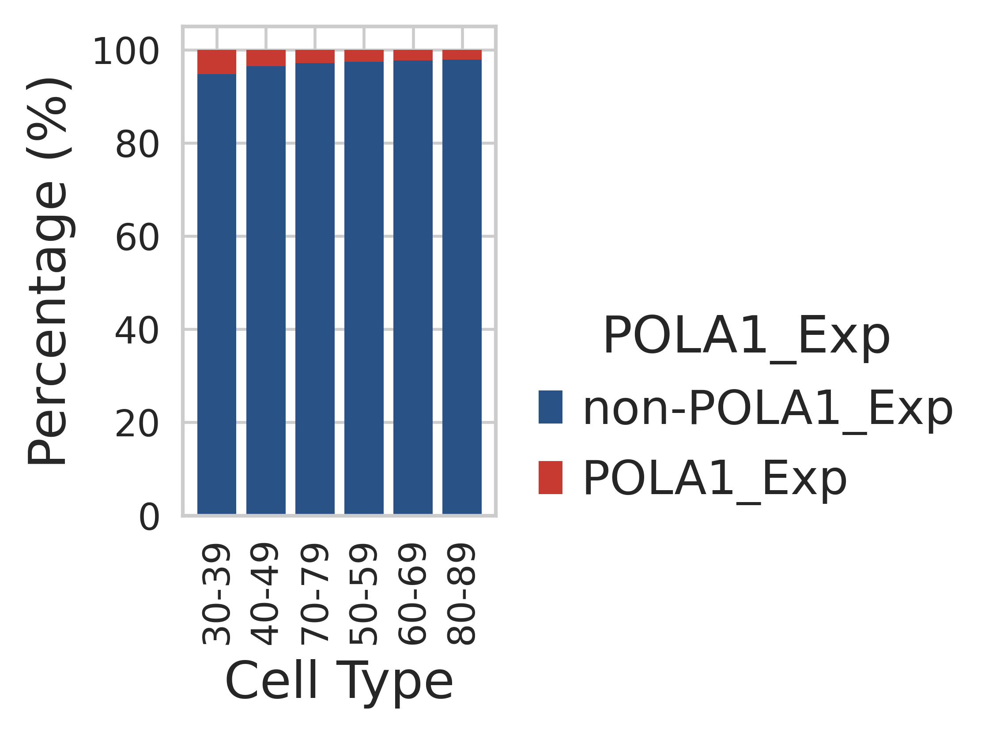

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set the style
plt.style.use('seaborn-whitegrid')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Figure setup
fig = plt.figure(figsize=(4
                          ,3
                         ), facecolor='white')  # Adjusted for better proportionality

counts = pd.crosstab(adata.obs['Age_group'], adata.obs['POLA1_Exp'])

total = counts.sum(axis=1)
bottom_data_percentage = (counts.get('Fail', np.zeros_like(counts.index)) / total) * 100
top_data_percentage = (counts.get('Pass', np.zeros_like(counts.index)) / total) * 100

# Sort data for better visual comparison
sorted_indices = top_data_percentage.sort_values(ascending=False).index

# Barplot with improved color scheme
plt.bar(sorted_indices, bottom_data_percentage[sorted_indices], color='#295287', label='non-POLA1_Exp')
plt.bar(sorted_indices, top_data_percentage[sorted_indices], bottom=bottom_data_percentage[sorted_indices], color='#c63a32', label='POLA1_Exp')

# Labeling and titling
plt.xlabel('Cell Type')
plt.ylabel('Percentage (%)')
#plt.title('Distribution of LOY Across Gender Groups in Tumor Predictions')

# Legend and ticks
plt.xticks(rotation=90)
plt.legend(title='POLA1_Exp', loc='upper left', bbox_to_anchor=(1, 0.5))  # Adjusted for better visibility

# Layout adjustment
plt.tight_layout()

# Uncomment to save the figure
# plt.savefig('sorted_stacked_bar_chart_percentage.pdf', dpi=300, bbox_inches='tight')
plt.show()


/tmp/ipykernel_131427/1244545357.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: 

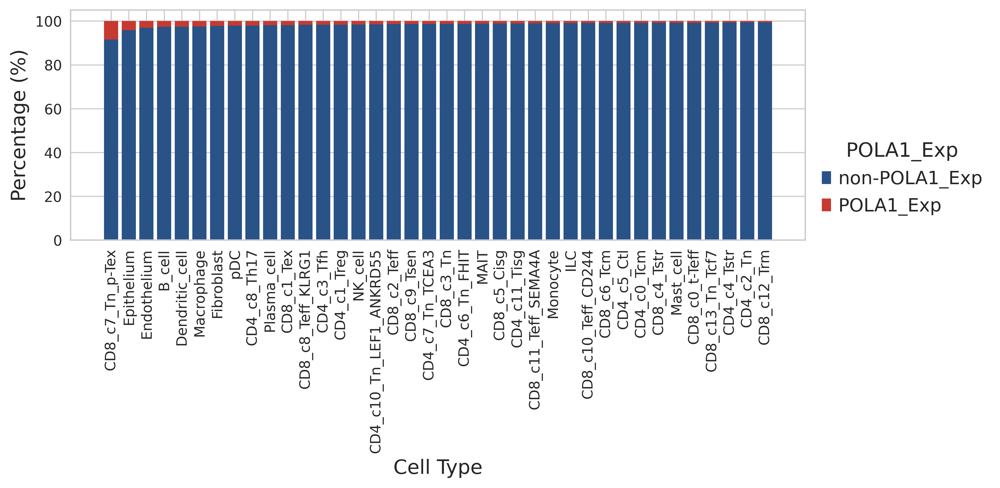

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Set the style
plt.style.use('seaborn-whitegrid')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Figure setup
fig = plt.figure(figsize=(10,5), facecolor='white')  # Adjusted for better proportionality

counts = pd.crosstab(adata.obs['Celltype3'], adata.obs['POLA1_Exp'])

total = counts.sum(axis=1)
bottom_data_percentage = (counts.get('Fail', np.zeros_like(counts.index)) / total) * 100
top_data_percentage = (counts.get('Pass', np.zeros_like(counts.index)) / total) * 100

# Sort data for better visual comparison
sorted_indices = top_data_percentage.sort_values(ascending=False).index

# Barplot with improved color scheme
plt.bar(sorted_indices, bottom_data_percentage[sorted_indices], color='#295287', label='non-POLA1_Exp')
plt.bar(sorted_indices, top_data_percentage[sorted_indices], bottom=bottom_data_percentage[sorted_indices], color='#c63a32', label='POLA1_Exp')

# Labeling and titling
plt.xlabel('Cell Type')
plt.ylabel('Percentage (%)')
#plt.title('Distribution of LOY Across Gender Groups in Tumor Predictions')

# Legend and ticks
plt.xticks(rotation=90)
plt.legend(title='POLA1_Exp', loc='upper left', bbox_to_anchor=(1, 0.5))  # Adjusted for better visibility

# Layout adjustment
plt.tight_layout()

# Uncomment to save the figure
# plt.savefig('sorted_stacked_bar_chart_percentage.pdf', dpi=300, bbox_inches='tight')
plt.show()

Min: 0.01, Max: 1.00, Low Threshold: 0.34, Medium Threshold: 0.67


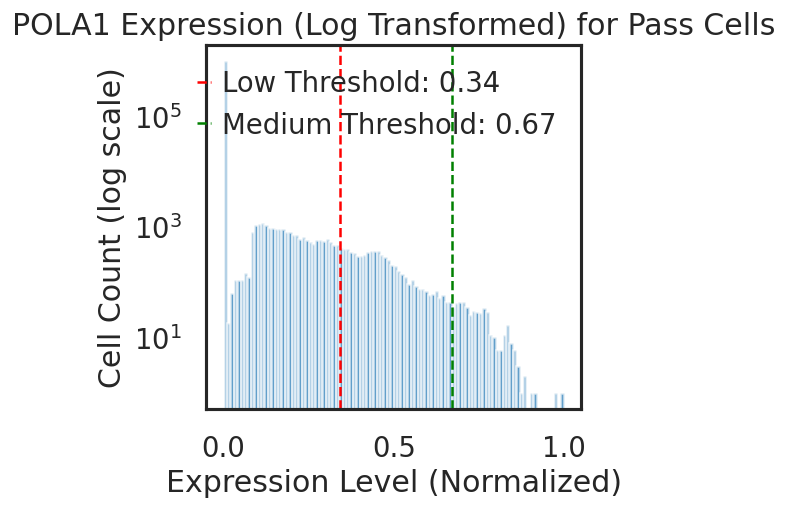

In [74]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from matplotlib import rcParams
import pandas as pd

# 设置绘图参数
rcParams['figure.dpi'] = 60

f1 = 'POLA1'
v1 = adata[:, f1].X.toarray().flatten()  # 将稀疏矩阵转换为密集矩阵并 flatten 成 1D 数组
v1 = MinMaxScaler().fit_transform(v1.reshape(-1, 1)).flatten()  # 归一化，并确保是1D数组

# 生成 'Pass' 或 'Fail' 列，表达量大于 0 的为 'Pass'，否则为 'Fail'
dapi_filter = v1 > 0  # 过滤出表达量大于 0 的细胞
dapi_pass = np.full(adata.shape[0], 'Pass', dtype=object)  # 默认所有细胞都为 'Pass'
dapi_pass[~dapi_filter] = 'Fail'  # 将不符合条件的细胞标记为 'Fail'
adata.obs['POLA1_Exp'] = pd.Categorical(dapi_pass)

# 计算表达量大于0的细胞的最小值和最大值
v1_pass = v1[dapi_filter]  # 仅选择 'Pass' 细胞的数据
min_val, max_val = np.min(v1_pass), np.max(v1_pass)  # 最小值和最大值
range_val = max_val - min_val  # 表达量范围

# 将范围分为三等份
low_threshold = min_val + range_val / 3
medium_threshold = min_val + 2 * range_val / 3

print(f"Min: {min_val:.2f}, Max: {max_val:.2f}, Low Threshold: {low_threshold:.2f}, Medium Threshold: {medium_threshold:.2f}")

# 根据三等份的阈值将所有细胞表达量分成四组：Non (Fail), Low, Medium, High
v1_exp1 = np.full(adata.shape[0], 'Non', dtype=object)  # 默认所有细胞为 'Non'
v1_exp1[(v1 > 0) & (v1 <= low_threshold)] = 'Low'  # 0 < 表达量 <= Low Threshold 的为 'Low'
v1_exp1[(v1 > low_threshold) & (v1 <= medium_threshold)] = 'Medium'  # Low Threshold < 表达量 <= Medium Threshold 的为 'Medium'
v1_exp1[v1 > medium_threshold] = 'High'  # Medium Threshold < 表达量 <= Max 的为 'High'

# 将结果保存到 obs 的 'ZNF148_Exp1' 列中
adata.obs['POLA1_Exp1'] = pd.Categorical(v1_exp1)

# 绘制分位点直方图
plt.figure()
plt.hist(v1, bins=100, log=True, alpha=0.7)  # 只绘制 'Pass' 细胞的表达量
plt.axvline(low_threshold, color='r', linestyle='dashed', linewidth=1.5, label=f'Low Threshold: {low_threshold:.2f}')
plt.axvline(medium_threshold, color='g', linestyle='dashed', linewidth=1.5, label=f'Medium Threshold: {medium_threshold:.2f}')
plt.legend()
plt.title(f'POLA1 Expression (Log Transformed) for Pass Cells')
plt.xlabel('Expression Level (Normalized)')
plt.ylabel('Cell Count (log scale)')
plt.show()

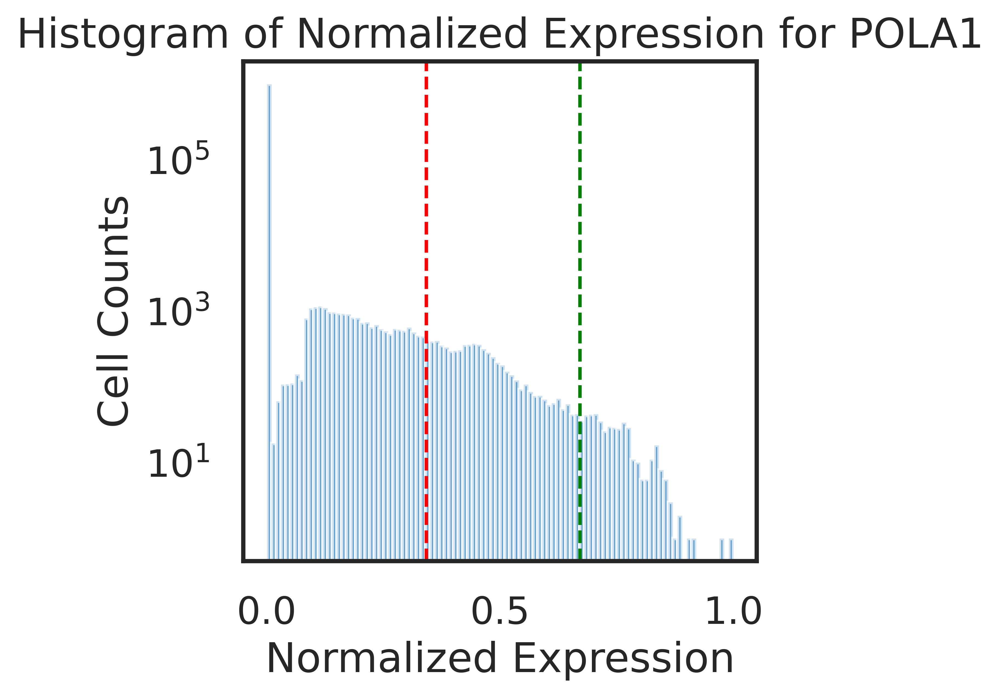

In [99]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from matplotlib import rcParams

# Set the resolution of the plot
rcParams['figure.dpi'] = 300

# Create a histogram of the normalized data
plt.hist(v1, bins=100, log=True, alpha=0.7) 
plt.axvline(low_threshold, color='r', linestyle='dashed', linewidth=1.5, label=f'Low Threshold: {low_threshold:.2f}')
plt.axvline(medium_threshold, color='g', linestyle='dashed', linewidth=1.5, label=f'Medium Threshold: {medium_threshold:.2f}')
plt.title(f'Histogram of Normalized Expression for {gene_label}')
plt.xlabel('Normalized Expression')
plt.ylabel('Cell Counts')
plt.show()

findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found because none of the following families were found: Times New Roman
findfont: Generic family 'serif' not found becau

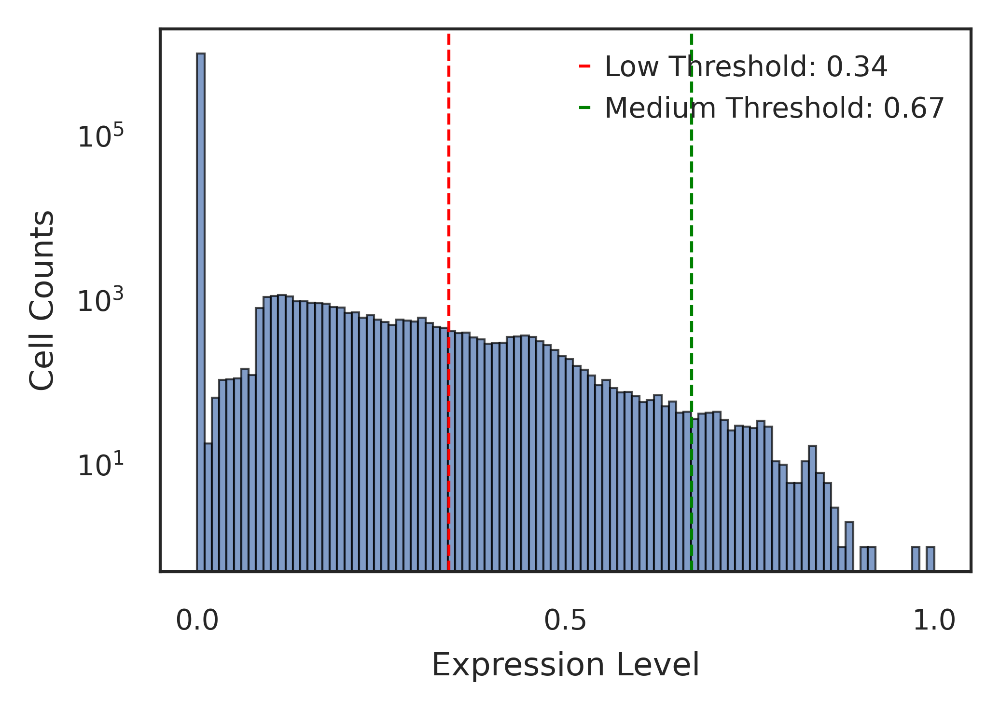

In [100]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import rcParams

# Setting parameters to match Nature journal style
rcParams['figure.dpi'] = 300
rcParams['font.family'] = 'serif'
rcParams['font.size'] = 8  # Nature uses smaller fonts
rcParams['axes.linewidth'] = 0.75  # Thinner lines for axes
rcParams['xtick.major.width'] = 0.75
rcParams['ytick.major.width'] = 0.75
rcParams['xtick.major.size'] = 3
rcParams['ytick.major.size'] = 3

# Generate the figure
plt.figure(figsize=(3.5, 2.5))  # Smaller figure dimensions to resemble typical Nature plot sizes
plt.hist(v1, bins=100, log=True, alpha=0.7, color='#4C72B0', edgecolor='black', linewidth=0.5)  # Subtle color

# Add vertical lines for thresholds
plt.axvline(low_threshold, color='r', linestyle='dashed', linewidth=0.75, label=f'Low Threshold: {low_threshold:.2f}')
plt.axvline(medium_threshold, color='g', linestyle='dashed', linewidth=0.75, label=f'Medium Threshold: {medium_threshold:.2f}')

# Adjust legend
plt.legend(frameon=False, fontsize=7, loc='upper right')

# Labels for axes
plt.xlabel('Expression Level', fontsize=8)
plt.ylabel('Cell Counts', fontsize=8)

# Adjust ticks
plt.xticks(fontsize=7)
plt.yticks(fontsize=7)

# Show plot
plt.tight_layout()
plt.show()
 

In [75]:
adata.obs['POLA1_Exp1'].value_counts()

POLA1_Exp1
Non       1003248
Low         20483
Medium       6779
High          458
Name: count, dtype: int64

In [76]:
adata.obs['POLA1_Exp1_Celltype_new2'] = adata.obs['POLA1_Exp1'].astype('str')+'_'+adata.obs['Celltype2'].astype('str')
adata.obs['POLA1_Exp1_Celltype_new2'].unique()

array(['Non_Endothelium', 'Non_Fibroblast', 'Low_Fibroblast',
       'Non_Epithelium', 'Non_Plasma_cell', 'Non_B_cell',
       'Low_Plasma_cell', 'Low_B_cell', 'Low_Epithelium', 'Medium_B_cell',
       'Non_pDC', 'Non_CD8+_T_cell', 'Low_CD8+_T_cell', 'Low_pDC',
       'Non_Dendritic_cell', 'Non_CD4+_T_cell', 'Medium_Plasma_cell',
       'Non_Mast_cell', 'Non_Macrophage', 'Low_Dendritic_cell',
       'Low_CD4+_T_cell', 'Medium_Epithelium', 'Non_NK_cell', 'Non_ILC',
       'Medium_CD4+_T_cell', 'Low_MAIT', 'Medium_CD8+_T_cell',
       'Low_NK_cell', 'Low_Macrophage', 'Non_MAIT', 'Medium_NK_cell',
       'Low_Mast_cell', 'Non_Monocyte', 'Medium_Macrophage',
       'Low_Monocyte', 'Medium_pDC', 'High_CD4+_T_cell',
       'High_CD8+_T_cell', 'Medium_MAIT', 'High_NK_cell',
       'Medium_Endothelium', 'High_Endothelium', 'Low_Endothelium',
       'Medium_Fibroblast', 'Medium_Dendritic_cell', 'Medium_Monocyte',
       'High_Macrophage', 'Medium_Mast_cell', 'High_Epithelium',
       'High_Fibr

In [110]:
adata

AnnData object with n_obs × n_vars = 1030968 × 14090
    obs: 'SampleID', 'DataID', 'Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type', 'DataSampleID', 'celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', '_scvi_batch', '_scvi_labels', 'Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA', 'RL_Prediction_Only9genes', 'LOY', 'Age_group', 'POLA1_Exp', 'POLA1_Exp1', 'POLA1_Exp1_Celltype_new2', 'POLA1_Exp_pass_fail'
    var: 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Cancertype_TCGA_colors', 'Cancertype_colors', 'Celltype1_colors', 'Celltype2_colors', 'Celltype3_colors', 'DataID_colors', 'Organ_colors', 'Sex_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltype_colors', 'hvg', 'neighbors', 'rank_genes_groups', 'umap', 'tissue_type_colors', 'Age_group_colors'
    obsm: 'X_scANVI', 'X

In [111]:
adata.obs['POLA1_Exp1_Pass_fail_Celltype_new'] = adata.obs['POLA1_Exp_pass_fail'].astype('str')+'_'+adata.obs['Celltype2'].astype('str')
adata.obs['POLA1_Exp1_Pass_fail_Celltype_new'].unique()

array(['Fail_Endothelium', 'Fail_Fibroblast', 'Pass_Fibroblast',
       'Fail_Epithelium', 'Fail_Plasma_cell', 'Fail_B_cell',
       'Pass_Plasma_cell', 'Pass_B_cell', 'Pass_Epithelium', 'Fail_pDC',
       'Fail_CD8+_T_cell', 'Pass_CD8+_T_cell', 'Pass_pDC',
       'Fail_Dendritic_cell', 'Fail_CD4+_T_cell', 'Fail_Mast_cell',
       'Fail_Macrophage', 'Pass_Dendritic_cell', 'Pass_CD4+_T_cell',
       'Fail_NK_cell', 'Fail_ILC', 'Pass_MAIT', 'Pass_NK_cell',
       'Pass_Macrophage', 'Fail_MAIT', 'Pass_Mast_cell', 'Fail_Monocyte',
       'Pass_Monocyte', 'Pass_Endothelium', 'Pass_ILC'], dtype=object)

In [ ]:
# 获取 value_counts
value_counts = adata.obs['POLA1_Exp1_Pass_fail_Celltype_new'].value_counts()

# 筛选出大于 100 的值，并转换为列表
filtered_values = value_counts[value_counts > 5].index.tolist()

# 打印结果
print(filtered_values)

# Step 1: Create a dictionary to map cell types with their "High" or "Low" label
celltype_dict = {}

for subtype in filtered_values:
    parts = subtype.split('_', 1)  # Split into "High/Low/Non/Medium" and the celltype part
    label = parts[0]  # High, Low, Non, etc.
    celltype = parts[1]  # CD8_c1_Tex, CD8_c10_Teff_CD244, etc.

    # Add the label to the corresponding cell type in the dictionary
    if celltype not in celltype_dict:
        celltype_dict[celltype] = []
    celltype_dict[celltype].append(label)

# Step 2: Filter cell types that contain both "High" and "Low"
filtered_celltypes = [celltype for celltype, labels in celltype_dict.items() if 'Pass' in labels and 'Fail' in labels]

# Output the filtered cell types
print(filtered_celltypes)
import gseapy as gp
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt  # Import for saving the figure
sns.set_style("white")
sns.set_context("talk")

if 'log1p' in adata.uns and 'base' not in adata.uns['log1p']:
    adata.uns['log1p']['base'] = np.e

Celltypes=filtered_celltypes

for celltype in Celltypes:

    sc.tl.rank_genes_groups(adata, 'POLA1_Exp1_Pass_fail_Celltype_new', groups=[f'Pass_{celltype}'],
                           use_raw=False, reference=f'Fail_{celltype}', method='wilcoxon')
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    pd.DataFrame(    {group + '_' + key[:1]: result[key][group]  for group in groups for key in ['names', 'pvals']}).head(5)
    res = pd.DataFrame(    {group + '_' + key: result[key][group]  for group in groups for key in ['names', 'pvals','logfoldchanges','pvals_adj','scores']})
    res.to_csv(f"/common/chenx6/public/FFY/POLA/Diff_human_pancancer/DEff_PassPOLA1_FailPOLA1_{celltype}_difference.csv") 


['Fail_Epithelium', 'Fail_CD8+_T_cell', 'Fail_CD4+_T_cell', 'Fail_Fibroblast', 'Fail_Macrophage', 'Fail_NK_cell', 'Fail_Endothelium', 'Fail_B_cell', 'Fail_Monocyte', 'Fail_Plasma_cell', 'Pass_Epithelium', 'Fail_Dendritic_cell', 'Fail_Mast_cell', 'Pass_CD8+_T_cell', 'Fail_MAIT', 'Pass_Macrophage', 'Fail_pDC', 'Pass_Fibroblast', 'Pass_Endothelium', 'Pass_CD4+_T_cell', 'Fail_ILC', 'Pass_B_cell', 'Pass_NK_cell', 'Pass_Dendritic_cell', 'Pass_Plasma_cell', 'Pass_Monocyte', 'Pass_Mast_cell', 'Pass_pDC', 'Pass_MAIT', 'Pass_ILC']
['Epithelium', 'CD8+_T_cell', 'CD4+_T_cell', 'Fibroblast', 'Macrophage', 'NK_cell', 'Endothelium', 'B_cell', 'Monocyte', 'Plasma_cell', 'Dendritic_cell', 'Mast_cell', 'MAIT', 'pDC', 'ILC']


/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)


In [78]:
# 获取 value_counts
value_counts = adata.obs['POLA1_Exp1_Celltype_new2'].value_counts()

# 筛选出大于 100 的值，并转换为列表
filtered_values = value_counts[value_counts > 5].index.tolist()

# 打印结果
print(filtered_values)

# Step 1: Create a dictionary to map cell types with their "High" or "Low" label
celltype_dict = {}

for subtype in filtered_values:
    parts = subtype.split('_', 1)  # Split into "High/Low/Non/Medium" and the celltype part
    label = parts[0]  # High, Low, Non, etc.
    celltype = parts[1]  # CD8_c1_Tex, CD8_c10_Teff_CD244, etc.

    # Add the label to the corresponding cell type in the dictionary
    if celltype not in celltype_dict:
        celltype_dict[celltype] = []
    celltype_dict[celltype].append(label)

# Step 2: Filter cell types that contain both "High" and "Low"
filtered_celltypes = [celltype for celltype, labels in celltype_dict.items() if 'High' in labels and 'Low' in labels]

# Output the filtered cell types
print(filtered_celltypes)

['Non_Epithelium', 'Non_CD8+_T_cell', 'Non_CD4+_T_cell', 'Non_Fibroblast', 'Non_Macrophage', 'Non_NK_cell', 'Non_Endothelium', 'Non_B_cell', 'Non_Monocyte', 'Non_Plasma_cell', 'Non_Dendritic_cell', 'Low_Epithelium', 'Non_Mast_cell', 'Non_MAIT', 'Medium_CD8+_T_cell', 'Non_pDC', 'Low_Macrophage', 'Low_Fibroblast', 'Medium_Epithelium', 'Low_CD8+_T_cell', 'Low_Endothelium', 'Non_ILC', 'Medium_CD4+_T_cell', 'Low_B_cell', 'Low_CD4+_T_cell', 'Medium_NK_cell', 'Medium_Macrophage', 'Medium_Fibroblast', 'Medium_Endothelium', 'Low_Dendritic_cell', 'Low_Plasma_cell', 'Medium_B_cell', 'Low_NK_cell', 'High_Epithelium', 'High_CD8+_T_cell', 'Low_Monocyte', 'Medium_Monocyte', 'Medium_Dendritic_cell', 'Medium_Mast_cell', 'Low_pDC', 'High_CD4+_T_cell', 'Medium_Plasma_cell', 'Low_Mast_cell', 'High_Fibroblast', 'High_Endothelium', 'High_NK_cell', 'Low_MAIT', 'High_Macrophage', 'Medium_MAIT', 'Medium_pDC', 'High_B_cell', 'High_Monocyte', 'High_Mast_cell']
['Epithelium', 'CD8+_T_cell', 'CD4+_T_cell', 'Fibrob

In [67]:
pwd

'/common/chenx6/public/FFY/POLA'

In [79]:
import gseapy as gp
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt  # Import for saving the figure
sns.set_style("white")
sns.set_context("talk")

if 'log1p' in adata.uns and 'base' not in adata.uns['log1p']:
    adata.uns['log1p']['base'] = np.e

Celltypes=filtered_celltypes

for celltype in Celltypes:

    sc.tl.rank_genes_groups(adata, 'POLA1_Exp1_Celltype_new2', groups=[f'High_{celltype}'],
                           use_raw=False, reference=f'Medium_{celltype}', method='wilcoxon')
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    pd.DataFrame(    {group + '_' + key[:1]: result[key][group]  for group in groups for key in ['names', 'pvals']}).head(5)
    res = pd.DataFrame(    {group + '_' + key: result[key][group]  for group in groups for key in ['names', 'pvals','logfoldchanges','pvals_adj','scores']})
    res.to_csv(f"/common/chenx6/public/FFY/POLA/Diff_human_pancancer/DEff_HighPOLA1_MediumPOLA1_{celltype}_difference.csv") 


/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.s

In [80]:
# 获取 value_counts
value_counts = adata.obs['POLA1_Exp1_Celltype_new2'].value_counts()

# 筛选出大于 100 的值，并转换为列表
filtered_values = value_counts[value_counts > 5].index.tolist()

# 打印结果
print(filtered_values)

# Step 1: Create a dictionary to map cell types with their "High" or "Low" label
celltype_dict = {}

for subtype in filtered_values:
    parts = subtype.split('_', 1)  # Split into "High/Low/Non/Medium" and the celltype part
    label = parts[0]  # High, Low, Non, etc.
    celltype = parts[1]  # CD8_c1_Tex, CD8_c10_Teff_CD244, etc.

    # Add the label to the corresponding cell type in the dictionary
    if celltype not in celltype_dict:
        celltype_dict[celltype] = []
    celltype_dict[celltype].append(label)

# Step 2: Filter cell types that contain both "High" and "Low"
filtered_celltypes = [celltype for celltype, labels in celltype_dict.items() if 'High' in labels and 'Low' in labels]

# Output the filtered cell types
print(filtered_celltypes)

['Non_Epithelium', 'Non_CD8+_T_cell', 'Non_CD4+_T_cell', 'Non_Fibroblast', 'Non_Macrophage', 'Non_NK_cell', 'Non_Endothelium', 'Non_B_cell', 'Non_Monocyte', 'Non_Plasma_cell', 'Non_Dendritic_cell', 'Low_Epithelium', 'Non_Mast_cell', 'Non_MAIT', 'Medium_CD8+_T_cell', 'Non_pDC', 'Low_Macrophage', 'Low_Fibroblast', 'Medium_Epithelium', 'Low_CD8+_T_cell', 'Low_Endothelium', 'Non_ILC', 'Medium_CD4+_T_cell', 'Low_B_cell', 'Low_CD4+_T_cell', 'Medium_NK_cell', 'Medium_Macrophage', 'Medium_Fibroblast', 'Medium_Endothelium', 'Low_Dendritic_cell', 'Low_Plasma_cell', 'Medium_B_cell', 'Low_NK_cell', 'High_Epithelium', 'High_CD8+_T_cell', 'Low_Monocyte', 'Medium_Monocyte', 'Medium_Dendritic_cell', 'Medium_Mast_cell', 'Low_pDC', 'High_CD4+_T_cell', 'Medium_Plasma_cell', 'High_Fibroblast', 'Low_Mast_cell', 'High_Endothelium', 'High_NK_cell', 'Low_MAIT', 'High_Macrophage', 'Medium_MAIT', 'Medium_pDC', 'High_B_cell', 'High_Monocyte', 'High_Mast_cell']
['Epithelium', 'CD8+_T_cell', 'CD4+_T_cell', 'Fibrob

In [81]:
import gseapy as gp
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt  # Import for saving the figure
sns.set_style("white")
sns.set_context("talk")

if 'log1p' in adata.uns and 'base' not in adata.uns['log1p']:
    adata.uns['log1p']['base'] = np.e

Celltypes=filtered_celltypes

for celltype in Celltypes:

    sc.tl.rank_genes_groups(adata, 'POLA1_Exp1_Celltype_new2', groups=[f'High_{celltype}'],
                           use_raw=False, reference=f'Low_{celltype}', method='wilcoxon')
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    pd.DataFrame(    {group + '_' + key[:1]: result[key][group]  for group in groups for key in ['names', 'pvals']}).head(5)
    res = pd.DataFrame(    {group + '_' + key: result[key][group]  for group in groups for key in ['names', 'pvals','logfoldchanges','pvals_adj','scores']})
    res.to_csv(f"/common/chenx6/public/FFY/POLA/Diff_human_pancancer/DEff_HighPOLA1_LowPOLA1_{celltype}_difference.csv") 


/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.s

In [104]:
# 获取 value_counts
value_counts = adata.obs['POLA1_Exp1_Celltype_new2'].value_counts()

# 筛选出大于 100 的值，并转换为列表
filtered_values = value_counts[value_counts > 5].index.tolist()

# 打印结果
print(filtered_values)

# Step 1: Create a dictionary to map cell types with their "High" or "Low" label
celltype_dict = {}

for subtype in filtered_values:
    parts = subtype.split('_', 1)  # Split into "High/Low/Non/Medium" and the celltype part
    label = parts[0]  # High, Low, Non, etc.
    celltype = parts[1]  # CD8_c1_Tex, CD8_c10_Teff_CD244, etc.

    # Add the label to the corresponding cell type in the dictionary
    if celltype not in celltype_dict:
        celltype_dict[celltype] = []
    celltype_dict[celltype].append(label)

# Step 2: Filter cell types that contain both "High" and "Low"
filtered_celltypes = [celltype for celltype, labels in celltype_dict.items() if 'Medium' in labels and 'Low' in labels]

# Output the filtered cell types
print(filtered_celltypes)

['Non_Epithelium', 'Non_CD8+_T_cell', 'Non_CD4+_T_cell', 'Non_Fibroblast', 'Non_Macrophage', 'Non_NK_cell', 'Non_Endothelium', 'Non_B_cell', 'Non_Monocyte', 'Non_Plasma_cell', 'Non_Dendritic_cell', 'Low_Epithelium', 'Non_Mast_cell', 'Non_MAIT', 'Medium_CD8+_T_cell', 'Non_pDC', 'Low_Macrophage', 'Low_Fibroblast', 'Medium_Epithelium', 'Low_CD8+_T_cell', 'Low_Endothelium', 'Non_ILC', 'Medium_CD4+_T_cell', 'Low_B_cell', 'Low_CD4+_T_cell', 'Medium_NK_cell', 'Medium_Macrophage', 'Medium_Fibroblast', 'Medium_Endothelium', 'Low_Dendritic_cell', 'Low_Plasma_cell', 'Medium_B_cell', 'Low_NK_cell', 'High_Epithelium', 'High_CD8+_T_cell', 'Low_Monocyte', 'Medium_Monocyte', 'Medium_Dendritic_cell', 'Medium_Mast_cell', 'Low_pDC', 'High_CD4+_T_cell', 'Medium_Plasma_cell', 'High_Fibroblast', 'Low_Mast_cell', 'High_Endothelium', 'High_NK_cell', 'Low_MAIT', 'High_Macrophage', 'Medium_MAIT', 'Medium_pDC', 'High_B_cell', 'High_Monocyte', 'High_Mast_cell']
['Epithelium', 'CD8+_T_cell', 'CD4+_T_cell', 'Fibrob

In [106]:

import gseapy as gp
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt  # Import for saving the figure
sns.set_style("white")
sns.set_context("talk")

if 'log1p' in adata.uns and 'base' not in adata.uns['log1p']:
    adata.uns['log1p']['base'] = np.e

Celltypes=filtered_celltypes

for celltype in Celltypes:

    sc.tl.rank_genes_groups(adata, 'POLA1_Exp1_Celltype_new2', groups=[f'Medium_{celltype}'],
                           use_raw=False, reference=f'Low_{celltype}', method='wilcoxon')
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    pd.DataFrame(    {group + '_' + key[:1]: result[key][group]  for group in groups for key in ['names', 'pvals']}).head(5)
    res = pd.DataFrame(    {group + '_' + key: result[key][group]  for group in groups for key in ['names', 'pvals','logfoldchanges','pvals_adj','scores']})
    res.to_csv(f"/common/chenx6/public/FFY/POLA/Diff_human_pancancer/DEff_Medium_POLA1_LowPOLA1_{celltype}_difference.csv") 


/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
/home/chenx6/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.s

In [124]:
Pathway_list = [
    #Proliferation
    'Cell cycle','Cell.Cycle_activated','DNA replication','Tumor proliferation rate',
    'Hippo_activated','NOTCH_activated','MAPK Signaling',
    'HALLMARK_MITOTIC_SPINDLE','HALLMARK_NOTCH_SIGNALING', 'HALLMARK_PI3K_AKT_MTOR_SIGNALING',
    'HALLMARK_MTORC1_SIGNALING', 'HALLMARK_G2M_CHECKPOINT','HALLMARK_E2F_TARGETS',
    #Genomic instability
    'Base excision repair', 'Nucleotide excision repair','Homologous recombination',
    'Mismatch Repair', 'HALLMARK_P53_PATHWAY', 
    #Hormone
    'HALLMARK_ESTROGEN_RESPONSE_LATE', 'HALLMARK_ESTROGEN_RESPONSE_EARLY', 'HALLMARK_ANDROGEN_RESPONSE', 
    #Oncogenesis
    'MYC_activated','RAS_activated','NFKB Signaling', 'TGF-B_activated', 
    'HALLMARK_TGF_BETA_SIGNALING', 'HALLMARK_TNFA_SIGNALING_VIA_NFKB','HALLMARK_KRAS_SIGNALING_UP',
    #Metabolism
    'HALLMARK_HYPOXIA', 'HALLMARK_GLYCOLYSIS', 
]

In [116]:
geneset_df = pd.read_csv('/common/chenx6/public/IMvigor210HumanGeneset.csv', 
                         encoding='ISO-8859-1',index_col=0)

geneset_df = geneset_df.loc[:,list(set(geneset_df.columns).intersection(Pathways))].copy()
geneset_df

,Homologous recombination,TGF-B_activated,Cell cycle,Hippo_activated,NFKB Signaling,MYC_activated,Tumor proliferation rate,NOTCH_activated,Mismatch Repair,DNA replication,Nucleotide excision repair,Base excision repair,MAPK Signaling,RAS_activated,Cell.Cycle_activated
1,RAD50,TGFBR1,CDK2,YAP1,NFKB1,MYC,MKI67,CREBBP,POLD3,RNASEH2A,CDK7,PARP2,MAP2K1,ABL1,CCND1
2,POLD3,TGFBR2,CDK4,TEAD1,NFKB2,MYCL1,ESCO2,EP300,MLH3,POLD3,CETN2,PARP3,MAP2K2,EGFR,CCND2
3,EME1,ACVR2A,CDK6,TEAD2,NFKBIA,MYCN,CETN3,HES1,MSH6,DNA2,POLD3,POLD3,MAP2K3,ERBB2,CCND3
4,RAD54B,ACVR1B,CDK7,TEAD3,NFKBIB,NaN,CDK2,HES2,RPA4,FEN1,ERCC8,PARP1,MAP3K4,ERBB3,CCNE1
5,RPA4,SMAD2,CDKN1A,TEAD4,NFKBIZ,NaN,CCND1,HES3,LIG1,POLA2,DDB1,PARP4,MAP3K5,ERBB4,CDK2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
164,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
165,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [118]:
#Hallmark pahways

gmt_file_path = "/common/chenx6/public/h.all.v7.2.symbols.gmt"
max_length = 0
gene_sets_H = {}
with open(gmt_file_path, 'r') as gmt_file:
    for line in gmt_file:
        parts = line.strip().split('\t')
        gene_set_name = parts[0]
        gene_list = parts[2:]
        if gene_set_name in Pathways:
            gene_sets_H[gene_set_name] = gene_list
            max_length = max(max_length,len(gene_list))
for gene_set_name in gene_sets_H.keys():
    gene_sets_H[gene_set_name] += ['NaN'] * (max_length - len(gene_sets_H[gene_set_name]))
    
gene_sets_H = pd.DataFrame(gene_sets_H)
gene_sets_H

,HALLMARK_TNFA_SIGNALING_VIA_NFKB,HALLMARK_HYPOXIA,HALLMARK_MITOTIC_SPINDLE,HALLMARK_TGF_BETA_SIGNALING,HALLMARK_G2M_CHECKPOINT,HALLMARK_NOTCH_SIGNALING,HALLMARK_ESTROGEN_RESPONSE_EARLY,HALLMARK_ESTROGEN_RESPONSE_LATE,HALLMARK_ANDROGEN_RESPONSE,HALLMARK_PI3K_AKT_MTOR_SIGNALING,HALLMARK_MTORC1_SIGNALING,HALLMARK_E2F_TARGETS,HALLMARK_GLYCOLYSIS,HALLMARK_P53_PATHWAY,HALLMARK_KRAS_SIGNALING_UP
0,JUNB,PGK1,ARHGEF2,TGFBR1,AURKA,JAG1,GREB1,TFF1,KLK3,MAPK8,FADS1,AURKA,PGK1,CDKN1A,ANGPTL4
1,CXCL2,PDK1,CLASP1,SMAD7,CCNA2,NOTCH3,CA12,SLC9A3R1,KLK2,PIK3R3,DDIT4,BRCA2,ALDOA,BTG2,ITGA2
2,ATF3,GBE1,KIF11,TGFB1,TOP2A,NOTCH2,SLC9A3R1,TPD52L1,ACSL3,GRB2,CALR,CCP110,ENO1,MDM2,SPRY2
3,NFKBIA,PFKL,KIF23,SMURF2,CCNB2,APH1A,MYB,PRSS23,PIAS1,NFKBIB,HK2,CENPE,TPI1,CCNG1,HBEGF
4,TNFAIP3,ALDOA,ALS2,SMURF1,CENPA,HES1,ANXA9,CA12,CAMKK2,MAP2K6,PGK1,CKS2,PFKP,FAS,RBP4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,GFPT2,HOXB9,YWHAE,NaN,MEIS2,NaN,RRP12,PTPN6,NaN,NaN,ABCF2,SYNCRIP,AK3,DNTTIP2,SNAP91
196,KLF2,SELENBP1,RAPGEF5,NaN,PAFAH1B1,NaN,ADCY1,ATP2B4,NaN,NaN,NFYC,EIF2S1,XYLT2,MXD4,EVI5
197,TNC,FOSL2,CEP72,NaN,WRN,NaN,DHCR7,ST6GALNAC2,NaN,NaN,ATP5MC1,LYAR,ARTN,SEC61A1,TNFRSF1B
198,SERPINB8,SULT2B1,CSNK1D,NaN,H2AZ2,NaN,MICB,ADD3,NaN,NaN,PFKL,PAN2,PPIA,HMOX1,GPNMB


In [119]:
geneset = pd.concat([geneset_df,gene_sets_H],axis=1)
geneset
geneset.to_csv('Genelist_for_scRNAseq_pancan_Epithelium.csv')

In [120]:
for path in Pathways:
    # Convert the gene list to a NumPy array
    gene_list = geneset[path].dropna().tolist()
    gene_list = list(set(gene_list).intersection(adata.var_names))
    # Calculate the score using sc.tl.score_genes
    sc.tl.score_genes(
        adata, 
        gene_list, 
        ctrl_size=50, 
        gene_pool=None,
        n_bins=25, 
        score_name=path,  
        random_state=0, 
        copy=False, 
        use_raw=False
    )
adata

AnnData object with n_obs × n_vars = 1030968 × 14090
    obs: 'SampleID', 'DataID', 'Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type', 'DataSampleID', 'celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', '_scvi_batch', '_scvi_labels', 'Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA', 'RL_Prediction_Only9genes', 'LOY', 'Age_group', 'POLA1_Exp', 'POLA1_Exp1', 'POLA1_Exp1_Celltype_new2', 'POLA1_Exp_pass_fail', 'POLA1_Exp1_Pass_fail_Celltype_new', 'Cell cycle', 'Cell.Cycle_activated', 'DNA replication', 'Tumor proliferation rate', 'Hippo_activated', 'NOTCH_activated', 'MAPK Signaling', 'HALLMARK_MITOTIC_SPINDLE', 'HALLMARK_NOTCH_SIGNALING', 'HALLMARK_PI3K_AKT_MTOR_SIGNALING', 'HALLMARK_MTORC1_SIGNALING', 'HALLMARK_G2M_CHECKPOINT', 'HALLMARK_E2F_TARGETS', 'Base excision repair', 'Nucleotide excision repair', 'Homologous recombination', 'Mismatch Repair', 'HALLMARK_P53_PATHWAY', 'HALLMARK_ESTROGEN_RESPONSE_LATE', 'HALL

In [121]:
adata

AnnData object with n_obs × n_vars = 1030968 × 14090
    obs: 'SampleID', 'DataID', 'Age', 'Sex', 'Treatment', 'Organ', 'Cancertype', 'tissue_type', 'DataSampleID', 'celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', '_scvi_batch', '_scvi_labels', 'Celltype1', 'Celltype2', 'Celltype3', 'Cancertype_TCGA', 'RL_Prediction_Only9genes', 'LOY', 'Age_group', 'POLA1_Exp', 'POLA1_Exp1', 'POLA1_Exp1_Celltype_new2', 'POLA1_Exp_pass_fail', 'POLA1_Exp1_Pass_fail_Celltype_new', 'Cell cycle', 'Cell.Cycle_activated', 'DNA replication', 'Tumor proliferation rate', 'Hippo_activated', 'NOTCH_activated', 'MAPK Signaling', 'HALLMARK_MITOTIC_SPINDLE', 'HALLMARK_NOTCH_SIGNALING', 'HALLMARK_PI3K_AKT_MTOR_SIGNALING', 'HALLMARK_MTORC1_SIGNALING', 'HALLMARK_G2M_CHECKPOINT', 'HALLMARK_E2F_TARGETS', 'Base excision repair', 'Nucleotide excision repair', 'Homologous recombination', 'Mismatch Repair', 'HALLMARK_P53_PATHWAY', 'HALLMARK_ESTROGEN_RESPONSE_LATE', 'HALL

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.249e-160 U_stat=4.047e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:5.810e-110 U_stat=8.194e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.707e-46 U_stat=2.859e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.411e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:7.986e-15 U_stat=1.216e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.074e-01 U_stat=2.198e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


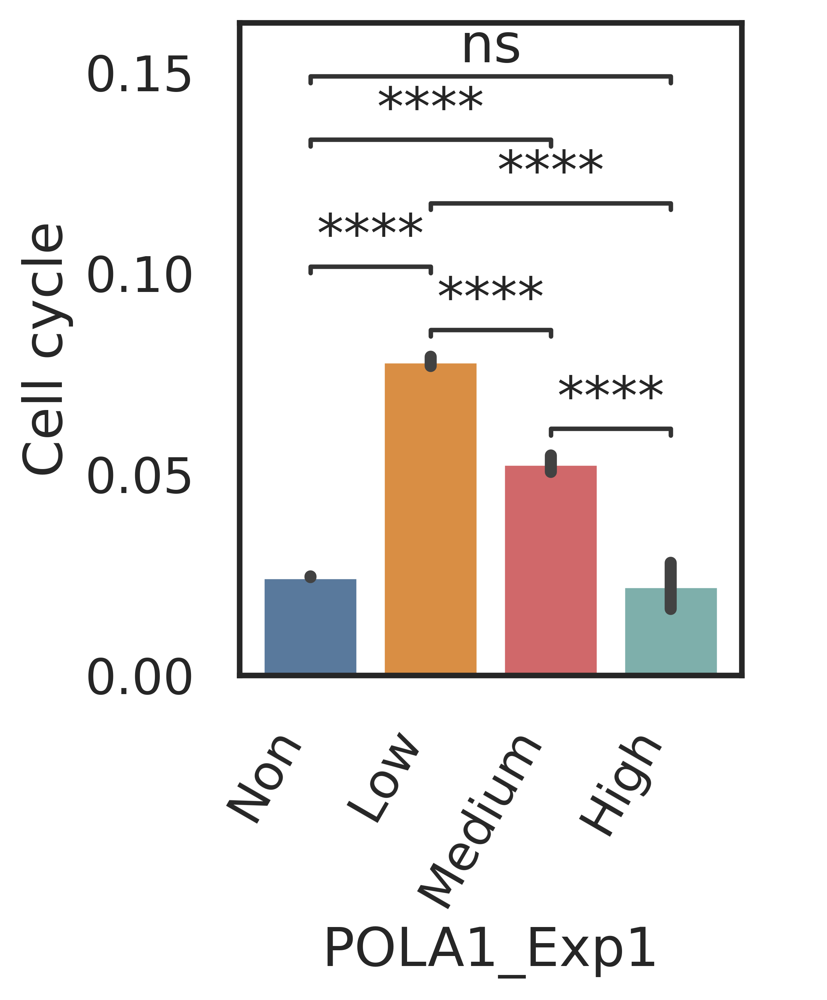

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.627e-30 U_stat=3.673e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:5.019e-01 U_stat=6.905e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:3.343e-02 U_stat=4.418e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.542e-99 U_stat=1.116e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.718e-01 U_stat=1.505e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.003e-01 U_stat=2.399e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


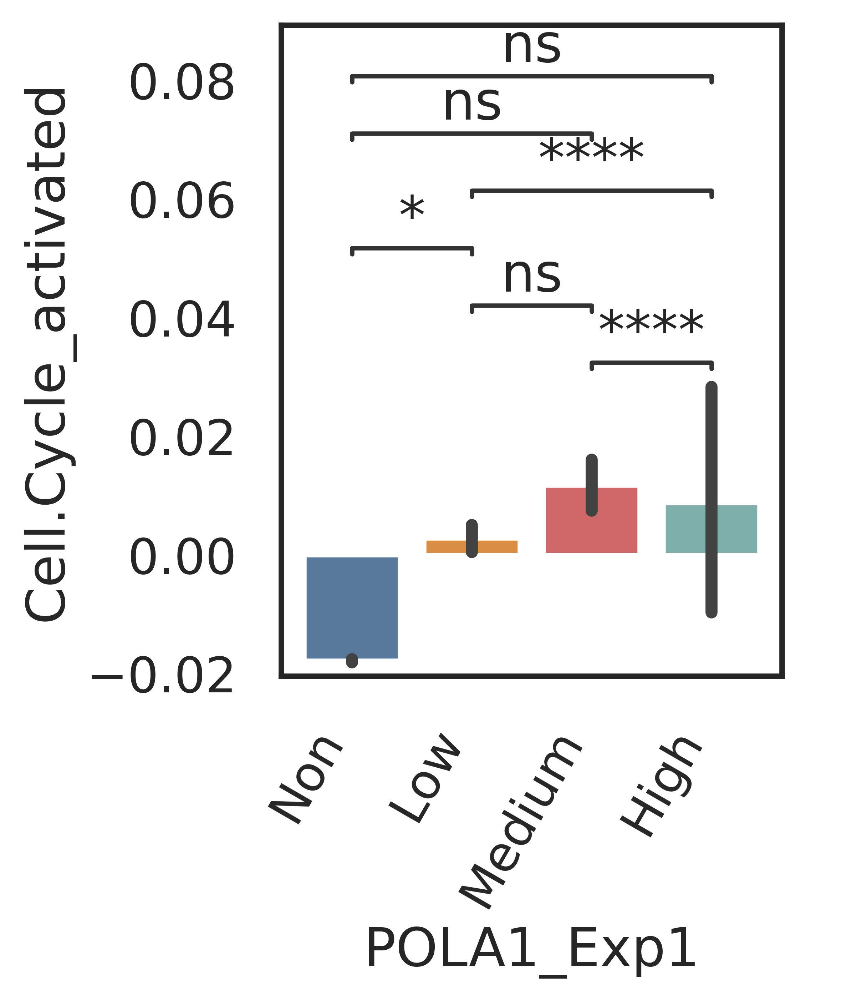

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=4.912e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:9.194e-11 U_stat=6.579e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:4.148e-08 U_stat=5.392e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.380e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.332e-05 U_stat=1.741e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:6.093e-111 U_stat=3.685e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


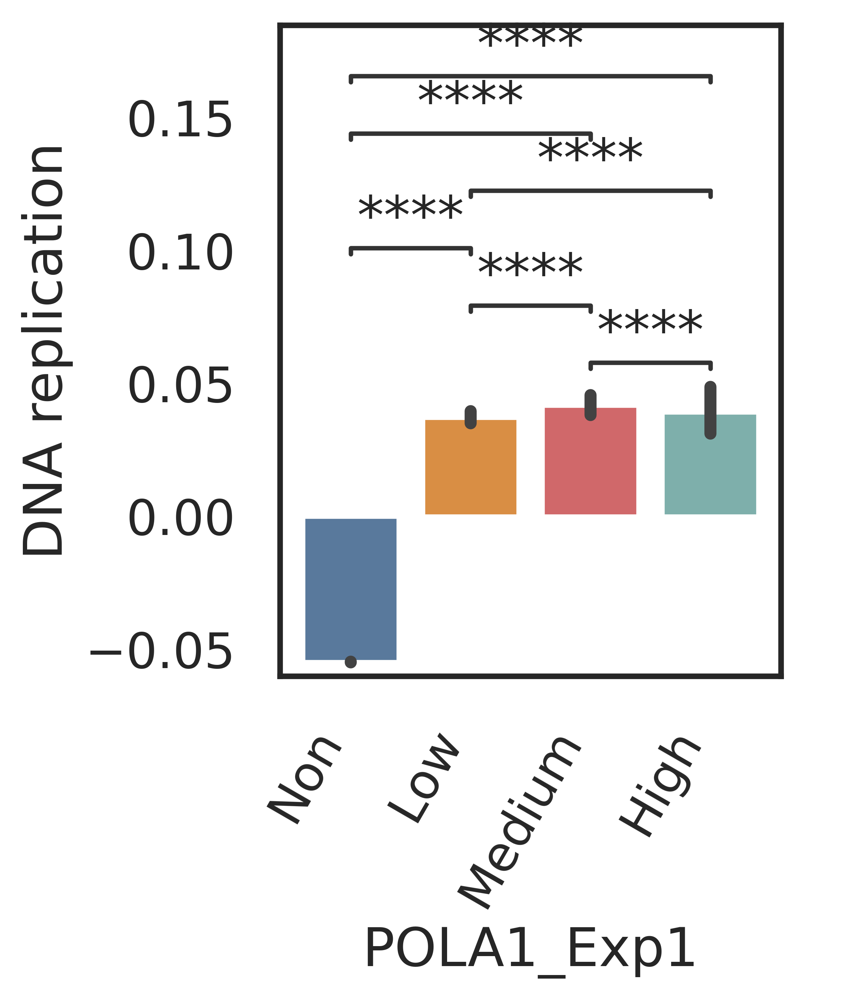

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:6.348e-03 U_stat=3.335e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.625e-120 U_stat=8.253e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:9.798e-10 U_stat=3.908e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.258e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.313e-05 U_stat=1.741e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.666e-03 U_stat=2.469e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


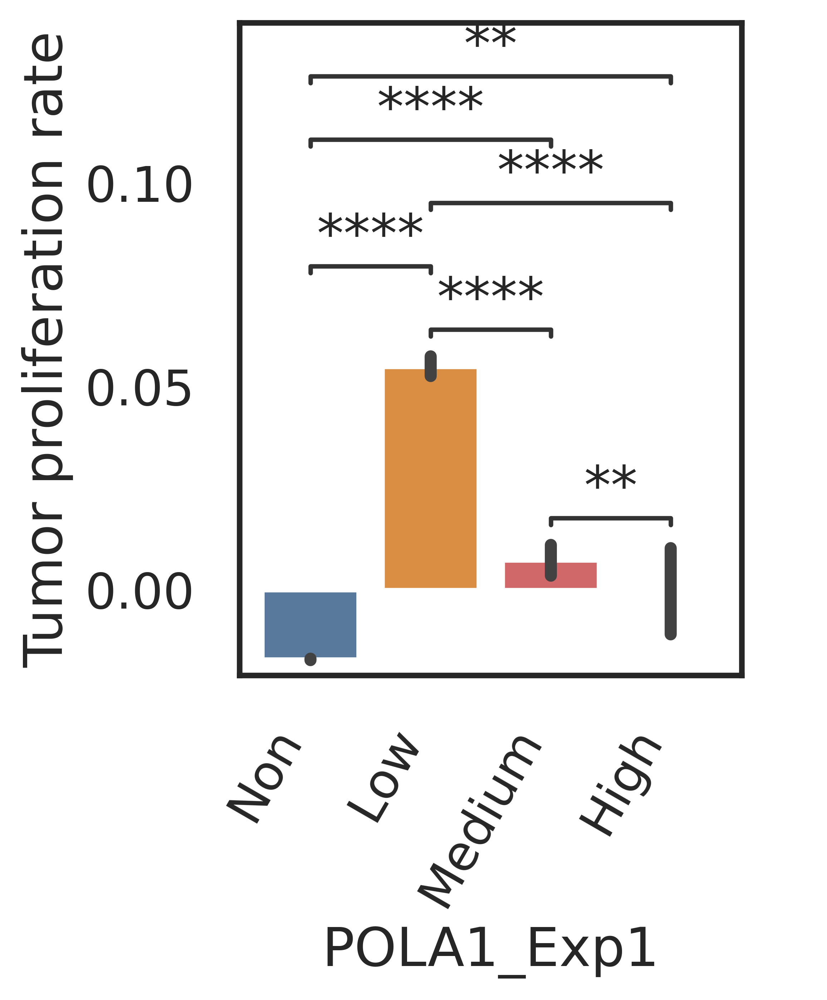

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:9.123e-198 U_stat=2.683e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:9.754e-199 U_stat=8.632e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:4.970e-06 U_stat=4.106e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.884e-187 U_stat=1.150e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.470e-30 U_stat=2.050e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.071e-02 U_stat=2.441e+08


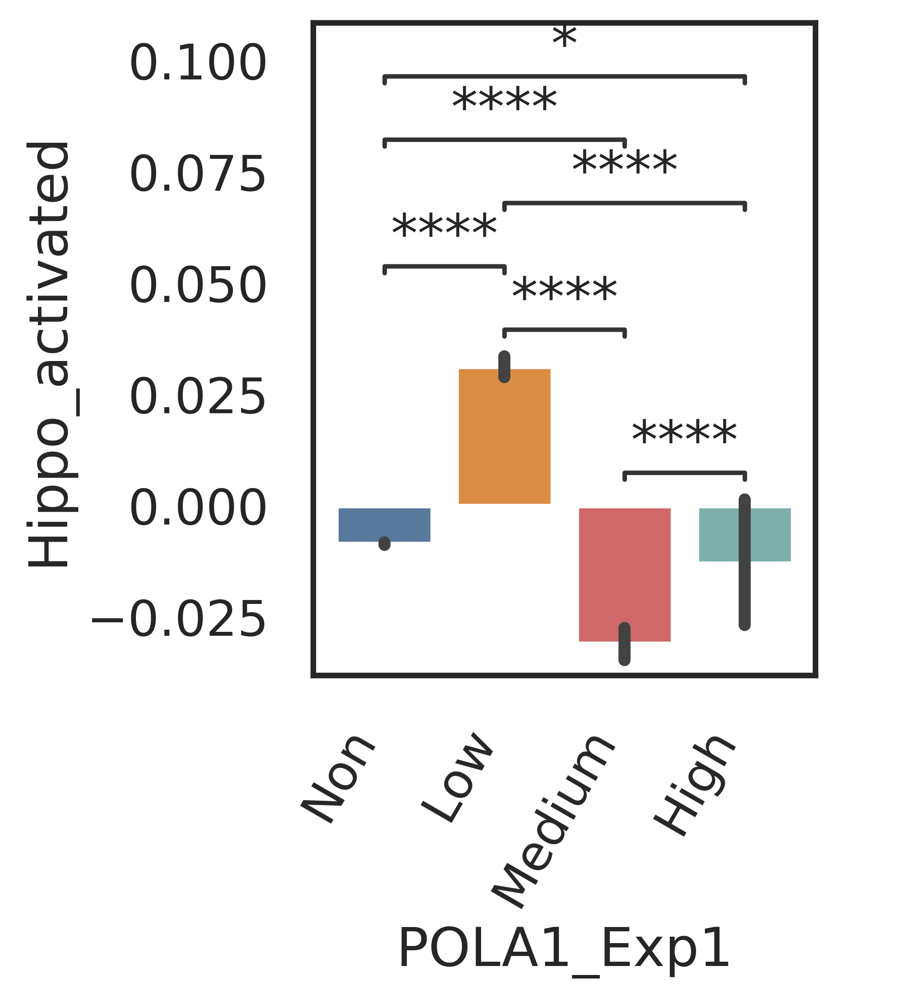

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.173e-48 U_stat=3.052e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:4.157e-45 U_stat=7.734e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:4.661e-01 U_stat=4.597e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.419e-03 U_stat=1.039e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.039e-03 U_stat=1.694e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.310e-01 U_stat=2.276e+08


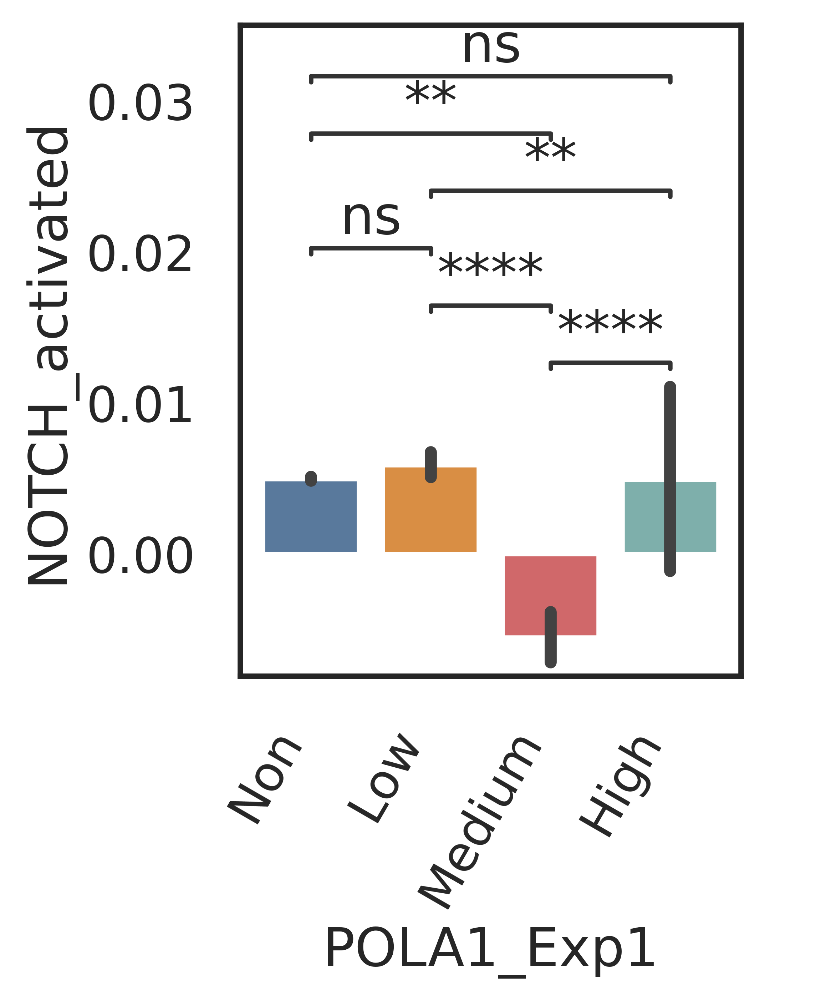

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.179e-01 U_stat=3.420e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:7.423e-01 U_stat=6.961e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:5.937e-06 U_stat=4.111e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.170e-03 U_stat=1.041e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:9.739e-04 U_stat=1.410e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.759e-04 U_stat=2.065e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


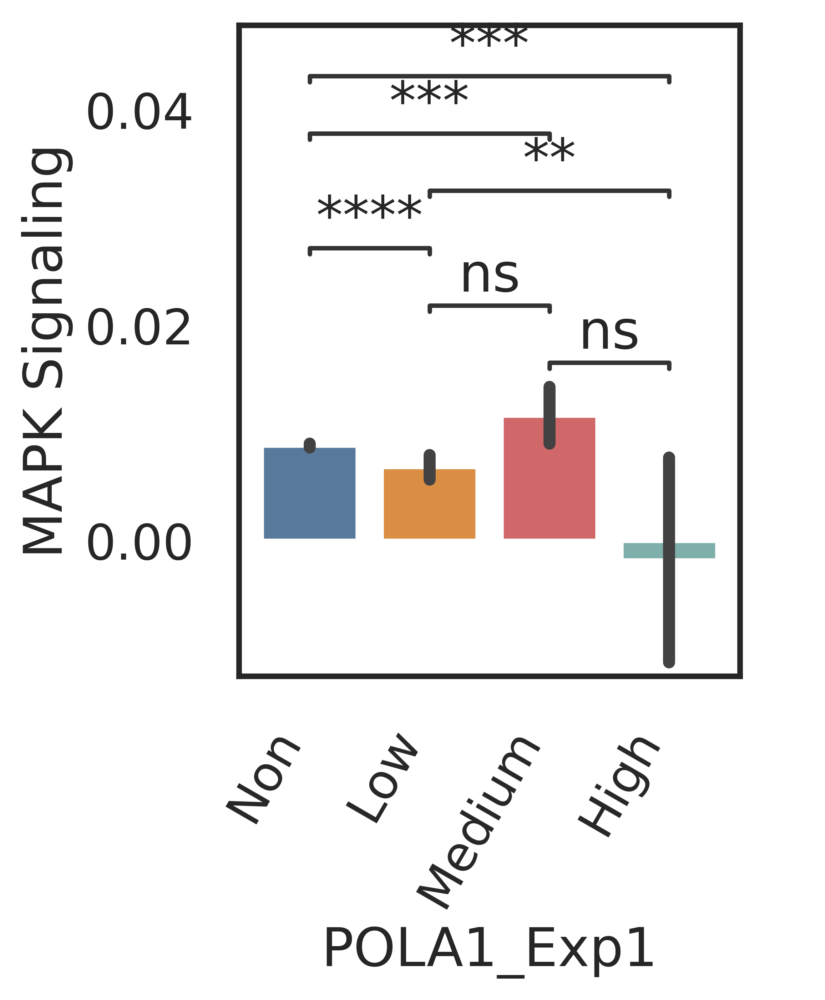

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.313e-171 U_stat=4.067e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.199e-61 U_stat=7.873e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:5.406e-13 U_stat=3.767e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.358e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:4.049e-02 U_stat=1.464e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.284e-08 U_stat=2.635e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


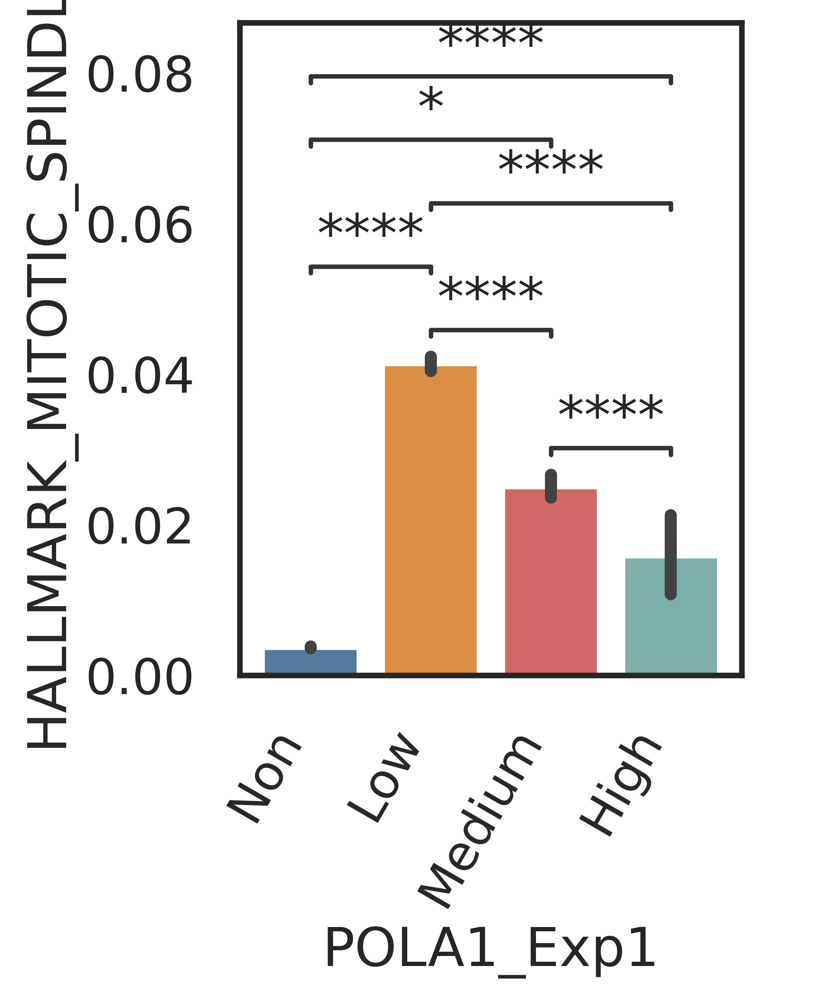

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.749e-73 U_stat=2.967e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.563e-249 U_stat=8.837e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.418e-11 U_stat=3.836e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.090e-282 U_stat=1.178e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.878e-03 U_stat=1.687e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.438e-01 U_stat=2.207e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


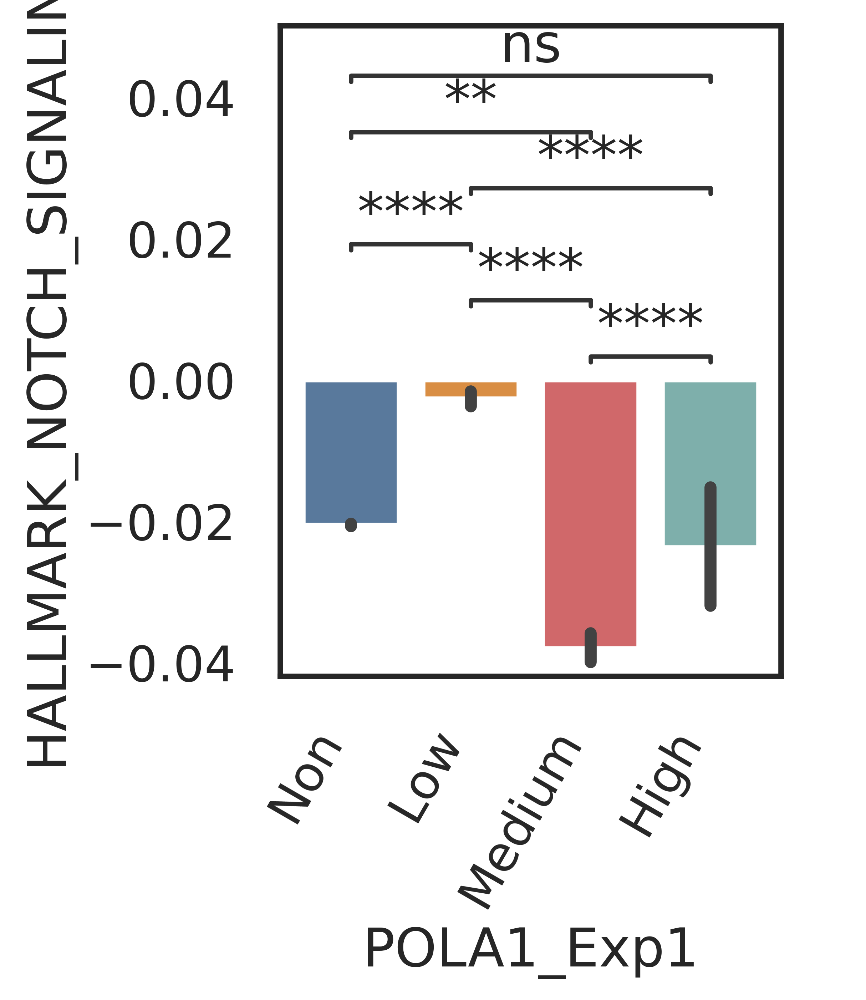

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.983e-66 U_stat=3.811e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.821e-12 U_stat=7.339e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.868e-89 U_stat=2.127e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.229e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.750e-58 U_stat=8.547e+05
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.062e-41 U_stat=1.466e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


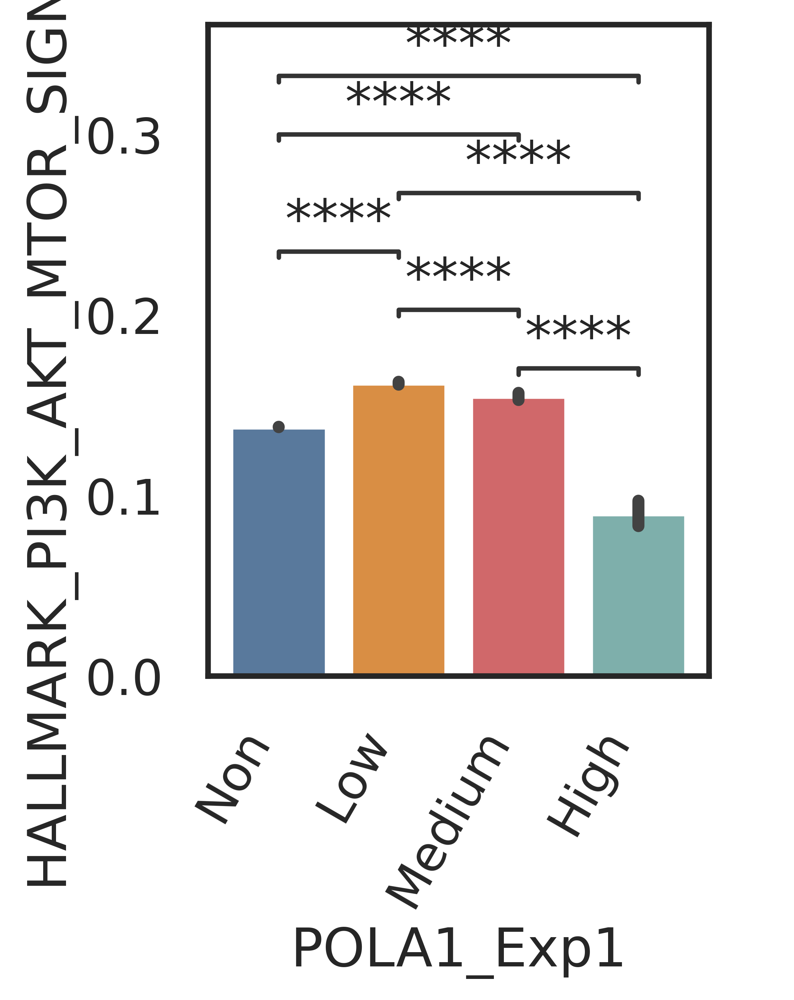

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.409e-01 U_stat=3.423e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=9.993e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.352e-192 U_stat=9.028e+05
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.477e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:4.136e-76 U_stat=7.534e+05
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.661e-77 U_stat=1.142e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


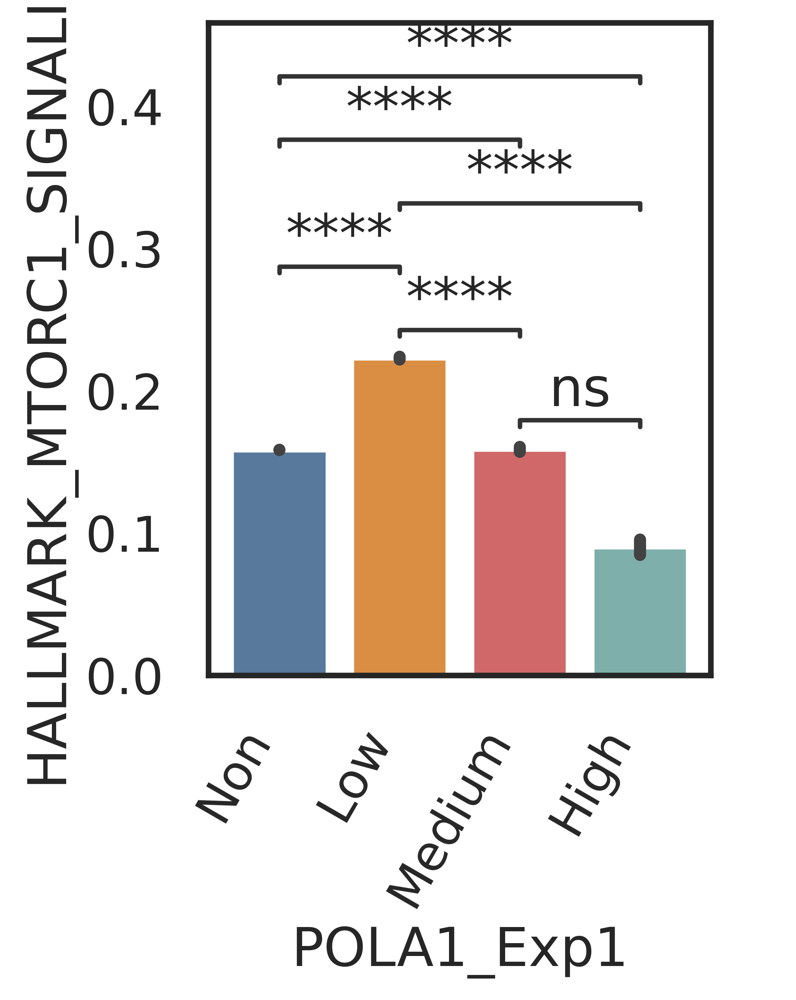

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.852e-215 U_stat=4.149e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.305e-117 U_stat=8.236e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.152e-41 U_stat=2.960e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.434e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.616e-11 U_stat=1.266e+06


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.135e-01 U_stat=2.396e+08


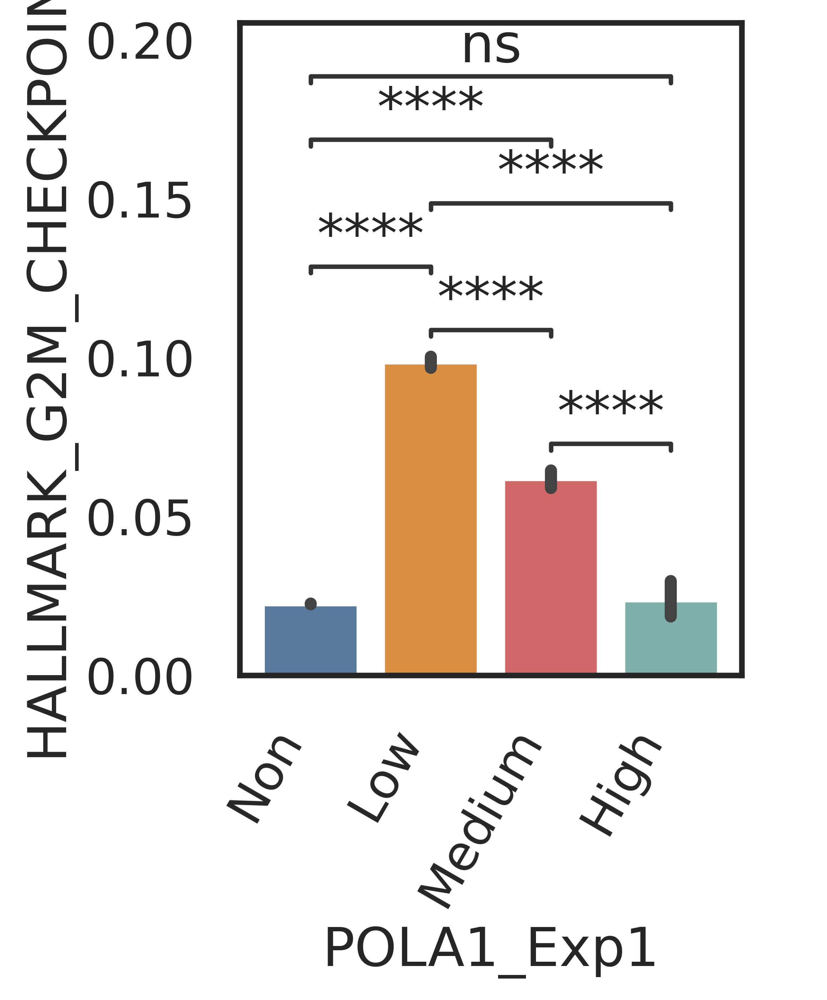

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.081e-154 U_stat=4.033e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:7.463e-92 U_stat=8.084e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:9.981e-35 U_stat=3.118e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.378e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.470e-10 U_stat=1.275e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:8.840e-01 U_stat=2.306e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


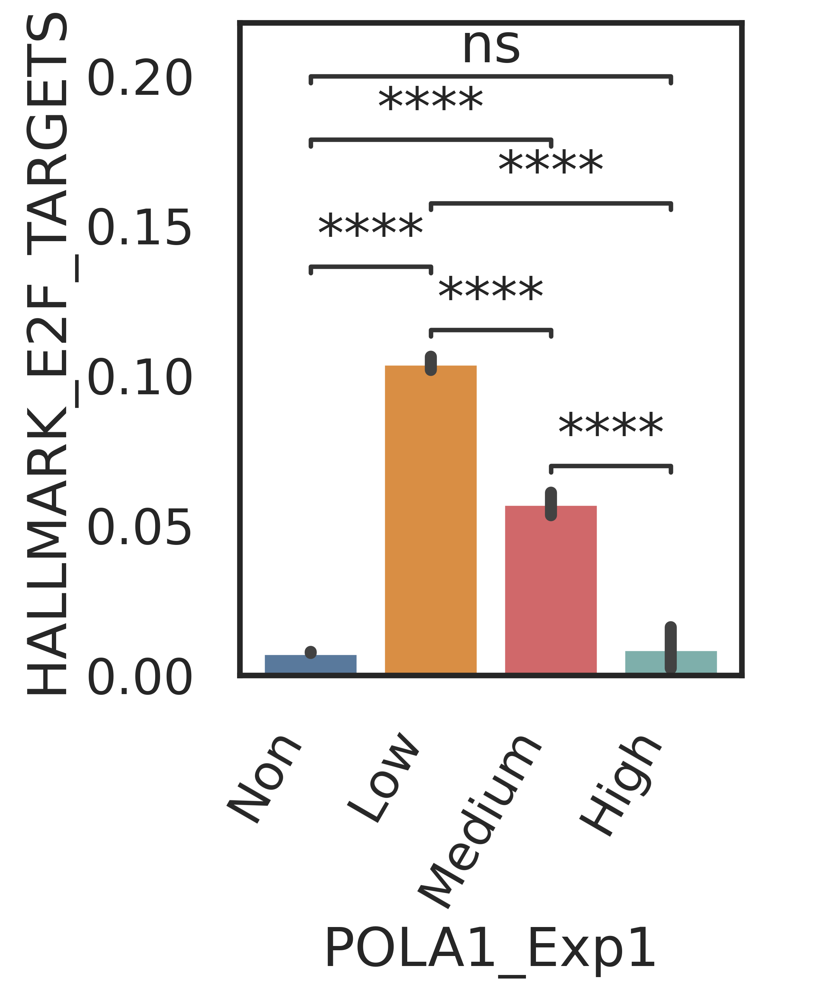

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.675e-135 U_stat=3.992e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.677e-11 U_stat=7.317e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:5.160e-09 U_stat=3.943e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.270e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.220e-04 U_stat=1.397e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:6.443e-03 U_stat=2.466e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


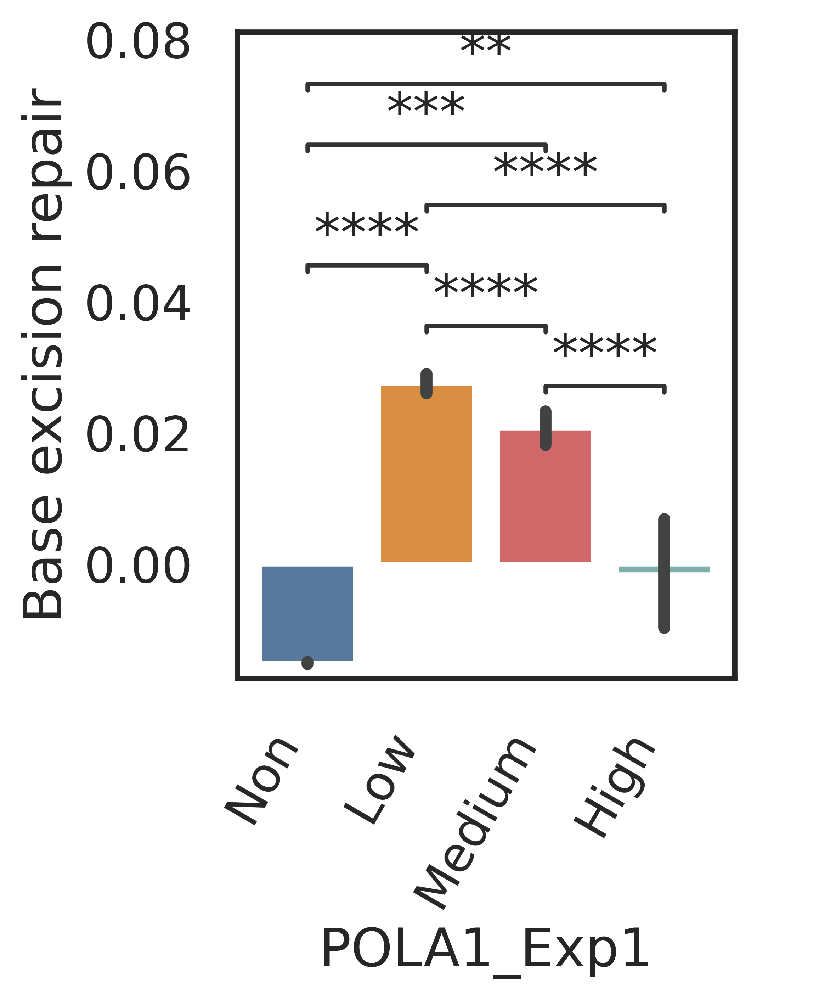

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.081e-72 U_stat=3.830e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.395e-61 U_stat=7.871e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:5.127e-28 U_stat=3.287e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.312e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.700e-08 U_stat=1.314e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.785e-01 U_stat=2.214e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


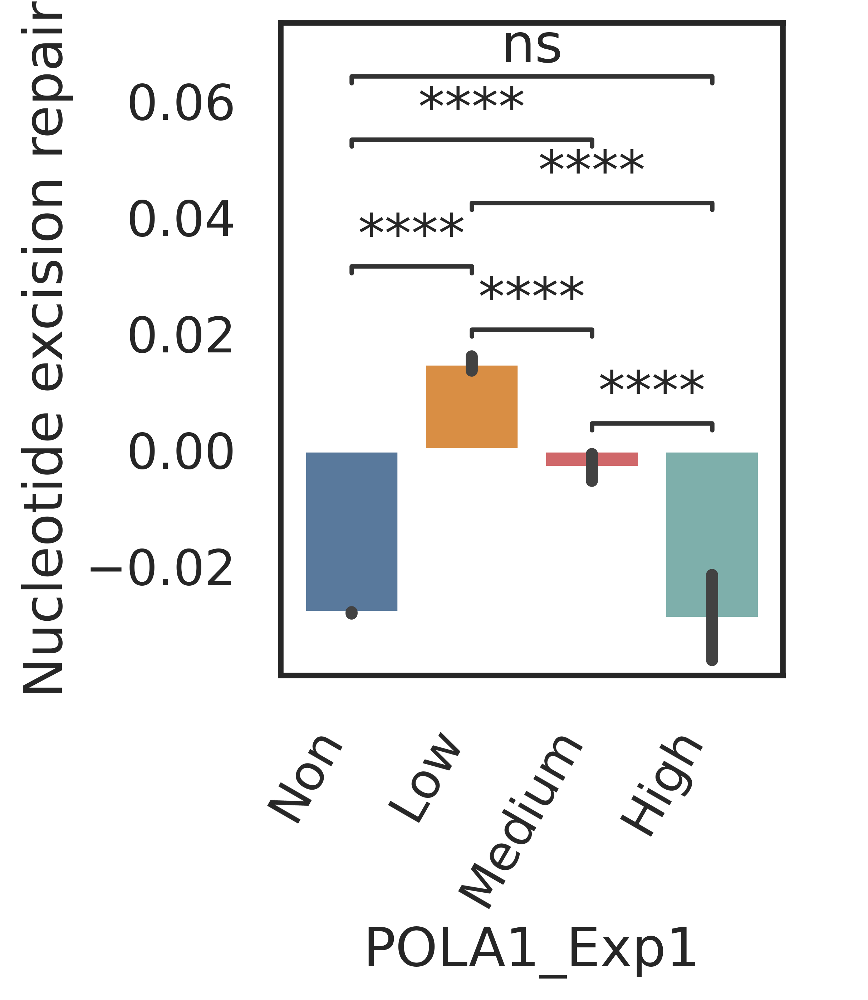

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.800e-72 U_stat=3.831e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.430e-03 U_stat=7.122e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.473e-01 U_stat=4.505e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.192e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:8.281e-01 U_stat=1.543e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.600e-06 U_stat=2.589e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


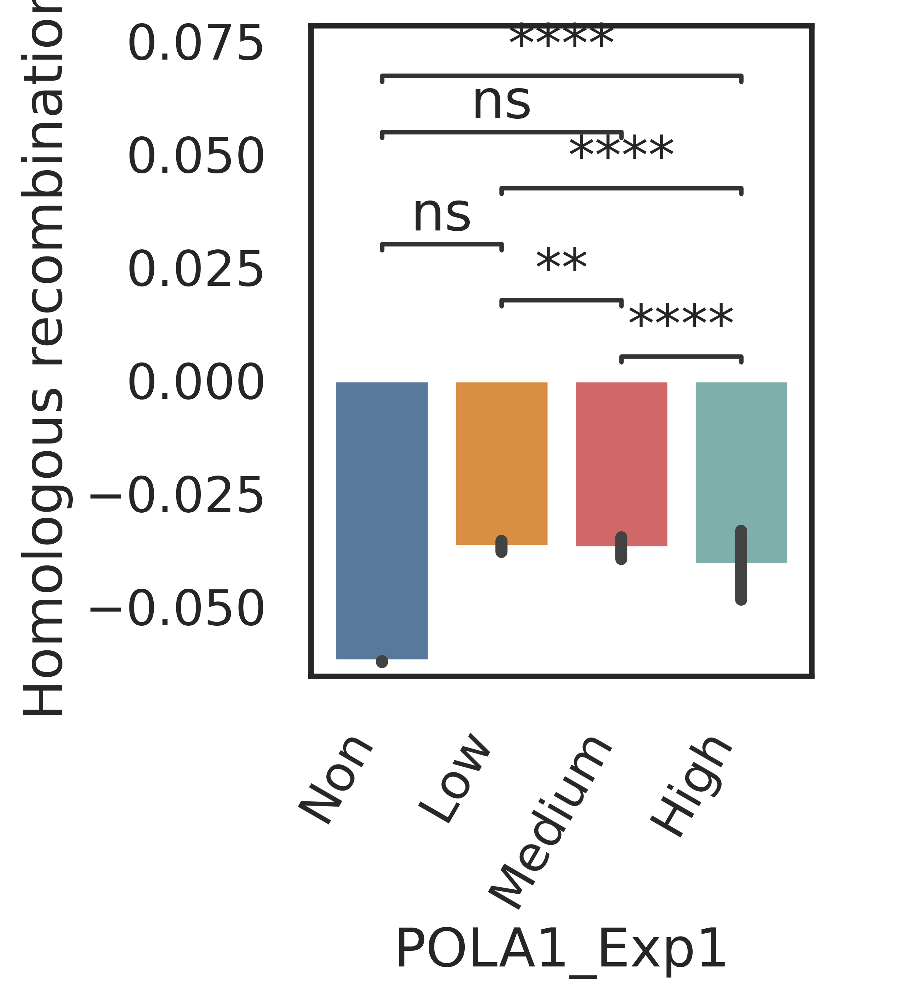

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.544e-118 U_stat=3.954e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.178e-05 U_stat=7.176e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:4.562e-02 U_stat=4.435e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.229e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:5.913e-01 U_stat=1.529e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.761e-09 U_stat=2.671e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


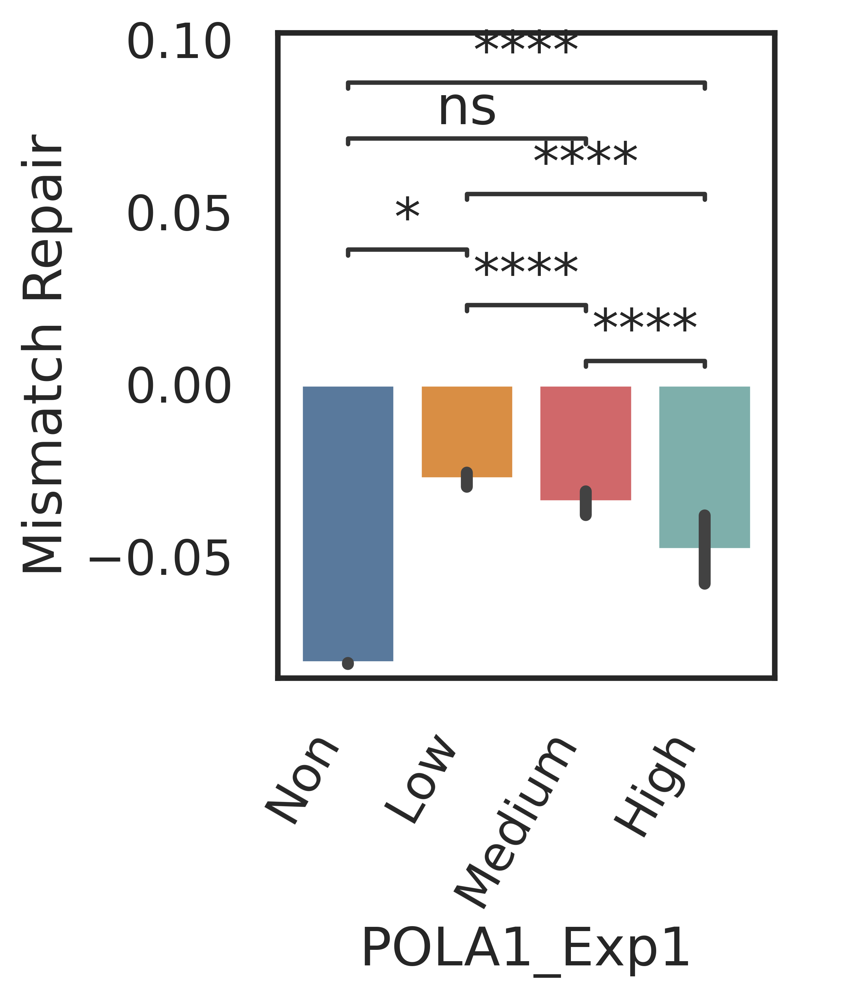

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.717e-41 U_stat=3.078e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.946e-236 U_stat=8.786e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:5.547e-83 U_stat=2.221e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.207e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:5.569e-30 U_stat=1.060e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.402e-49 U_stat=1.387e+08


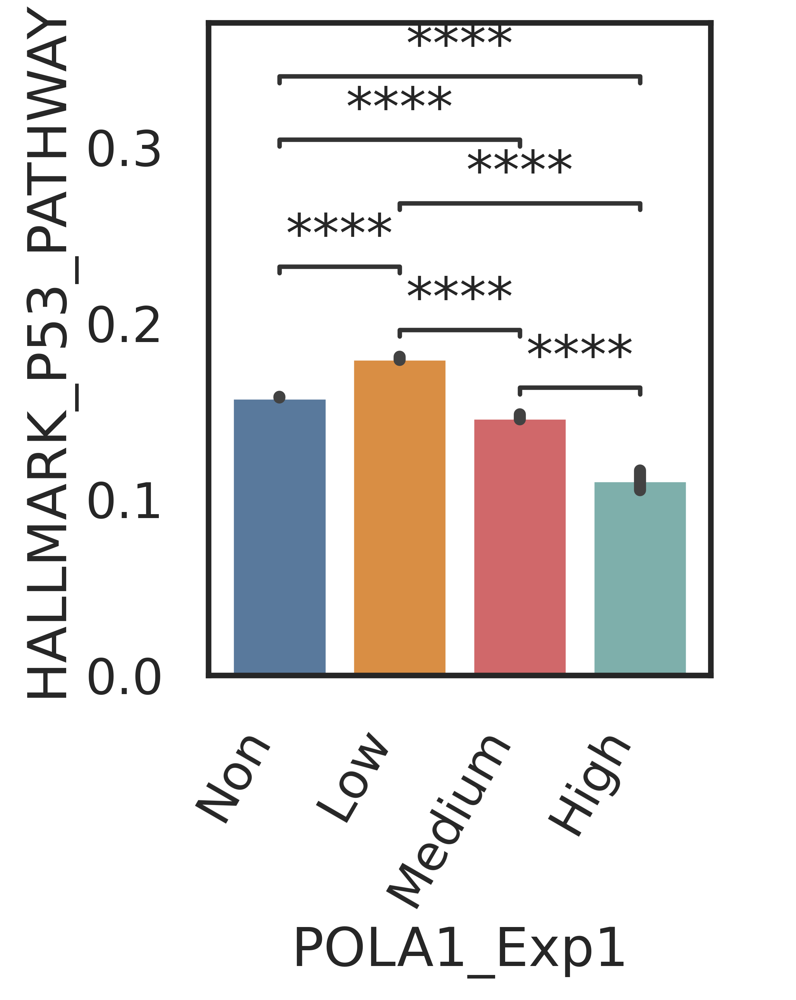

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:6.674e-73 U_stat=2.968e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=9.622e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.288e-30 U_stat=3.225e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.315e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.691e-05 U_stat=1.734e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.638e-01 U_stat=2.262e+08


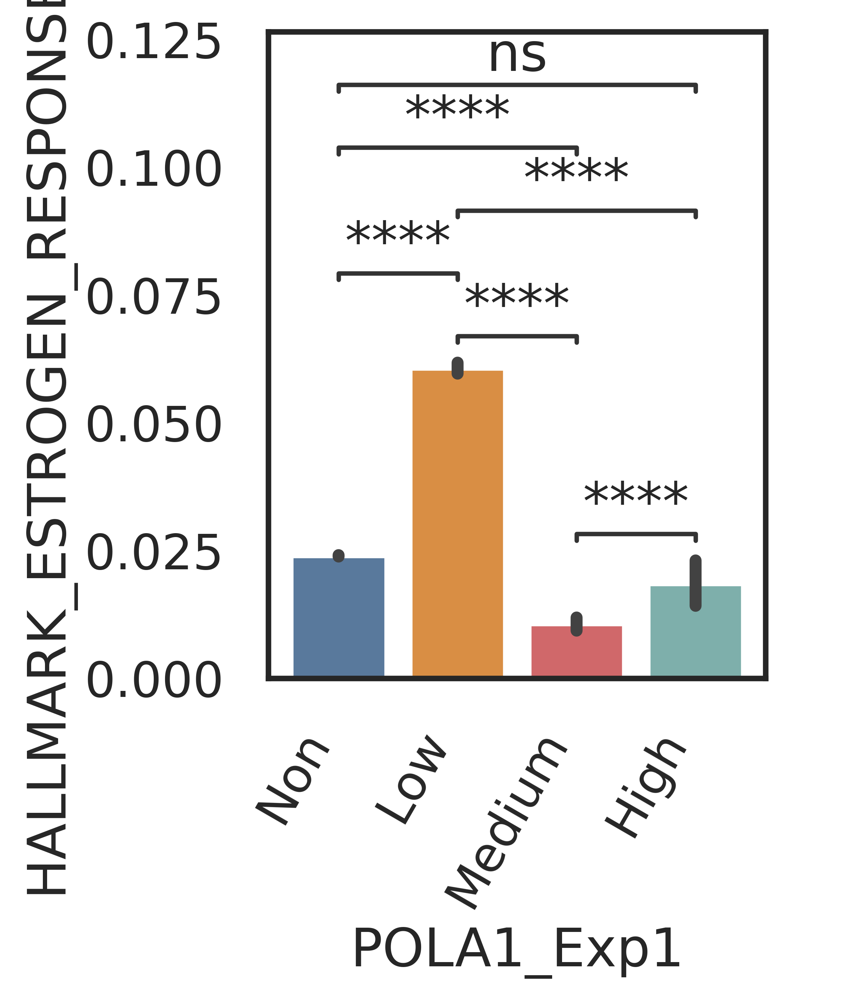

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:9.268e-92 U_stat=2.914e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=9.071e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.036e-05 U_stat=4.145e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.234e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:6.877e-25 U_stat=1.998e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.111e-07 U_stat=2.626e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


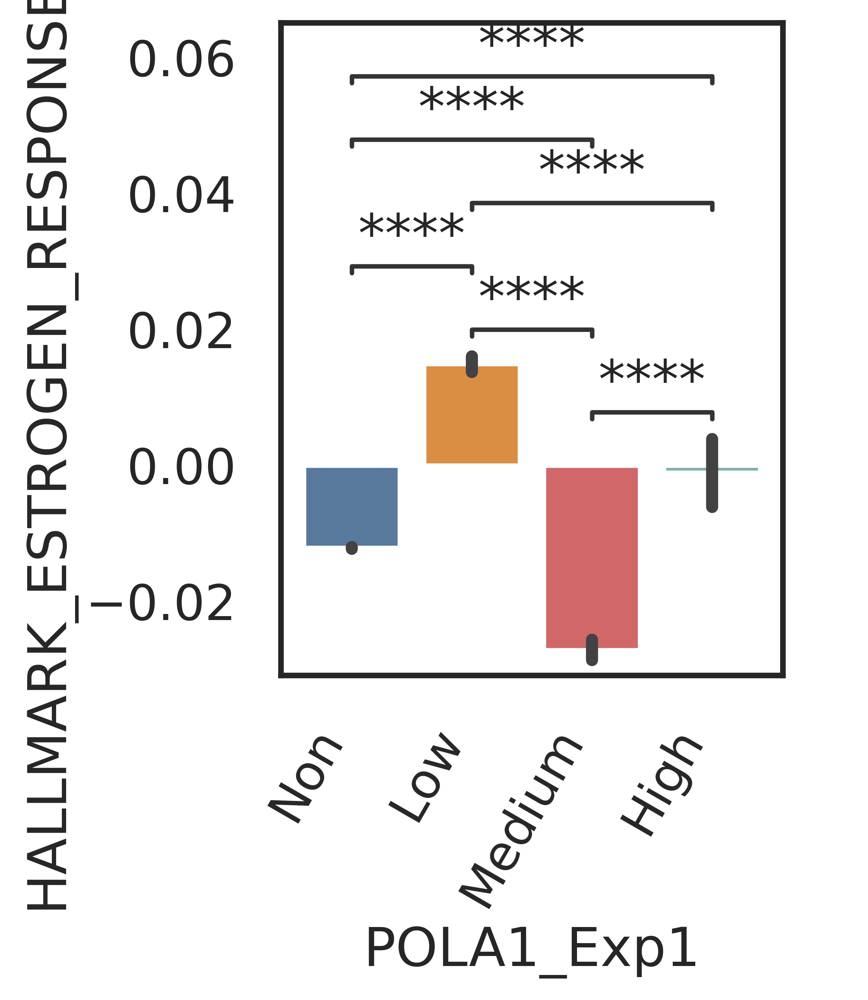

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.602e-58 U_stat=3.016e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.007e+08
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.553e-81 U_stat=2.243e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.381e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:5.093e-03 U_stat=1.431e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.031e-12 U_stat=1.861e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


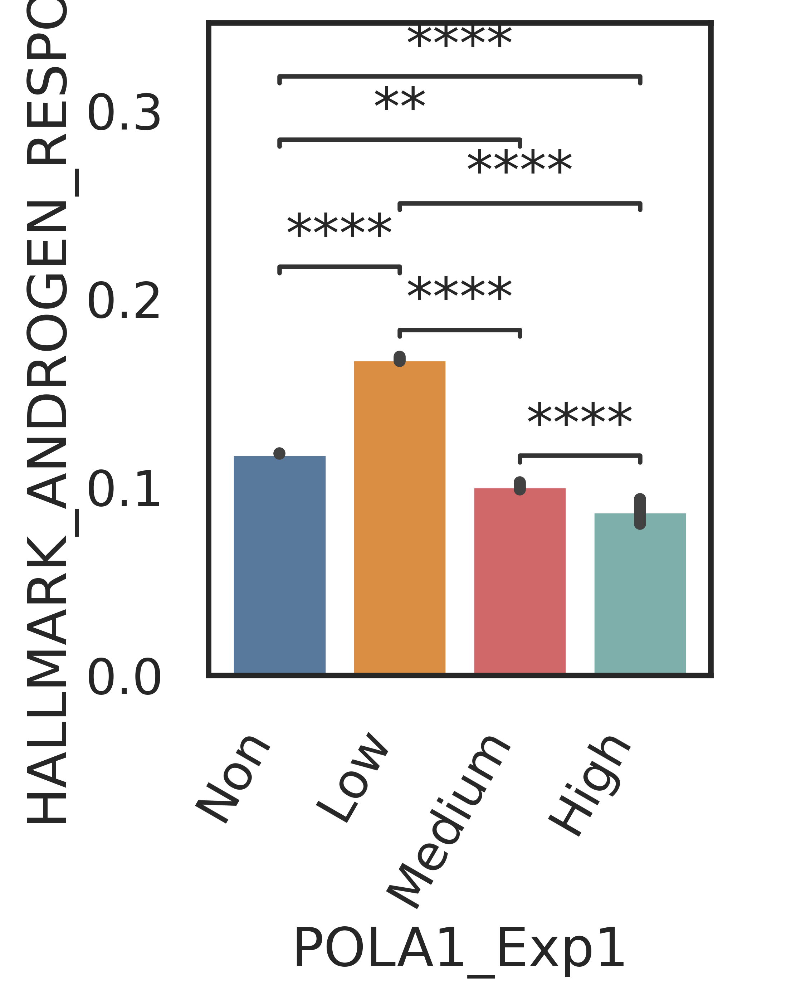

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.999e-77 U_stat=2.955e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:7.567e-01 U_stat=6.960e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.618e-07 U_stat=5.361e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.321e-60 U_stat=9.587e+09
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.829e-49 U_stat=2.190e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:6.061e-17 U_stat=2.816e+08


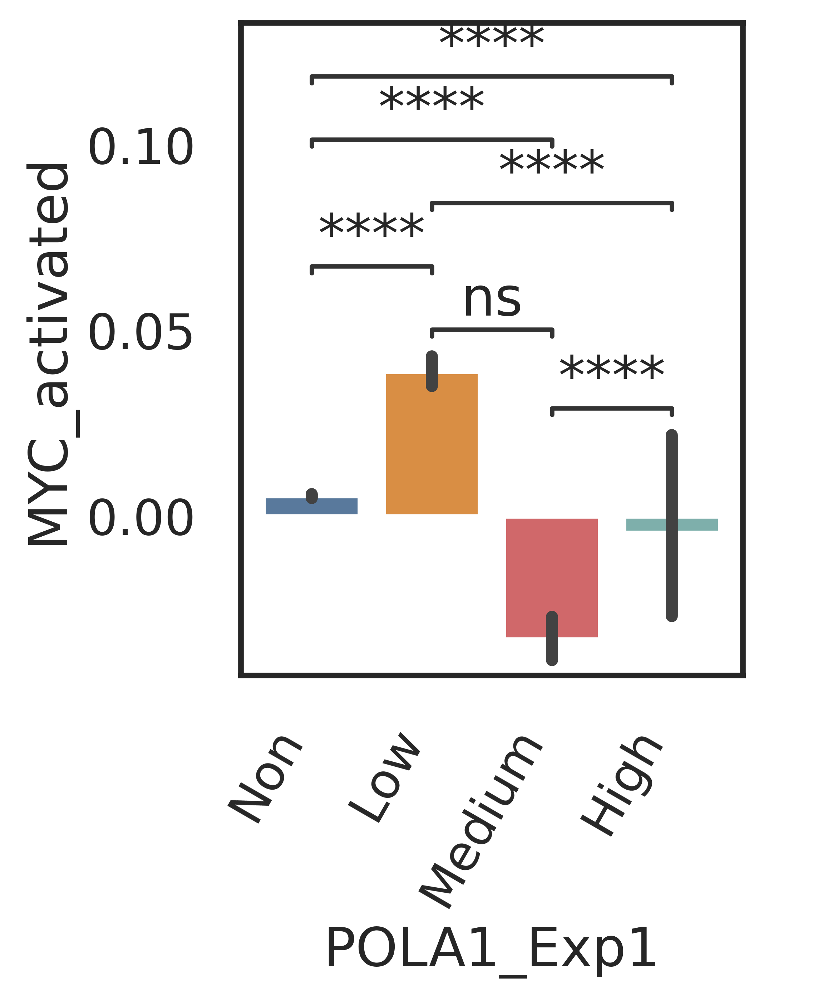

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.234e-22 U_stat=3.169e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.003e-54 U_stat=7.814e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.704e-01 U_stat=4.866e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.404e-50 U_stat=1.090e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.169e-08 U_stat=1.799e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.923e-04 U_stat=2.517e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


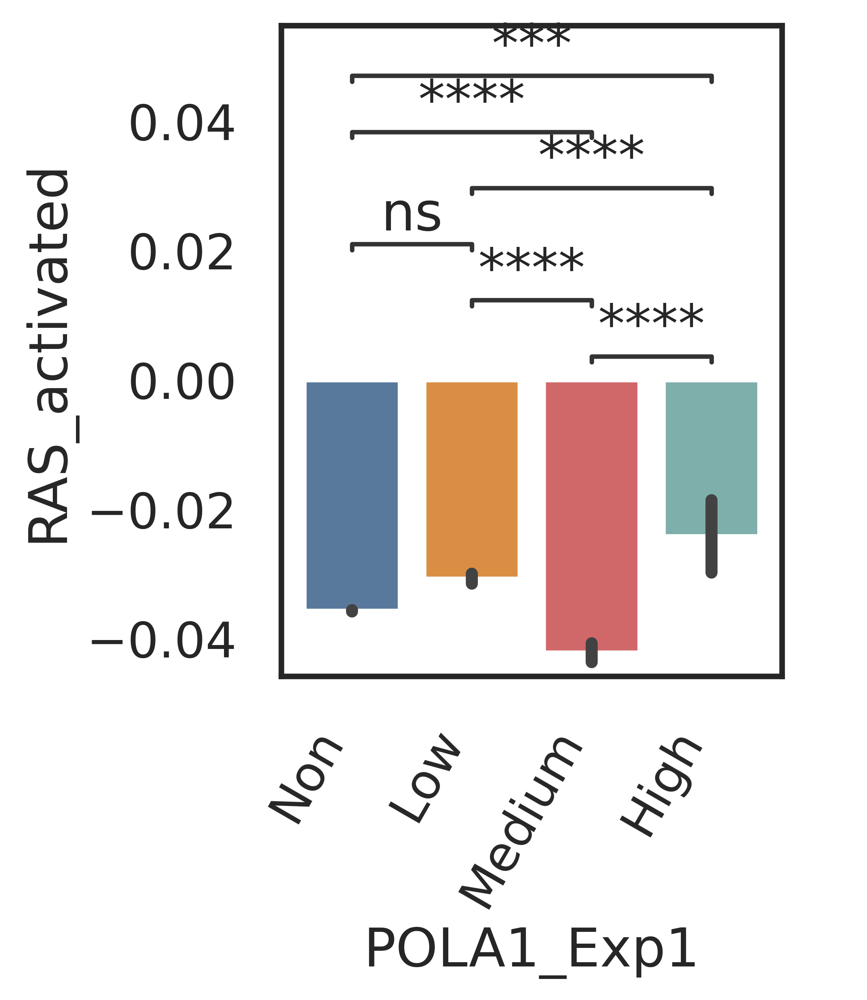

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.609e-03 U_stat=3.328e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.225e-30 U_stat=6.301e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:1.165e-04 U_stat=5.184e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.864e-170 U_stat=9.110e+09
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:5.964e-01 U_stat=1.575e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.767e-01 U_stat=2.280e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


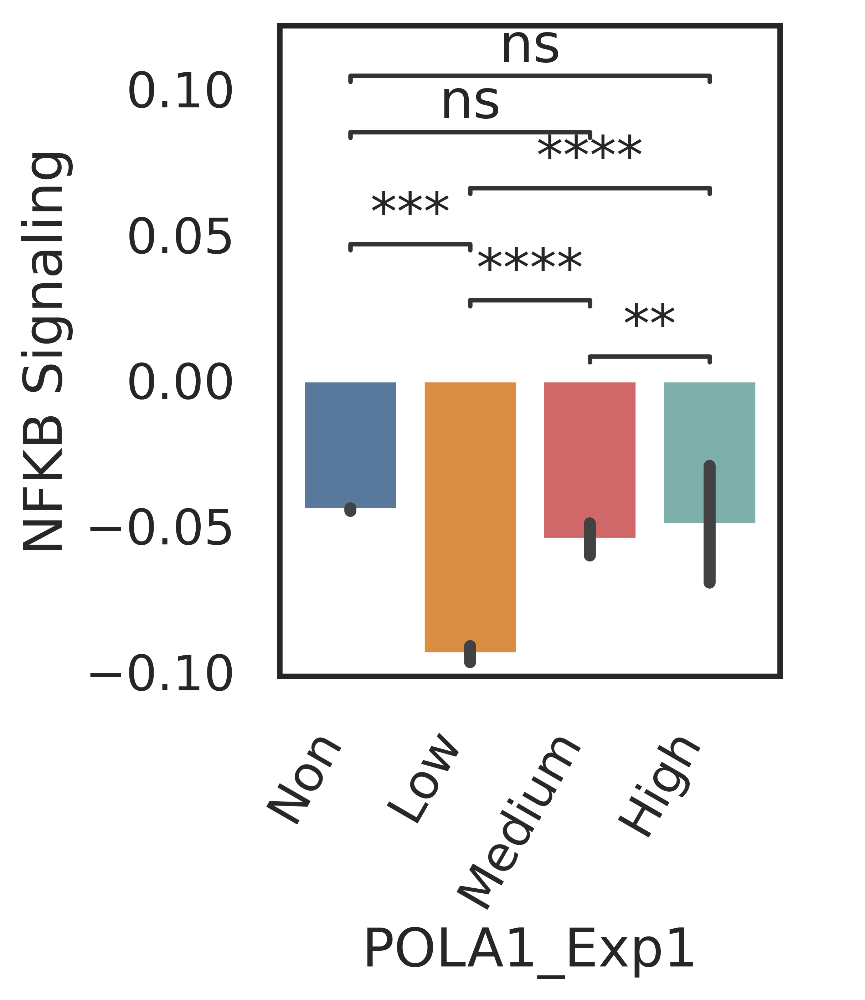

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:5.279e-03 U_stat=3.334e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:6.837e-07 U_stat=7.222e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:9.817e-01 U_stat=4.688e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.497e-34 U_stat=1.079e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.282e-06 U_stat=1.762e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.421e-05 U_stat=2.543e+08


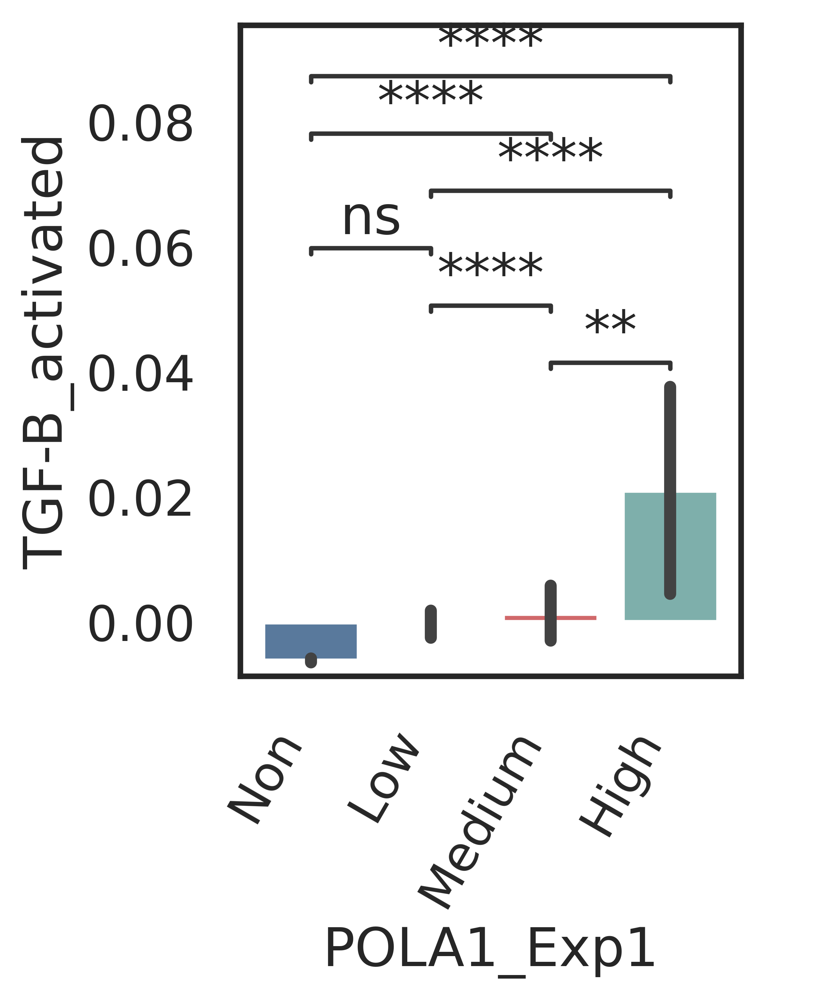

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:4.853e-13 U_stat=3.228e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.911e-79 U_stat=8.003e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.687e-20 U_stat=3.510e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.135e-142 U_stat=1.134e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.350e-04 U_stat=1.387e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:9.498e-09 U_stat=1.942e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


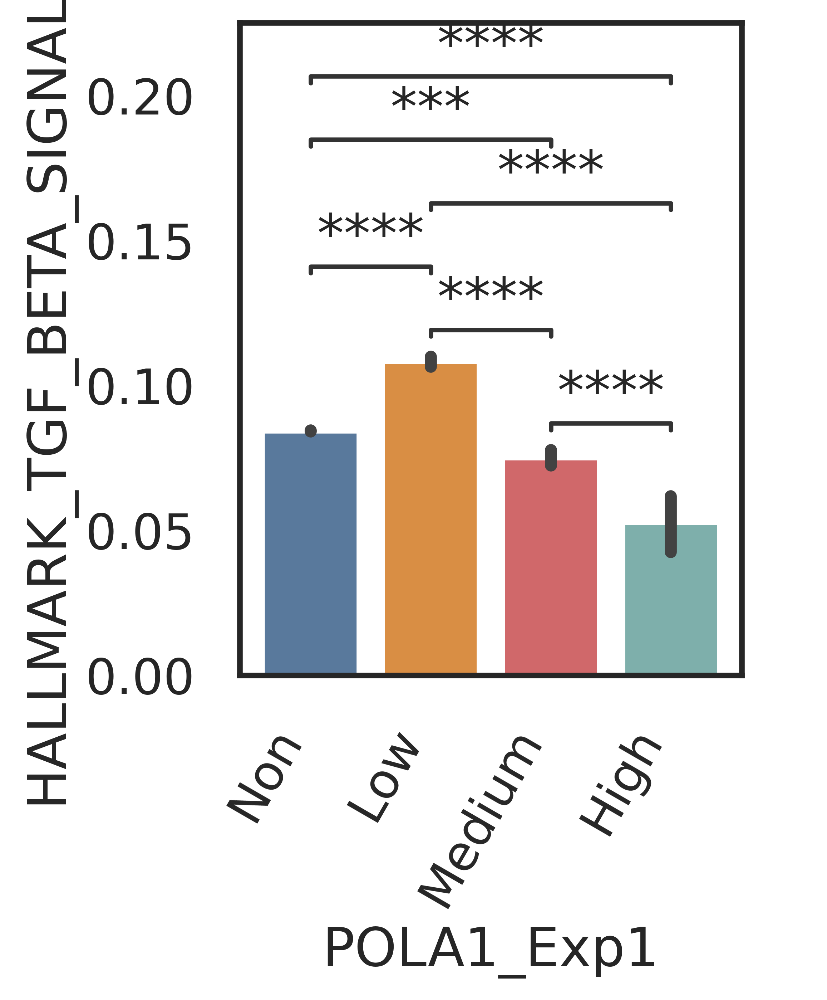

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.380e-25 U_stat=3.152e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.122e-07 U_stat=6.645e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.606e-01 U_stat=4.547e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.940e-155 U_stat=9.165e+09
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.856e-03 U_stat=1.423e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.089e-08 U_stat=1.943e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


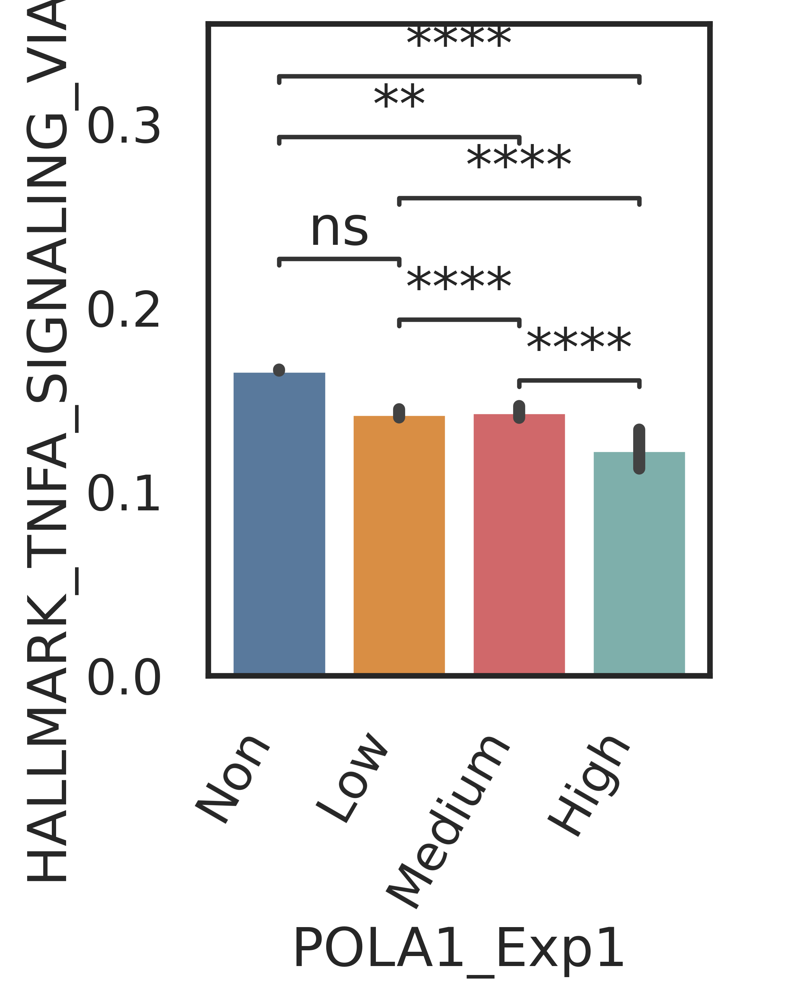

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.689e-05 U_stat=3.302e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:3.603e-159 U_stat=5.433e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.598e-23 U_stat=5.963e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=7.871e+09
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:1.304e-02 U_stat=1.660e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:1.584e-01 U_stat=2.385e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


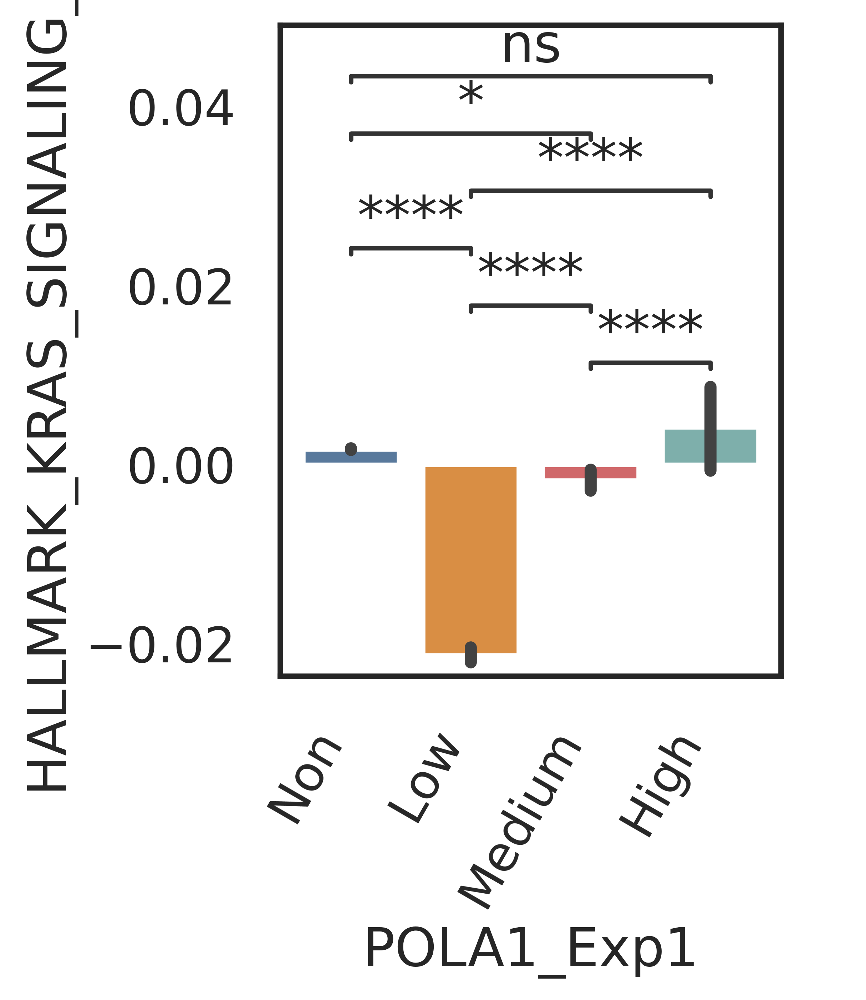

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
No artists with labels found to put in legend.  Note

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:2.385e-38 U_stat=3.091e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:4.747e-48 U_stat=7.761e+07
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:7.943e-33 U_stat=3.164e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.430e-11 U_stat=1.055e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:2.400e-16 U_stat=1.198e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:7.759e-30 U_stat=1.594e+08


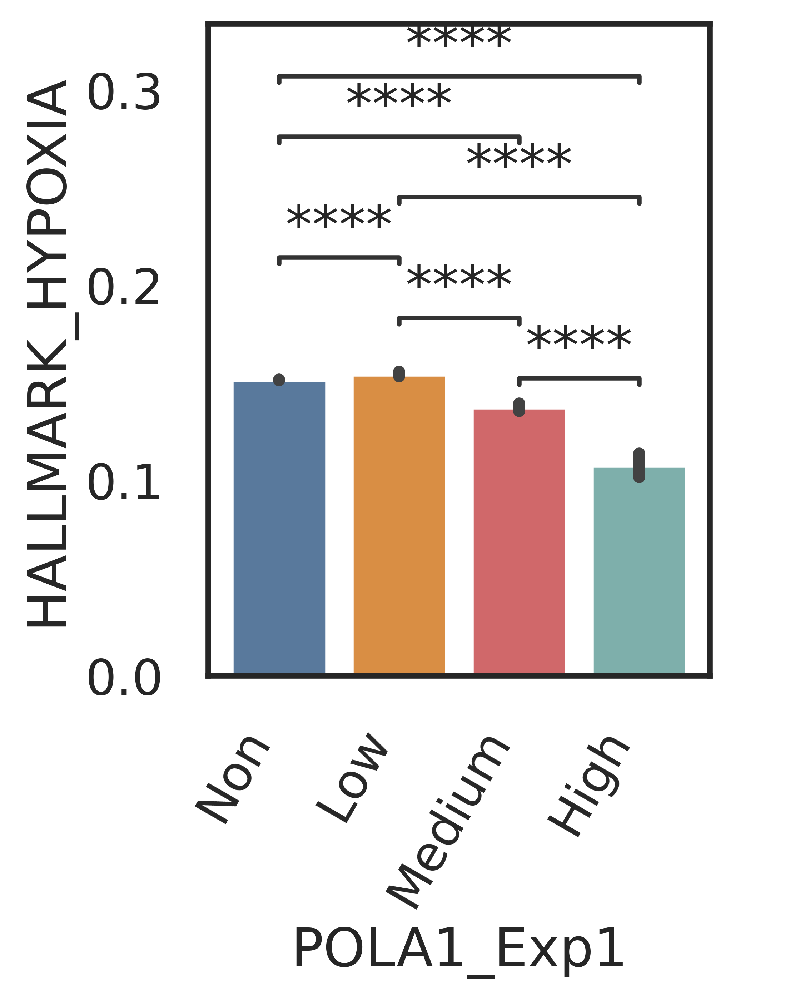

/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/home/chenx6/anaconda3/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Medium vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:3.028e-35 U_stat=3.104e+09
Low vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.025e+08
High vs. Low: Mann-Whitney-Wilcoxon test two-sided, P_val:2.174e-113 U_stat=1.795e+06
Low vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=1.422e+10
High vs. Medium: Mann-Whitney-Wilcoxon test two-sided, P_val:4.387e-12 U_stat=1.253e+06
High vs. Non: Mann-Whitney-Wilcoxon test two-sided, P_val:9.372e-24 U_stat=1.675e+08


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


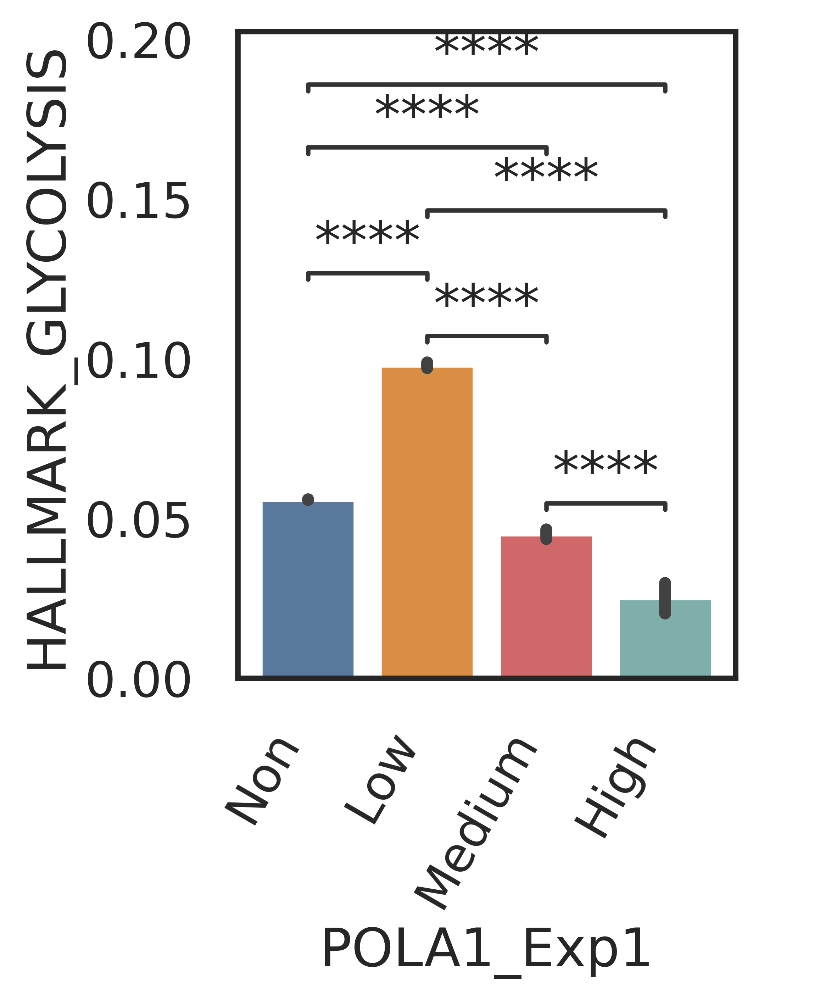

In [122]:
import seaborn as sns
import matplotlib.pyplot as plt
from statannotations.Annotator import Annotator

# Define scores and get the observation data
ne = adata.obs
custom_palette = {
    'Non': '#4E79A7',  # A soft, professional blue
    'Low': '#F28E2B',  # A warm orange
    'Medium': '#E15759',  # A muted red
    'High': '#76B7B2'   # A calm, nature-inspired teal
}
sns.set_style("white")
sns.set_context("talk") 
# Loop through each score
for score in Pathways:
    # Define plotting parameters
    x = "POLA1_Exp1"
    y = score
    pairs = [
    ("Non", "Low"),
    ("Non", "Medium"),
    ("Non", "High"),
    ("Low", "Medium"),
    ("Medium", "High"),
    ("Low", "High")
    
]
    order=["Non", "Low", "Medium", "High"]

    # Create figure and axis
    fig, ax = plt.subplots(figsize=(3,4), dpi=300)
    
    # Plot the data
    sns.barplot(data=ne, x=x, y=y, ax=ax,order=order, palette=custom_palette)
    
    # Annotate the bars using Annotator
    annot = Annotator(ax, pairs=pairs, data=ne, x=x, y=y)
    annot.new_plot(ax, pairs=pairs, data=ne, x=x, y=y)
    annot.configure(test='Mann-Whitney', verbose=1, loc='inside')
    annot.apply_test()
    annot.annotate()
    
    # Adjust plot aesthetics
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    ax.set_xticklabels(ax.get_xticklabels(), rotation=60, ha='right') 
    
    # Save the figure and close it to free up memory
    #plt.savefig(f'{score}_HRD_Type_bar_Fibroblast.pdf', dpi=300, bbox_inches='tight')
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from scipy import stats

data = adata.obs
for celltype in data["Celltype2"].unique():
    subdata = data[data["Celltype2"] == celltype].copy()

    # Convert data from wide format to long format
    melted_data = subdata.melt(id_vars='POLA1_Exp1', value_vars=Pathway_list, var_name='Signature', value_name='Score')

    # Custom colors (if applicable)
     
    # Set figure size and style
    plt.figure(figsize=(25, 3.5))
    sns.set_style("whitegrid")

    # Plot bar chart
    sns.barplot(data=melted_data,
                x='Signature', y='Score', hue='POLA1_Exp1', palette=custom_palette)
    plt.title(f'Signature Scores by POLA1_Exp Level ({celltype})')
    plt.xlabel('Signature')
    plt.ylabel('Score')

    # Move legend to appropriate position
    plt.legend(title='POLA1_Exp', loc='upper right')

    # Set tick font size for axes
    # plt.xticks(fontsize=8)
    # plt.yticks(fontsize=8)

    # Adjust title font size
    plt.title(f'Signature Scores by POLA1 Level ({celltype})', fontsize=20)

    # Adjust axis label font size
    plt.xlabel('Signature', fontsize=20)
    plt.ylabel('Score', fontsize=20)
    plt.xticks(rotation=90)

    # Adjust legend font size
    plt.legend(title='POLA1_Exp', loc='upper right', fontsize=8)

    # Save figure as a PDF file, using celltype as part of the filename
    # filename = f'Chromosome_Scores_by_LOY_Level_{celltype}.pdf'
    # plt.savefig(filename, format="pdf", bbox_inches="tight")

    plt.tight_layout()
    plt.show()


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


/tmp/ipykernel_131427/697676394.py:49: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
